# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:20, 9.04MB/s]                              
SVHN Testing Set: 64.3MB [00:05, 11.6MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

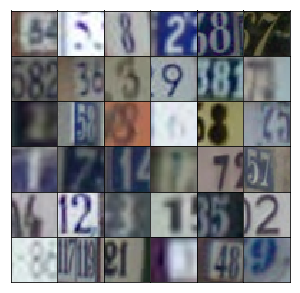

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.8821... Generator Loss: 1.7395
Epoch 1/25... Discriminator Loss: 0.7610... Generator Loss: 0.9807
Epoch 1/25... Discriminator Loss: 0.1869... Generator Loss: 2.3884
Epoch 1/25... Discriminator Loss: 0.1415... Generator Loss: 2.5978
Epoch 1/25... Discriminator Loss: 0.1674... Generator Loss: 3.0454
Epoch 1/25... Discriminator Loss: 0.0810... Generator Loss: 3.1514
Epoch 1/25... Discriminator Loss: 0.1077... Generator Loss: 3.2668
Epoch 1/25... Discriminator Loss: 0.1208... Generator Loss: 2.9773
Epoch 1/25... Discriminator Loss: 0.1050... Generator Loss: 3.2704
Epoch 1/25... Discriminator Loss: 0.1559... Generator Loss: 2.8348


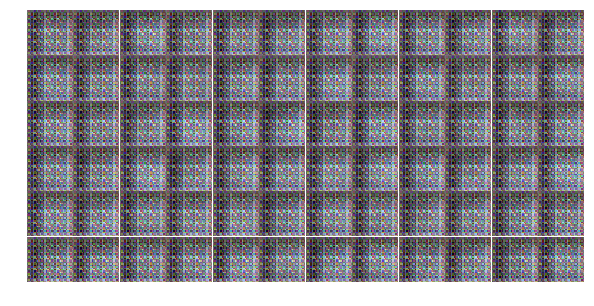

Epoch 1/25... Discriminator Loss: 0.1682... Generator Loss: 3.1523
Epoch 1/25... Discriminator Loss: 1.2764... Generator Loss: 1.7899
Epoch 1/25... Discriminator Loss: 0.8824... Generator Loss: 2.8611
Epoch 1/25... Discriminator Loss: 0.5443... Generator Loss: 1.9742
Epoch 1/25... Discriminator Loss: 0.4536... Generator Loss: 1.4934
Epoch 1/25... Discriminator Loss: 0.4874... Generator Loss: 2.2727
Epoch 1/25... Discriminator Loss: 0.3838... Generator Loss: 2.2355
Epoch 1/25... Discriminator Loss: 0.4126... Generator Loss: 3.5688
Epoch 1/25... Discriminator Loss: 0.8967... Generator Loss: 0.7167
Epoch 1/25... Discriminator Loss: 0.6588... Generator Loss: 1.3272


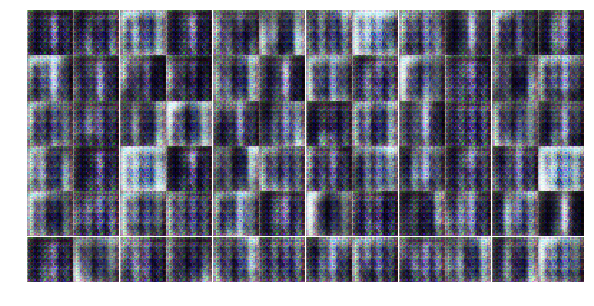

Epoch 1/25... Discriminator Loss: 0.3390... Generator Loss: 1.8668
Epoch 1/25... Discriminator Loss: 0.4429... Generator Loss: 2.3450
Epoch 1/25... Discriminator Loss: 0.7998... Generator Loss: 1.9744
Epoch 1/25... Discriminator Loss: 0.5700... Generator Loss: 1.6252
Epoch 1/25... Discriminator Loss: 1.6779... Generator Loss: 0.2969
Epoch 1/25... Discriminator Loss: 0.4648... Generator Loss: 2.1730
Epoch 1/25... Discriminator Loss: 0.3982... Generator Loss: 1.7734
Epoch 1/25... Discriminator Loss: 0.2025... Generator Loss: 2.6656
Epoch 1/25... Discriminator Loss: 1.0020... Generator Loss: 3.7876
Epoch 1/25... Discriminator Loss: 0.7714... Generator Loss: 1.7592


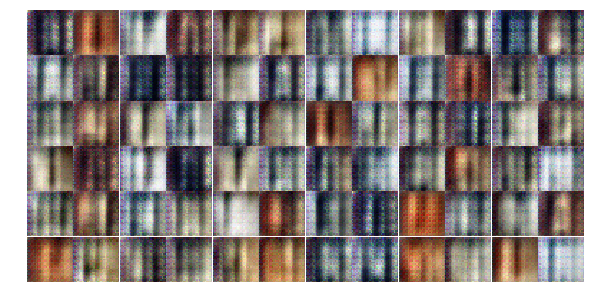

Epoch 1/25... Discriminator Loss: 0.6145... Generator Loss: 2.3746
Epoch 1/25... Discriminator Loss: 0.1615... Generator Loss: 3.1067
Epoch 1/25... Discriminator Loss: 0.3377... Generator Loss: 1.9431
Epoch 1/25... Discriminator Loss: 0.9917... Generator Loss: 0.8266
Epoch 1/25... Discriminator Loss: 0.7874... Generator Loss: 1.3991
Epoch 1/25... Discriminator Loss: 0.5391... Generator Loss: 2.3298
Epoch 1/25... Discriminator Loss: 0.8265... Generator Loss: 0.9100
Epoch 1/25... Discriminator Loss: 0.9891... Generator Loss: 1.7977
Epoch 1/25... Discriminator Loss: 0.8009... Generator Loss: 2.0632
Epoch 1/25... Discriminator Loss: 0.8046... Generator Loss: 1.6322


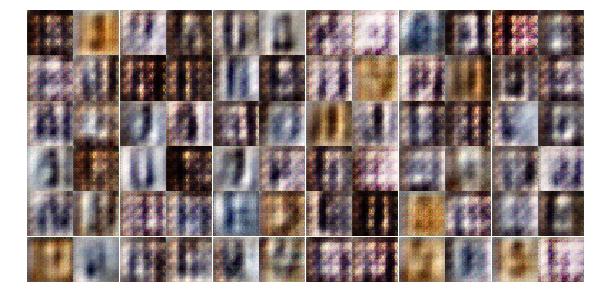

Epoch 1/25... Discriminator Loss: 0.9234... Generator Loss: 1.1464
Epoch 1/25... Discriminator Loss: 0.6700... Generator Loss: 1.2013
Epoch 1/25... Discriminator Loss: 0.7127... Generator Loss: 1.4798
Epoch 1/25... Discriminator Loss: 0.5708... Generator Loss: 1.7680
Epoch 1/25... Discriminator Loss: 0.7848... Generator Loss: 1.8161
Epoch 1/25... Discriminator Loss: 0.7894... Generator Loss: 0.9958
Epoch 1/25... Discriminator Loss: 0.5318... Generator Loss: 1.4789
Epoch 1/25... Discriminator Loss: 0.5701... Generator Loss: 1.5721
Epoch 1/25... Discriminator Loss: 1.0766... Generator Loss: 0.7681
Epoch 1/25... Discriminator Loss: 0.7653... Generator Loss: 1.2760


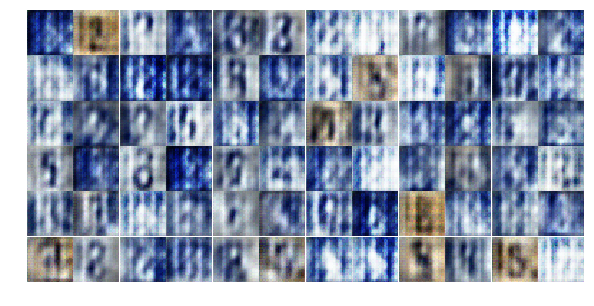

Epoch 1/25... Discriminator Loss: 0.6312... Generator Loss: 2.0475
Epoch 1/25... Discriminator Loss: 0.8830... Generator Loss: 0.9857
Epoch 1/25... Discriminator Loss: 0.8993... Generator Loss: 1.6351
Epoch 1/25... Discriminator Loss: 0.8391... Generator Loss: 0.9110
Epoch 1/25... Discriminator Loss: 0.5677... Generator Loss: 1.2593
Epoch 1/25... Discriminator Loss: 0.7591... Generator Loss: 1.1488
Epoch 1/25... Discriminator Loss: 0.8499... Generator Loss: 1.4581
Epoch 2/25... Discriminator Loss: 0.8142... Generator Loss: 1.8309
Epoch 2/25... Discriminator Loss: 0.6842... Generator Loss: 1.8257
Epoch 2/25... Discriminator Loss: 1.5920... Generator Loss: 0.3633


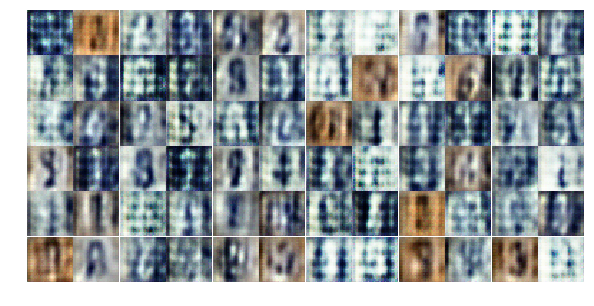

Epoch 2/25... Discriminator Loss: 1.1257... Generator Loss: 1.2244
Epoch 2/25... Discriminator Loss: 1.7530... Generator Loss: 0.3500
Epoch 2/25... Discriminator Loss: 0.9979... Generator Loss: 1.0979
Epoch 2/25... Discriminator Loss: 0.7556... Generator Loss: 1.6441
Epoch 2/25... Discriminator Loss: 1.3436... Generator Loss: 0.6445
Epoch 2/25... Discriminator Loss: 0.8421... Generator Loss: 1.5416
Epoch 2/25... Discriminator Loss: 1.3496... Generator Loss: 0.7838
Epoch 2/25... Discriminator Loss: 1.2823... Generator Loss: 0.7983
Epoch 2/25... Discriminator Loss: 0.9058... Generator Loss: 1.0449
Epoch 2/25... Discriminator Loss: 0.6257... Generator Loss: 1.4406


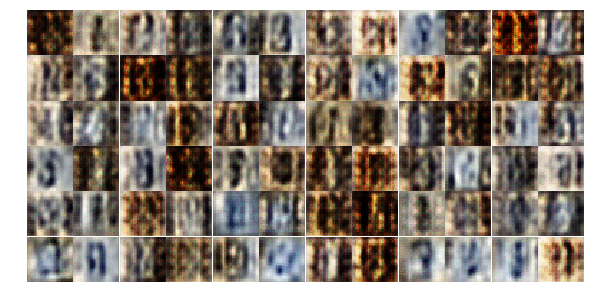

Epoch 2/25... Discriminator Loss: 0.6918... Generator Loss: 1.2415
Epoch 2/25... Discriminator Loss: 0.8104... Generator Loss: 1.8962
Epoch 2/25... Discriminator Loss: 0.9500... Generator Loss: 1.2145
Epoch 2/25... Discriminator Loss: 1.1312... Generator Loss: 0.8743
Epoch 2/25... Discriminator Loss: 1.1434... Generator Loss: 0.8212
Epoch 2/25... Discriminator Loss: 1.1171... Generator Loss: 0.8751
Epoch 2/25... Discriminator Loss: 1.0297... Generator Loss: 0.7343
Epoch 2/25... Discriminator Loss: 1.0778... Generator Loss: 1.3586
Epoch 2/25... Discriminator Loss: 0.9224... Generator Loss: 1.0295
Epoch 2/25... Discriminator Loss: 1.5472... Generator Loss: 0.4400


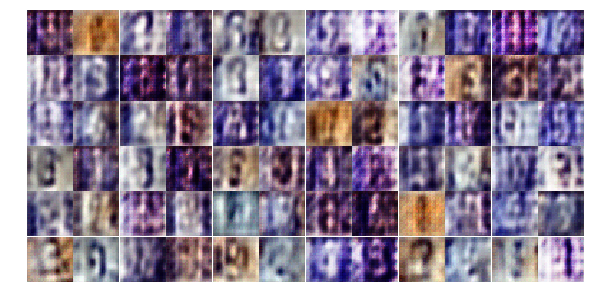

Epoch 2/25... Discriminator Loss: 1.0366... Generator Loss: 0.9062
Epoch 2/25... Discriminator Loss: 0.9541... Generator Loss: 1.0691
Epoch 2/25... Discriminator Loss: 1.3482... Generator Loss: 1.0977
Epoch 2/25... Discriminator Loss: 0.8185... Generator Loss: 1.6241
Epoch 2/25... Discriminator Loss: 1.0622... Generator Loss: 1.7043
Epoch 2/25... Discriminator Loss: 0.9701... Generator Loss: 1.1486
Epoch 2/25... Discriminator Loss: 0.9638... Generator Loss: 1.0311
Epoch 2/25... Discriminator Loss: 1.3613... Generator Loss: 0.4872
Epoch 2/25... Discriminator Loss: 1.0472... Generator Loss: 0.7587
Epoch 2/25... Discriminator Loss: 0.9227... Generator Loss: 1.1557


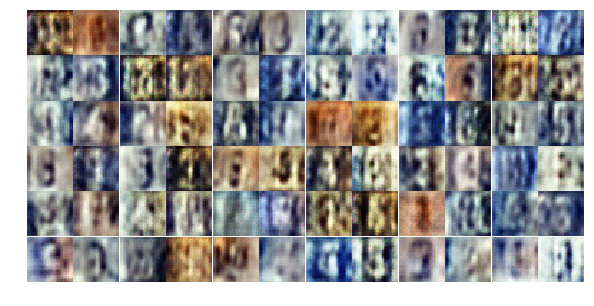

Epoch 2/25... Discriminator Loss: 1.0575... Generator Loss: 1.0168
Epoch 2/25... Discriminator Loss: 1.0927... Generator Loss: 0.8971
Epoch 2/25... Discriminator Loss: 1.3800... Generator Loss: 0.5710
Epoch 2/25... Discriminator Loss: 1.4675... Generator Loss: 0.4196
Epoch 2/25... Discriminator Loss: 0.9956... Generator Loss: 1.2416
Epoch 2/25... Discriminator Loss: 0.9375... Generator Loss: 1.2409
Epoch 2/25... Discriminator Loss: 1.1115... Generator Loss: 0.9756
Epoch 2/25... Discriminator Loss: 0.8498... Generator Loss: 1.3167
Epoch 2/25... Discriminator Loss: 1.0458... Generator Loss: 0.9266
Epoch 2/25... Discriminator Loss: 1.0091... Generator Loss: 1.0355


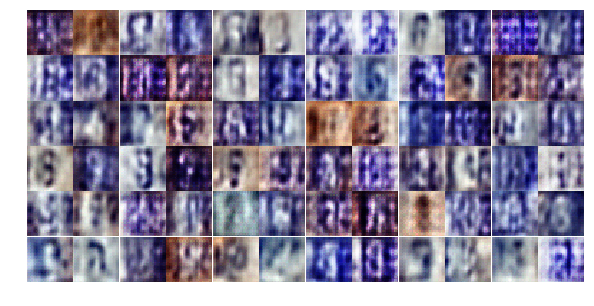

Epoch 2/25... Discriminator Loss: 0.7239... Generator Loss: 1.4858
Epoch 2/25... Discriminator Loss: 1.1565... Generator Loss: 0.9835
Epoch 2/25... Discriminator Loss: 0.7507... Generator Loss: 1.3092
Epoch 2/25... Discriminator Loss: 1.0177... Generator Loss: 1.0152
Epoch 2/25... Discriminator Loss: 0.9030... Generator Loss: 1.3277
Epoch 2/25... Discriminator Loss: 1.2618... Generator Loss: 0.6009
Epoch 2/25... Discriminator Loss: 0.8491... Generator Loss: 1.7121
Epoch 2/25... Discriminator Loss: 0.7963... Generator Loss: 1.1381
Epoch 2/25... Discriminator Loss: 0.6237... Generator Loss: 1.3131
Epoch 2/25... Discriminator Loss: 1.2462... Generator Loss: 0.5335


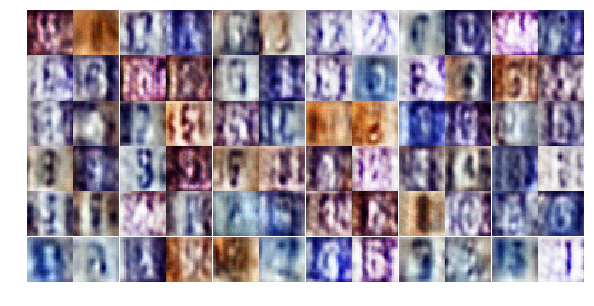

Epoch 2/25... Discriminator Loss: 0.6316... Generator Loss: 1.9821
Epoch 2/25... Discriminator Loss: 1.1059... Generator Loss: 0.7450
Epoch 2/25... Discriminator Loss: 1.9741... Generator Loss: 0.2552
Epoch 2/25... Discriminator Loss: 0.8452... Generator Loss: 1.5339
Epoch 3/25... Discriminator Loss: 0.6154... Generator Loss: 2.0195
Epoch 3/25... Discriminator Loss: 0.6761... Generator Loss: 1.3752
Epoch 3/25... Discriminator Loss: 0.9368... Generator Loss: 1.6949
Epoch 3/25... Discriminator Loss: 0.5256... Generator Loss: 1.9599
Epoch 3/25... Discriminator Loss: 0.8098... Generator Loss: 0.9698
Epoch 3/25... Discriminator Loss: 1.2637... Generator Loss: 0.5481


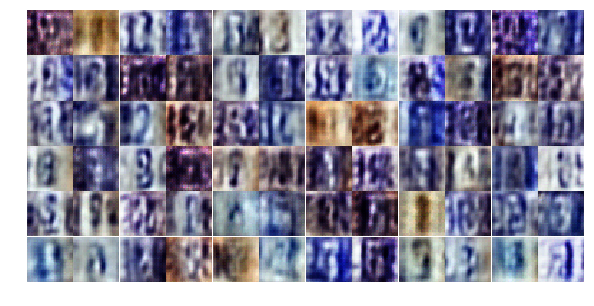

Epoch 3/25... Discriminator Loss: 0.7336... Generator Loss: 1.0769
Epoch 3/25... Discriminator Loss: 0.6691... Generator Loss: 1.2384
Epoch 3/25... Discriminator Loss: 0.8363... Generator Loss: 0.9073
Epoch 3/25... Discriminator Loss: 0.7747... Generator Loss: 0.8738
Epoch 3/25... Discriminator Loss: 1.5188... Generator Loss: 0.4194
Epoch 3/25... Discriminator Loss: 0.8191... Generator Loss: 1.1019
Epoch 3/25... Discriminator Loss: 0.9389... Generator Loss: 0.8319
Epoch 3/25... Discriminator Loss: 0.3555... Generator Loss: 2.3957
Epoch 3/25... Discriminator Loss: 1.0679... Generator Loss: 0.5644
Epoch 3/25... Discriminator Loss: 0.3574... Generator Loss: 2.2326


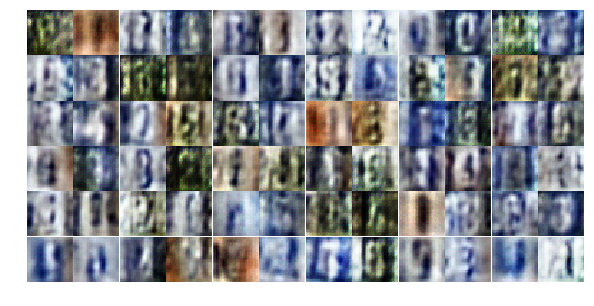

Epoch 3/25... Discriminator Loss: 1.0747... Generator Loss: 0.7214
Epoch 3/25... Discriminator Loss: 0.6800... Generator Loss: 1.1092
Epoch 3/25... Discriminator Loss: 0.8277... Generator Loss: 2.1965
Epoch 3/25... Discriminator Loss: 1.1657... Generator Loss: 0.4847
Epoch 3/25... Discriminator Loss: 0.8929... Generator Loss: 0.7598
Epoch 3/25... Discriminator Loss: 0.6153... Generator Loss: 1.8536
Epoch 3/25... Discriminator Loss: 0.2543... Generator Loss: 2.3941
Epoch 3/25... Discriminator Loss: 0.6232... Generator Loss: 1.1722
Epoch 3/25... Discriminator Loss: 0.5289... Generator Loss: 2.3126
Epoch 3/25... Discriminator Loss: 0.8238... Generator Loss: 0.9517


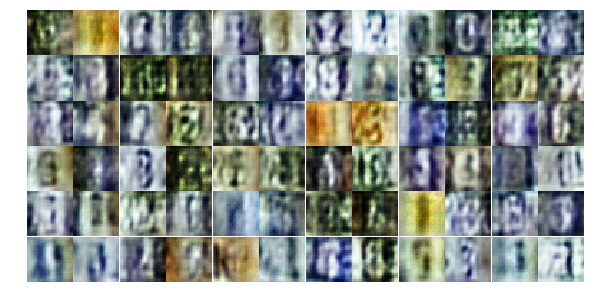

Epoch 3/25... Discriminator Loss: 0.8625... Generator Loss: 1.2746
Epoch 3/25... Discriminator Loss: 1.2898... Generator Loss: 0.5350
Epoch 3/25... Discriminator Loss: 1.0914... Generator Loss: 1.3680
Epoch 3/25... Discriminator Loss: 0.4260... Generator Loss: 2.2606
Epoch 3/25... Discriminator Loss: 1.1793... Generator Loss: 0.5958
Epoch 3/25... Discriminator Loss: 0.3544... Generator Loss: 2.0851
Epoch 3/25... Discriminator Loss: 1.1051... Generator Loss: 0.6377
Epoch 3/25... Discriminator Loss: 0.5155... Generator Loss: 1.7836
Epoch 3/25... Discriminator Loss: 0.5296... Generator Loss: 1.8855
Epoch 3/25... Discriminator Loss: 0.6992... Generator Loss: 0.9978


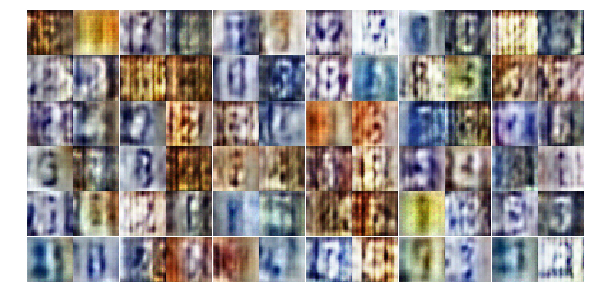

Epoch 3/25... Discriminator Loss: 0.8194... Generator Loss: 1.0267
Epoch 3/25... Discriminator Loss: 0.3844... Generator Loss: 2.2725
Epoch 3/25... Discriminator Loss: 0.8029... Generator Loss: 1.1070
Epoch 3/25... Discriminator Loss: 0.4951... Generator Loss: 1.4185
Epoch 3/25... Discriminator Loss: 0.4672... Generator Loss: 2.5916
Epoch 3/25... Discriminator Loss: 0.4828... Generator Loss: 1.4388
Epoch 3/25... Discriminator Loss: 0.6077... Generator Loss: 1.6921
Epoch 3/25... Discriminator Loss: 0.8633... Generator Loss: 0.9561
Epoch 3/25... Discriminator Loss: 0.9708... Generator Loss: 2.2238
Epoch 3/25... Discriminator Loss: 0.5880... Generator Loss: 2.0449


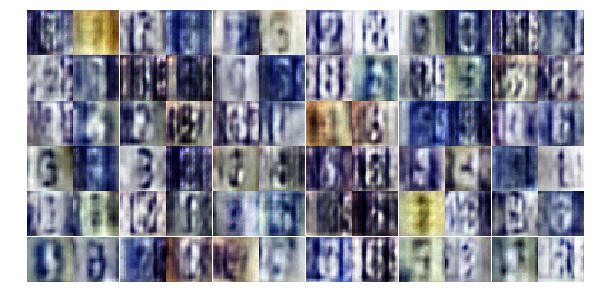

Epoch 3/25... Discriminator Loss: 1.0108... Generator Loss: 0.7758
Epoch 3/25... Discriminator Loss: 0.5766... Generator Loss: 2.1692
Epoch 3/25... Discriminator Loss: 0.5849... Generator Loss: 1.2359
Epoch 3/25... Discriminator Loss: 0.4032... Generator Loss: 1.8628
Epoch 3/25... Discriminator Loss: 0.3443... Generator Loss: 2.8306
Epoch 3/25... Discriminator Loss: 0.5065... Generator Loss: 1.7005
Epoch 3/25... Discriminator Loss: 0.4113... Generator Loss: 2.1648
Epoch 3/25... Discriminator Loss: 0.3667... Generator Loss: 1.6285
Epoch 3/25... Discriminator Loss: 0.5206... Generator Loss: 1.3542
Epoch 3/25... Discriminator Loss: 0.4367... Generator Loss: 1.6510


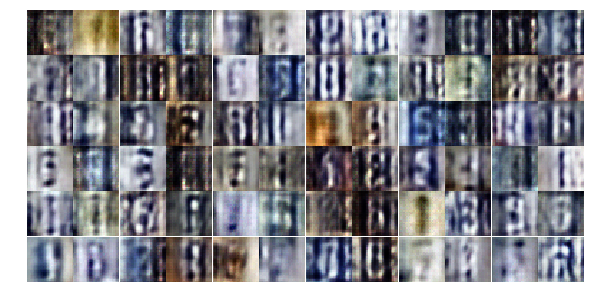

Epoch 3/25... Discriminator Loss: 0.6603... Generator Loss: 1.3336
Epoch 4/25... Discriminator Loss: 1.0010... Generator Loss: 0.6469
Epoch 4/25... Discriminator Loss: 0.6454... Generator Loss: 1.2596
Epoch 4/25... Discriminator Loss: 1.8784... Generator Loss: 0.2363
Epoch 4/25... Discriminator Loss: 0.7247... Generator Loss: 1.0126
Epoch 4/25... Discriminator Loss: 0.4727... Generator Loss: 1.8361
Epoch 4/25... Discriminator Loss: 0.6001... Generator Loss: 2.5501
Epoch 4/25... Discriminator Loss: 0.2689... Generator Loss: 2.3151
Epoch 4/25... Discriminator Loss: 0.4107... Generator Loss: 2.1964
Epoch 4/25... Discriminator Loss: 0.9432... Generator Loss: 0.8347


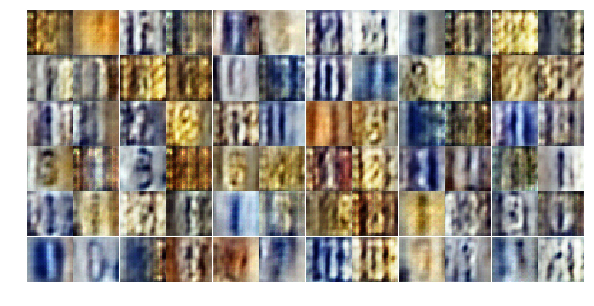

Epoch 4/25... Discriminator Loss: 0.5273... Generator Loss: 1.6049
Epoch 4/25... Discriminator Loss: 0.7750... Generator Loss: 1.0891
Epoch 4/25... Discriminator Loss: 1.1726... Generator Loss: 0.7029
Epoch 4/25... Discriminator Loss: 1.0998... Generator Loss: 0.7878
Epoch 4/25... Discriminator Loss: 0.7237... Generator Loss: 2.1125
Epoch 4/25... Discriminator Loss: 1.5017... Generator Loss: 0.4540
Epoch 4/25... Discriminator Loss: 1.6731... Generator Loss: 0.4237
Epoch 4/25... Discriminator Loss: 0.8594... Generator Loss: 0.8876
Epoch 4/25... Discriminator Loss: 0.7912... Generator Loss: 1.1316
Epoch 4/25... Discriminator Loss: 0.6778... Generator Loss: 1.7891


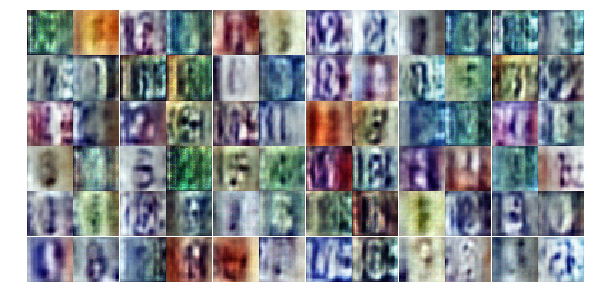

Epoch 4/25... Discriminator Loss: 0.6053... Generator Loss: 1.6955
Epoch 4/25... Discriminator Loss: 0.4826... Generator Loss: 1.4286
Epoch 4/25... Discriminator Loss: 0.4880... Generator Loss: 1.6788
Epoch 4/25... Discriminator Loss: 0.5871... Generator Loss: 1.3419
Epoch 4/25... Discriminator Loss: 0.6311... Generator Loss: 2.3445
Epoch 4/25... Discriminator Loss: 0.6306... Generator Loss: 1.8792
Epoch 4/25... Discriminator Loss: 1.7018... Generator Loss: 0.3167
Epoch 4/25... Discriminator Loss: 1.0643... Generator Loss: 1.9429
Epoch 4/25... Discriminator Loss: 0.4596... Generator Loss: 2.3094
Epoch 4/25... Discriminator Loss: 0.5205... Generator Loss: 1.3571


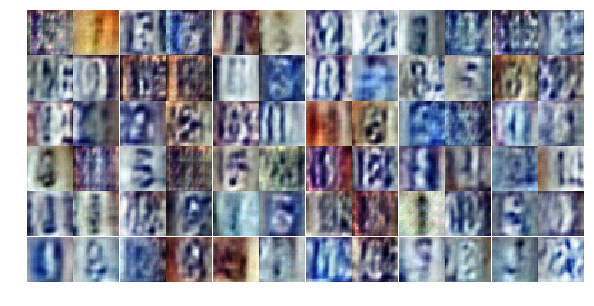

Epoch 4/25... Discriminator Loss: 0.4746... Generator Loss: 1.6343
Epoch 4/25... Discriminator Loss: 0.6941... Generator Loss: 1.0383
Epoch 4/25... Discriminator Loss: 0.8228... Generator Loss: 0.9896
Epoch 4/25... Discriminator Loss: 0.7641... Generator Loss: 2.1852
Epoch 4/25... Discriminator Loss: 0.5821... Generator Loss: 1.4386
Epoch 4/25... Discriminator Loss: 0.8175... Generator Loss: 1.9031
Epoch 4/25... Discriminator Loss: 1.1064... Generator Loss: 0.8044
Epoch 4/25... Discriminator Loss: 0.9824... Generator Loss: 1.9169
Epoch 4/25... Discriminator Loss: 0.5382... Generator Loss: 1.6689
Epoch 4/25... Discriminator Loss: 0.8033... Generator Loss: 0.9615


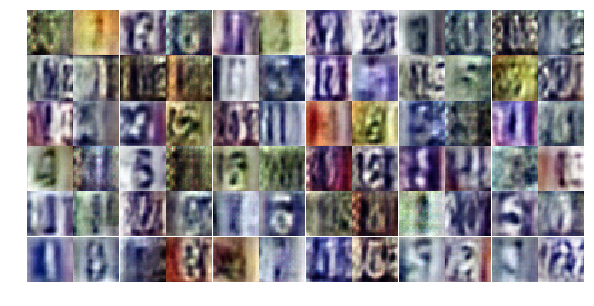

Epoch 4/25... Discriminator Loss: 0.4936... Generator Loss: 1.5452
Epoch 4/25... Discriminator Loss: 0.6726... Generator Loss: 1.0984
Epoch 4/25... Discriminator Loss: 0.8770... Generator Loss: 0.8046
Epoch 4/25... Discriminator Loss: 0.6114... Generator Loss: 1.8464
Epoch 4/25... Discriminator Loss: 0.9255... Generator Loss: 0.7343
Epoch 4/25... Discriminator Loss: 1.0367... Generator Loss: 0.9541
Epoch 4/25... Discriminator Loss: 1.7707... Generator Loss: 0.2616
Epoch 4/25... Discriminator Loss: 0.7664... Generator Loss: 1.0176
Epoch 4/25... Discriminator Loss: 0.6744... Generator Loss: 1.4312
Epoch 4/25... Discriminator Loss: 0.5342... Generator Loss: 1.6986


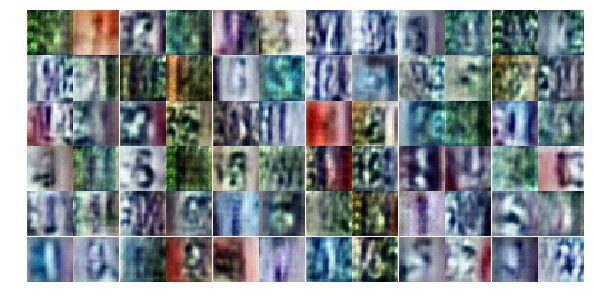

Epoch 4/25... Discriminator Loss: 0.6134... Generator Loss: 1.3909
Epoch 4/25... Discriminator Loss: 0.5815... Generator Loss: 1.5384
Epoch 4/25... Discriminator Loss: 0.4648... Generator Loss: 2.4053
Epoch 4/25... Discriminator Loss: 0.5896... Generator Loss: 1.7247
Epoch 4/25... Discriminator Loss: 0.4778... Generator Loss: 1.4731
Epoch 4/25... Discriminator Loss: 0.8031... Generator Loss: 1.8284
Epoch 4/25... Discriminator Loss: 0.5306... Generator Loss: 1.2865
Epoch 4/25... Discriminator Loss: 0.8024... Generator Loss: 0.8870
Epoch 4/25... Discriminator Loss: 0.5060... Generator Loss: 1.4353
Epoch 5/25... Discriminator Loss: 0.8244... Generator Loss: 2.1338


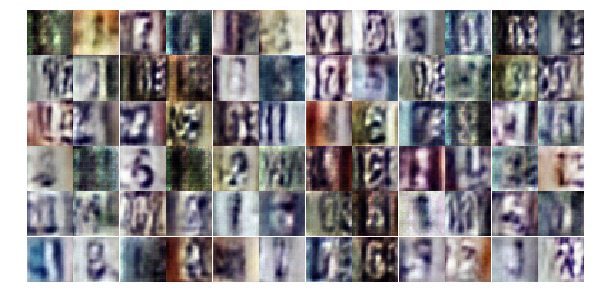

Epoch 5/25... Discriminator Loss: 0.5695... Generator Loss: 1.2928
Epoch 5/25... Discriminator Loss: 0.5644... Generator Loss: 1.6125
Epoch 5/25... Discriminator Loss: 0.4388... Generator Loss: 1.6807
Epoch 5/25... Discriminator Loss: 0.8166... Generator Loss: 0.7709
Epoch 5/25... Discriminator Loss: 0.4104... Generator Loss: 2.1331
Epoch 5/25... Discriminator Loss: 0.5402... Generator Loss: 1.3536
Epoch 5/25... Discriminator Loss: 1.0055... Generator Loss: 0.6161
Epoch 5/25... Discriminator Loss: 0.6190... Generator Loss: 1.1253
Epoch 5/25... Discriminator Loss: 0.5089... Generator Loss: 2.1804
Epoch 5/25... Discriminator Loss: 0.9547... Generator Loss: 0.7134


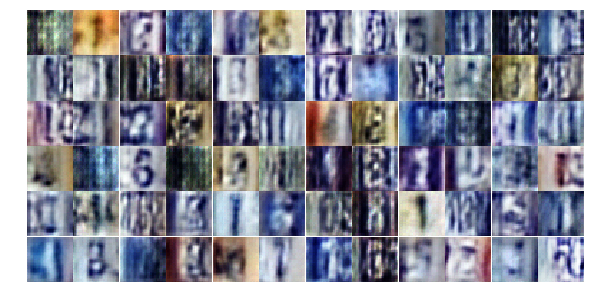

Epoch 5/25... Discriminator Loss: 1.0937... Generator Loss: 0.5536
Epoch 5/25... Discriminator Loss: 0.6362... Generator Loss: 1.4355
Epoch 5/25... Discriminator Loss: 0.6081... Generator Loss: 1.6264
Epoch 5/25... Discriminator Loss: 0.9489... Generator Loss: 0.7237
Epoch 5/25... Discriminator Loss: 0.4782... Generator Loss: 1.8756
Epoch 5/25... Discriminator Loss: 0.7632... Generator Loss: 1.0173
Epoch 5/25... Discriminator Loss: 0.6041... Generator Loss: 1.4007
Epoch 5/25... Discriminator Loss: 0.5724... Generator Loss: 1.7347
Epoch 5/25... Discriminator Loss: 0.5134... Generator Loss: 1.7557
Epoch 5/25... Discriminator Loss: 0.4000... Generator Loss: 2.1065


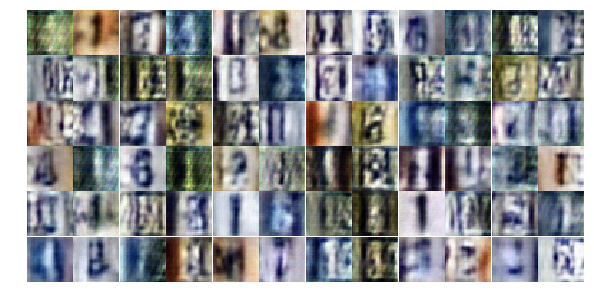

Epoch 5/25... Discriminator Loss: 0.4907... Generator Loss: 1.5616
Epoch 5/25... Discriminator Loss: 0.6143... Generator Loss: 1.5810
Epoch 5/25... Discriminator Loss: 0.5236... Generator Loss: 1.2887
Epoch 5/25... Discriminator Loss: 0.5805... Generator Loss: 1.1787
Epoch 5/25... Discriminator Loss: 1.1039... Generator Loss: 0.6099
Epoch 5/25... Discriminator Loss: 0.8994... Generator Loss: 0.7768
Epoch 5/25... Discriminator Loss: 0.7286... Generator Loss: 1.1939
Epoch 5/25... Discriminator Loss: 0.5190... Generator Loss: 1.8436
Epoch 5/25... Discriminator Loss: 1.1096... Generator Loss: 0.6067
Epoch 5/25... Discriminator Loss: 0.5034... Generator Loss: 1.2544


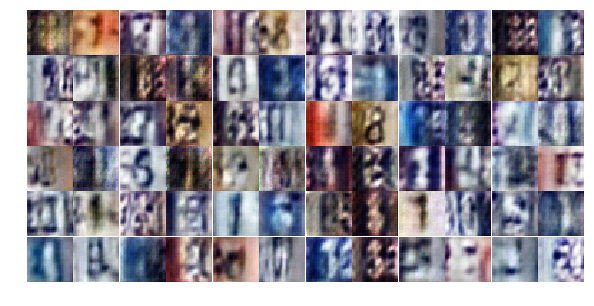

Epoch 5/25... Discriminator Loss: 0.5252... Generator Loss: 1.5511
Epoch 5/25... Discriminator Loss: 0.3478... Generator Loss: 1.7179
Epoch 5/25... Discriminator Loss: 0.3805... Generator Loss: 2.1106
Epoch 5/25... Discriminator Loss: 1.0045... Generator Loss: 2.4279
Epoch 5/25... Discriminator Loss: 0.8458... Generator Loss: 0.8567
Epoch 5/25... Discriminator Loss: 0.6707... Generator Loss: 1.3837
Epoch 5/25... Discriminator Loss: 0.9205... Generator Loss: 0.7610
Epoch 5/25... Discriminator Loss: 0.5457... Generator Loss: 1.1856
Epoch 5/25... Discriminator Loss: 0.9395... Generator Loss: 0.7238
Epoch 5/25... Discriminator Loss: 0.6923... Generator Loss: 0.9834


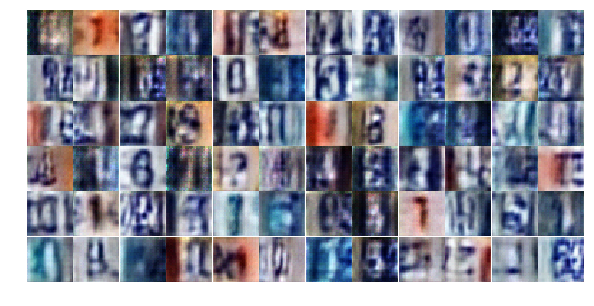

Epoch 5/25... Discriminator Loss: 0.3908... Generator Loss: 1.8968
Epoch 5/25... Discriminator Loss: 0.6896... Generator Loss: 1.0100
Epoch 5/25... Discriminator Loss: 1.6221... Generator Loss: 0.6078
Epoch 5/25... Discriminator Loss: 0.7066... Generator Loss: 1.3476
Epoch 5/25... Discriminator Loss: 1.2459... Generator Loss: 1.9278
Epoch 5/25... Discriminator Loss: 0.9530... Generator Loss: 0.6654
Epoch 5/25... Discriminator Loss: 0.6998... Generator Loss: 1.9713
Epoch 5/25... Discriminator Loss: 0.6185... Generator Loss: 1.4172
Epoch 5/25... Discriminator Loss: 0.4473... Generator Loss: 1.5386
Epoch 5/25... Discriminator Loss: 0.5133... Generator Loss: 1.7751


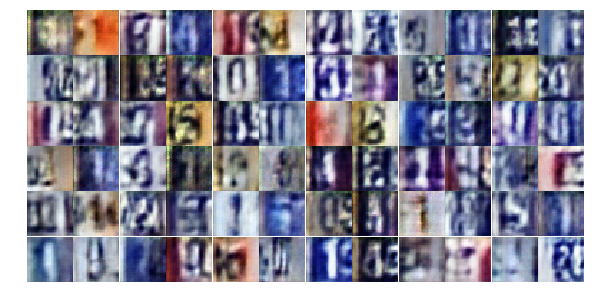

Epoch 5/25... Discriminator Loss: 0.8929... Generator Loss: 0.6993
Epoch 5/25... Discriminator Loss: 0.8120... Generator Loss: 0.8315
Epoch 5/25... Discriminator Loss: 1.5346... Generator Loss: 3.4742
Epoch 5/25... Discriminator Loss: 0.7289... Generator Loss: 1.2405
Epoch 5/25... Discriminator Loss: 0.6347... Generator Loss: 1.3211
Epoch 5/25... Discriminator Loss: 0.8055... Generator Loss: 0.9300
Epoch 6/25... Discriminator Loss: 0.6305... Generator Loss: 1.1726
Epoch 6/25... Discriminator Loss: 0.4731... Generator Loss: 1.4284
Epoch 6/25... Discriminator Loss: 0.4873... Generator Loss: 1.2981
Epoch 6/25... Discriminator Loss: 1.1013... Generator Loss: 0.6240


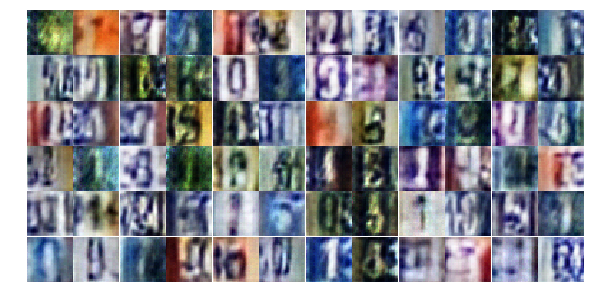

Epoch 6/25... Discriminator Loss: 0.6755... Generator Loss: 1.1577
Epoch 6/25... Discriminator Loss: 0.7446... Generator Loss: 1.0887
Epoch 6/25... Discriminator Loss: 0.7022... Generator Loss: 1.0282
Epoch 6/25... Discriminator Loss: 0.7951... Generator Loss: 0.8831
Epoch 6/25... Discriminator Loss: 0.4453... Generator Loss: 1.4949
Epoch 6/25... Discriminator Loss: 0.4592... Generator Loss: 1.2941
Epoch 6/25... Discriminator Loss: 0.5482... Generator Loss: 1.2066
Epoch 6/25... Discriminator Loss: 0.5420... Generator Loss: 1.3878
Epoch 6/25... Discriminator Loss: 0.7500... Generator Loss: 0.9500
Epoch 6/25... Discriminator Loss: 1.1083... Generator Loss: 0.5737


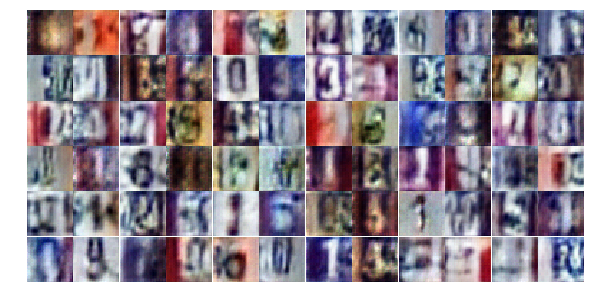

Epoch 6/25... Discriminator Loss: 0.5267... Generator Loss: 1.7994
Epoch 6/25... Discriminator Loss: 0.7475... Generator Loss: 2.1483
Epoch 6/25... Discriminator Loss: 0.9610... Generator Loss: 0.6426
Epoch 6/25... Discriminator Loss: 0.4346... Generator Loss: 1.9262
Epoch 6/25... Discriminator Loss: 0.4514... Generator Loss: 1.7367
Epoch 6/25... Discriminator Loss: 0.4709... Generator Loss: 1.6890
Epoch 6/25... Discriminator Loss: 0.4350... Generator Loss: 1.7192
Epoch 6/25... Discriminator Loss: 0.8766... Generator Loss: 0.7561
Epoch 6/25... Discriminator Loss: 0.5818... Generator Loss: 2.3239
Epoch 6/25... Discriminator Loss: 0.7177... Generator Loss: 1.2079


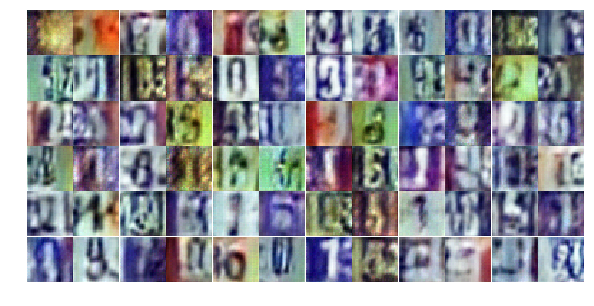

Epoch 6/25... Discriminator Loss: 1.0197... Generator Loss: 0.6142
Epoch 6/25... Discriminator Loss: 0.5814... Generator Loss: 1.1361
Epoch 6/25... Discriminator Loss: 0.6879... Generator Loss: 1.1284
Epoch 6/25... Discriminator Loss: 0.6914... Generator Loss: 2.1037
Epoch 6/25... Discriminator Loss: 0.6499... Generator Loss: 1.3397
Epoch 6/25... Discriminator Loss: 1.0759... Generator Loss: 0.6360
Epoch 6/25... Discriminator Loss: 0.9698... Generator Loss: 0.6541
Epoch 6/25... Discriminator Loss: 0.3831... Generator Loss: 1.5428
Epoch 6/25... Discriminator Loss: 0.4417... Generator Loss: 1.4829
Epoch 6/25... Discriminator Loss: 0.4174... Generator Loss: 1.4869


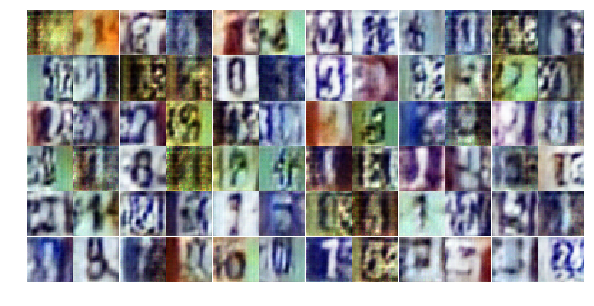

Epoch 6/25... Discriminator Loss: 0.7716... Generator Loss: 1.0662
Epoch 6/25... Discriminator Loss: 0.7549... Generator Loss: 1.1084
Epoch 6/25... Discriminator Loss: 0.7647... Generator Loss: 0.9766
Epoch 6/25... Discriminator Loss: 0.4198... Generator Loss: 1.7774
Epoch 6/25... Discriminator Loss: 0.7153... Generator Loss: 0.9178
Epoch 6/25... Discriminator Loss: 0.5920... Generator Loss: 1.3505
Epoch 6/25... Discriminator Loss: 0.6094... Generator Loss: 1.1736
Epoch 6/25... Discriminator Loss: 0.7726... Generator Loss: 2.2924
Epoch 6/25... Discriminator Loss: 1.0581... Generator Loss: 0.6403
Epoch 6/25... Discriminator Loss: 1.0801... Generator Loss: 0.6773


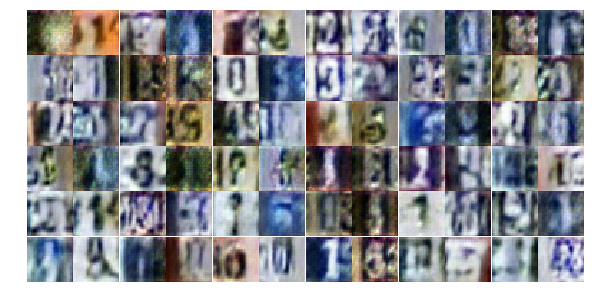

Epoch 6/25... Discriminator Loss: 0.5398... Generator Loss: 1.6318
Epoch 6/25... Discriminator Loss: 1.1125... Generator Loss: 2.3575
Epoch 6/25... Discriminator Loss: 0.8813... Generator Loss: 0.8344
Epoch 6/25... Discriminator Loss: 0.6932... Generator Loss: 2.6637
Epoch 6/25... Discriminator Loss: 0.5535... Generator Loss: 2.0371
Epoch 6/25... Discriminator Loss: 0.5048... Generator Loss: 1.3482
Epoch 6/25... Discriminator Loss: 1.0055... Generator Loss: 0.7689
Epoch 6/25... Discriminator Loss: 0.6768... Generator Loss: 1.1078
Epoch 6/25... Discriminator Loss: 0.4802... Generator Loss: 1.6367
Epoch 6/25... Discriminator Loss: 1.5548... Generator Loss: 0.3121


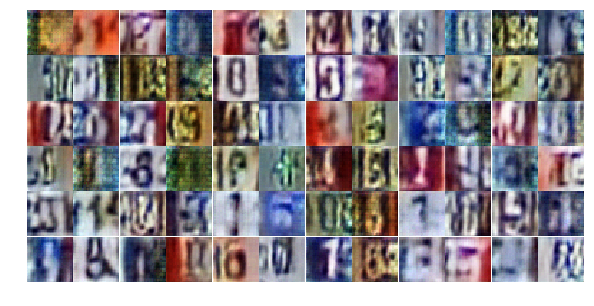

Epoch 6/25... Discriminator Loss: 0.6058... Generator Loss: 1.5153
Epoch 6/25... Discriminator Loss: 0.5807... Generator Loss: 1.6054
Epoch 6/25... Discriminator Loss: 0.5900... Generator Loss: 1.2012
Epoch 7/25... Discriminator Loss: 0.6233... Generator Loss: 1.4287
Epoch 7/25... Discriminator Loss: 0.6051... Generator Loss: 1.4026
Epoch 7/25... Discriminator Loss: 0.7314... Generator Loss: 1.0713
Epoch 7/25... Discriminator Loss: 0.6822... Generator Loss: 1.0738
Epoch 7/25... Discriminator Loss: 0.6266... Generator Loss: 1.2291
Epoch 7/25... Discriminator Loss: 0.3457... Generator Loss: 1.6965
Epoch 7/25... Discriminator Loss: 1.2331... Generator Loss: 0.4318


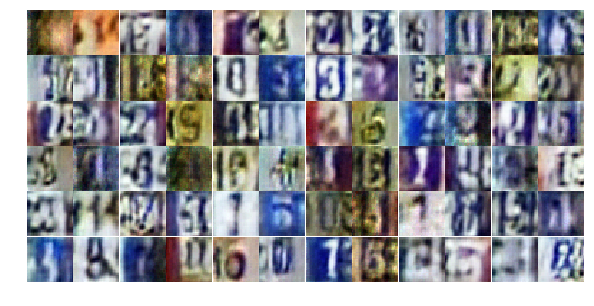

Epoch 7/25... Discriminator Loss: 1.0307... Generator Loss: 2.4580
Epoch 7/25... Discriminator Loss: 0.7669... Generator Loss: 0.8788
Epoch 7/25... Discriminator Loss: 0.7390... Generator Loss: 1.0257
Epoch 7/25... Discriminator Loss: 0.6019... Generator Loss: 1.9713
Epoch 7/25... Discriminator Loss: 0.7923... Generator Loss: 2.4037
Epoch 7/25... Discriminator Loss: 0.5994... Generator Loss: 1.0571
Epoch 7/25... Discriminator Loss: 0.7475... Generator Loss: 1.7496
Epoch 7/25... Discriminator Loss: 1.0140... Generator Loss: 1.0963
Epoch 7/25... Discriminator Loss: 0.7126... Generator Loss: 1.2263
Epoch 7/25... Discriminator Loss: 0.6073... Generator Loss: 2.0123


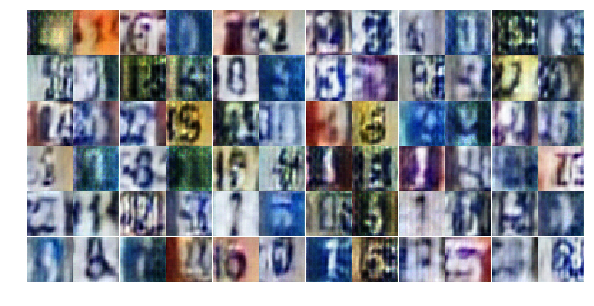

Epoch 7/25... Discriminator Loss: 0.6021... Generator Loss: 1.2454
Epoch 7/25... Discriminator Loss: 0.4280... Generator Loss: 1.6059
Epoch 7/25... Discriminator Loss: 1.3080... Generator Loss: 0.4629
Epoch 7/25... Discriminator Loss: 0.6402... Generator Loss: 1.4190
Epoch 7/25... Discriminator Loss: 0.5330... Generator Loss: 1.2285
Epoch 7/25... Discriminator Loss: 0.4943... Generator Loss: 1.4658
Epoch 7/25... Discriminator Loss: 0.6884... Generator Loss: 0.9437
Epoch 7/25... Discriminator Loss: 1.0475... Generator Loss: 0.6135
Epoch 7/25... Discriminator Loss: 0.3066... Generator Loss: 2.0581
Epoch 7/25... Discriminator Loss: 0.4508... Generator Loss: 1.4244


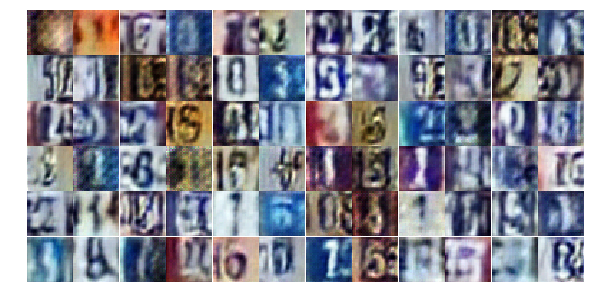

Epoch 7/25... Discriminator Loss: 1.0960... Generator Loss: 0.6014
Epoch 7/25... Discriminator Loss: 1.0165... Generator Loss: 0.6305
Epoch 7/25... Discriminator Loss: 0.9478... Generator Loss: 0.8555
Epoch 7/25... Discriminator Loss: 0.5907... Generator Loss: 1.2438
Epoch 7/25... Discriminator Loss: 0.6532... Generator Loss: 1.1686
Epoch 7/25... Discriminator Loss: 0.6227... Generator Loss: 1.3205
Epoch 7/25... Discriminator Loss: 0.7130... Generator Loss: 0.9318
Epoch 7/25... Discriminator Loss: 0.5312... Generator Loss: 1.2605
Epoch 7/25... Discriminator Loss: 0.9943... Generator Loss: 0.6527
Epoch 7/25... Discriminator Loss: 0.7569... Generator Loss: 2.8552


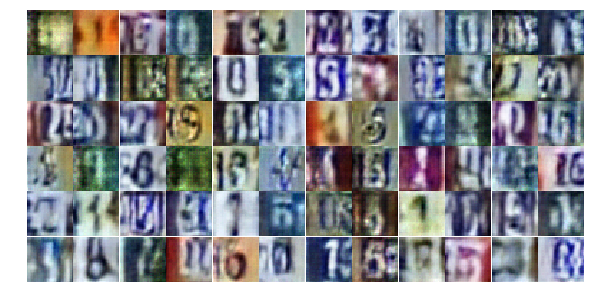

Epoch 7/25... Discriminator Loss: 0.8194... Generator Loss: 0.8871
Epoch 7/25... Discriminator Loss: 0.5011... Generator Loss: 1.5230
Epoch 7/25... Discriminator Loss: 0.4850... Generator Loss: 1.3190
Epoch 7/25... Discriminator Loss: 0.8888... Generator Loss: 0.8302
Epoch 7/25... Discriminator Loss: 1.4246... Generator Loss: 2.9685
Epoch 7/25... Discriminator Loss: 0.6123... Generator Loss: 1.5753
Epoch 7/25... Discriminator Loss: 0.7659... Generator Loss: 0.8719
Epoch 7/25... Discriminator Loss: 0.8554... Generator Loss: 1.0017
Epoch 7/25... Discriminator Loss: 0.2951... Generator Loss: 3.4087
Epoch 7/25... Discriminator Loss: 1.1601... Generator Loss: 0.5720


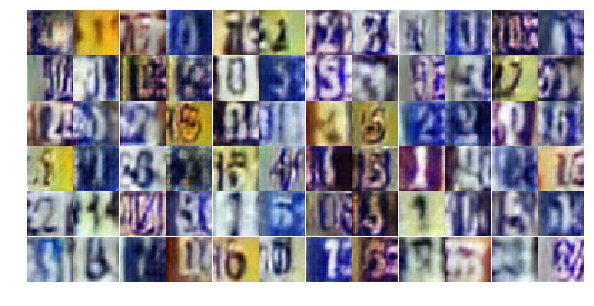

Epoch 7/25... Discriminator Loss: 0.4583... Generator Loss: 1.7680
Epoch 7/25... Discriminator Loss: 0.5789... Generator Loss: 1.3083
Epoch 7/25... Discriminator Loss: 0.8564... Generator Loss: 0.8241
Epoch 7/25... Discriminator Loss: 0.6294... Generator Loss: 1.1797
Epoch 7/25... Discriminator Loss: 0.5818... Generator Loss: 1.1393
Epoch 7/25... Discriminator Loss: 0.7496... Generator Loss: 0.9716
Epoch 7/25... Discriminator Loss: 1.1407... Generator Loss: 0.5314
Epoch 7/25... Discriminator Loss: 0.6492... Generator Loss: 1.3602
Epoch 7/25... Discriminator Loss: 0.8936... Generator Loss: 0.7349
Epoch 7/25... Discriminator Loss: 0.4717... Generator Loss: 1.4598


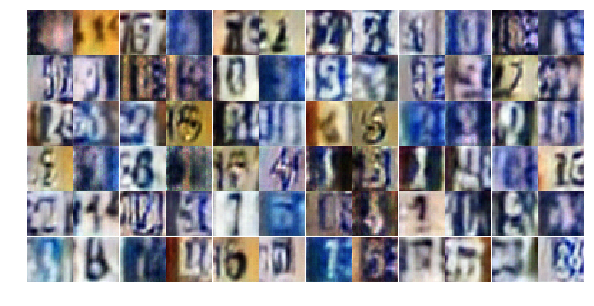

Epoch 7/25... Discriminator Loss: 0.4067... Generator Loss: 2.1452
Epoch 8/25... Discriminator Loss: 0.5414... Generator Loss: 1.1852
Epoch 8/25... Discriminator Loss: 0.9964... Generator Loss: 0.5965
Epoch 8/25... Discriminator Loss: 0.6818... Generator Loss: 1.0512
Epoch 8/25... Discriminator Loss: 1.1563... Generator Loss: 0.5096
Epoch 8/25... Discriminator Loss: 1.3397... Generator Loss: 0.4111
Epoch 8/25... Discriminator Loss: 0.8910... Generator Loss: 0.8253
Epoch 8/25... Discriminator Loss: 0.5781... Generator Loss: 1.6746
Epoch 8/25... Discriminator Loss: 0.7348... Generator Loss: 1.4663
Epoch 8/25... Discriminator Loss: 0.7360... Generator Loss: 1.7526


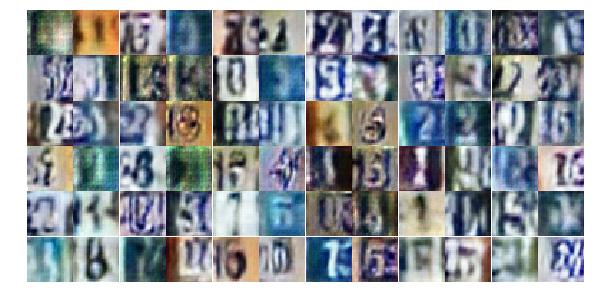

Epoch 8/25... Discriminator Loss: 0.3840... Generator Loss: 1.8752
Epoch 8/25... Discriminator Loss: 0.4796... Generator Loss: 2.1630
Epoch 8/25... Discriminator Loss: 0.8619... Generator Loss: 0.8634
Epoch 8/25... Discriminator Loss: 0.5680... Generator Loss: 1.6804
Epoch 8/25... Discriminator Loss: 0.8772... Generator Loss: 1.0302
Epoch 8/25... Discriminator Loss: 0.8681... Generator Loss: 2.0515
Epoch 8/25... Discriminator Loss: 0.7308... Generator Loss: 2.1210
Epoch 8/25... Discriminator Loss: 0.4550... Generator Loss: 1.5403
Epoch 8/25... Discriminator Loss: 0.6105... Generator Loss: 1.1792
Epoch 8/25... Discriminator Loss: 1.2678... Generator Loss: 0.4406


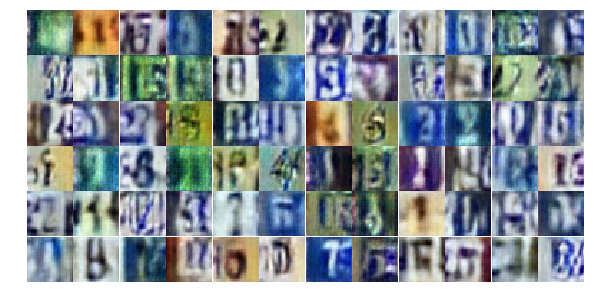

Epoch 8/25... Discriminator Loss: 0.4468... Generator Loss: 1.7390
Epoch 8/25... Discriminator Loss: 0.4884... Generator Loss: 1.3908
Epoch 8/25... Discriminator Loss: 0.8237... Generator Loss: 0.8310
Epoch 8/25... Discriminator Loss: 0.5989... Generator Loss: 1.6505
Epoch 8/25... Discriminator Loss: 0.4102... Generator Loss: 1.6724
Epoch 8/25... Discriminator Loss: 0.4306... Generator Loss: 1.7537
Epoch 8/25... Discriminator Loss: 0.6630... Generator Loss: 1.0732
Epoch 8/25... Discriminator Loss: 0.4908... Generator Loss: 1.3429
Epoch 8/25... Discriminator Loss: 0.7516... Generator Loss: 2.4696
Epoch 8/25... Discriminator Loss: 0.6397... Generator Loss: 0.9989


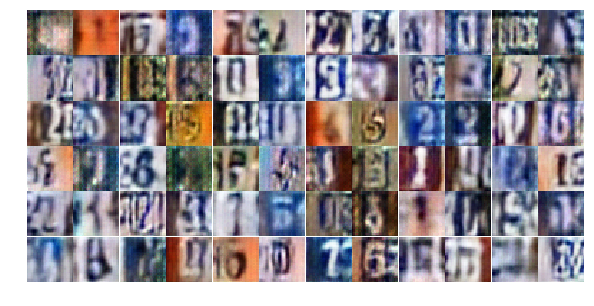

Epoch 8/25... Discriminator Loss: 0.5455... Generator Loss: 1.8105
Epoch 8/25... Discriminator Loss: 1.1108... Generator Loss: 0.5439
Epoch 8/25... Discriminator Loss: 0.5854... Generator Loss: 1.3430
Epoch 8/25... Discriminator Loss: 0.6586... Generator Loss: 1.0001
Epoch 8/25... Discriminator Loss: 0.5985... Generator Loss: 1.0870
Epoch 8/25... Discriminator Loss: 0.3933... Generator Loss: 1.6378
Epoch 8/25... Discriminator Loss: 1.3798... Generator Loss: 1.1860
Epoch 8/25... Discriminator Loss: 0.7241... Generator Loss: 1.0805
Epoch 8/25... Discriminator Loss: 0.8658... Generator Loss: 0.8067
Epoch 8/25... Discriminator Loss: 0.6277... Generator Loss: 1.3274


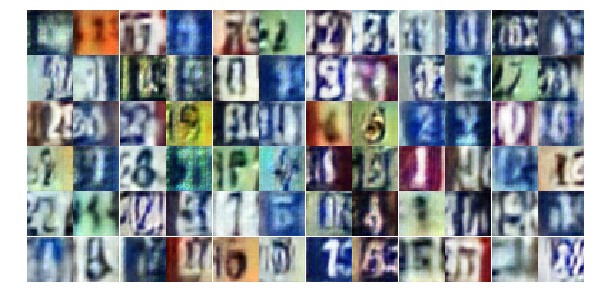

Epoch 8/25... Discriminator Loss: 0.5364... Generator Loss: 1.3079
Epoch 8/25... Discriminator Loss: 1.3883... Generator Loss: 0.3995
Epoch 8/25... Discriminator Loss: 0.4847... Generator Loss: 1.4361
Epoch 8/25... Discriminator Loss: 0.5222... Generator Loss: 1.8445
Epoch 8/25... Discriminator Loss: 0.7672... Generator Loss: 1.9997
Epoch 8/25... Discriminator Loss: 0.8546... Generator Loss: 0.8204
Epoch 8/25... Discriminator Loss: 0.5376... Generator Loss: 1.4641
Epoch 8/25... Discriminator Loss: 0.4624... Generator Loss: 1.5103
Epoch 8/25... Discriminator Loss: 0.5725... Generator Loss: 1.2599
Epoch 8/25... Discriminator Loss: 0.5570... Generator Loss: 1.6183


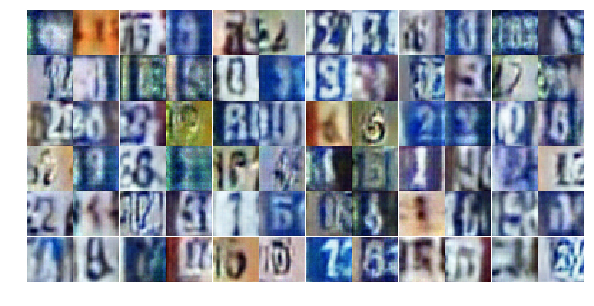

Epoch 8/25... Discriminator Loss: 0.4731... Generator Loss: 1.3319
Epoch 8/25... Discriminator Loss: 0.5139... Generator Loss: 1.6131
Epoch 8/25... Discriminator Loss: 0.5968... Generator Loss: 1.2776
Epoch 8/25... Discriminator Loss: 0.7581... Generator Loss: 1.0003
Epoch 8/25... Discriminator Loss: 0.5091... Generator Loss: 1.7796
Epoch 8/25... Discriminator Loss: 1.3495... Generator Loss: 0.4013
Epoch 8/25... Discriminator Loss: 0.5528... Generator Loss: 1.1442
Epoch 8/25... Discriminator Loss: 0.5027... Generator Loss: 2.5091
Epoch 9/25... Discriminator Loss: 0.7272... Generator Loss: 1.3980
Epoch 9/25... Discriminator Loss: 0.7049... Generator Loss: 1.1199


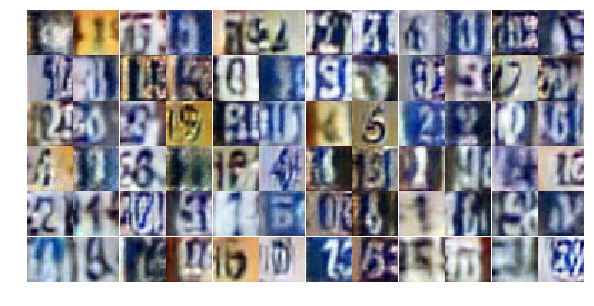

Epoch 9/25... Discriminator Loss: 0.7196... Generator Loss: 0.8887
Epoch 9/25... Discriminator Loss: 0.5186... Generator Loss: 1.2102
Epoch 9/25... Discriminator Loss: 0.9122... Generator Loss: 0.6985
Epoch 9/25... Discriminator Loss: 0.4743... Generator Loss: 1.6131
Epoch 9/25... Discriminator Loss: 3.1375... Generator Loss: 0.0831
Epoch 9/25... Discriminator Loss: 0.7700... Generator Loss: 0.9984
Epoch 9/25... Discriminator Loss: 0.8807... Generator Loss: 0.9687
Epoch 9/25... Discriminator Loss: 0.4928... Generator Loss: 1.3266
Epoch 9/25... Discriminator Loss: 0.7821... Generator Loss: 0.8730
Epoch 9/25... Discriminator Loss: 0.5581... Generator Loss: 1.2592


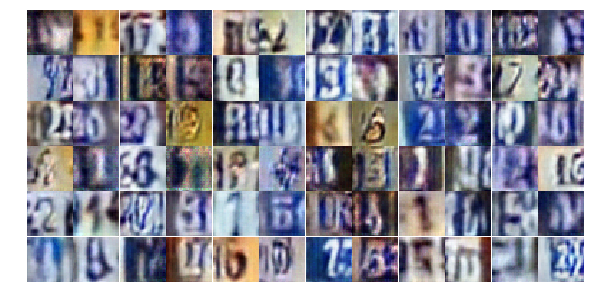

Epoch 9/25... Discriminator Loss: 0.8007... Generator Loss: 0.8374
Epoch 9/25... Discriminator Loss: 0.8611... Generator Loss: 0.7743
Epoch 9/25... Discriminator Loss: 0.5606... Generator Loss: 1.4810
Epoch 9/25... Discriminator Loss: 1.0376... Generator Loss: 0.8486
Epoch 9/25... Discriminator Loss: 0.4975... Generator Loss: 1.5204
Epoch 9/25... Discriminator Loss: 0.5978... Generator Loss: 1.2769
Epoch 9/25... Discriminator Loss: 1.0083... Generator Loss: 0.5966
Epoch 9/25... Discriminator Loss: 0.7087... Generator Loss: 0.8719
Epoch 9/25... Discriminator Loss: 0.8529... Generator Loss: 0.7563
Epoch 9/25... Discriminator Loss: 0.5983... Generator Loss: 1.0811


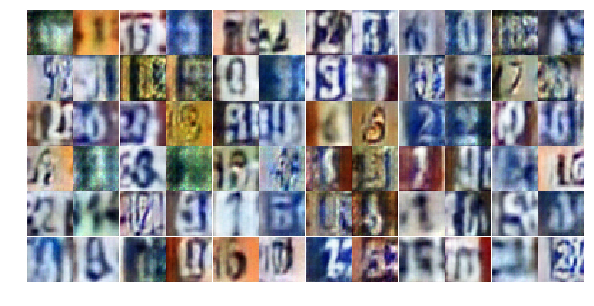

Epoch 9/25... Discriminator Loss: 1.0694... Generator Loss: 0.6176
Epoch 9/25... Discriminator Loss: 0.7397... Generator Loss: 0.9300
Epoch 9/25... Discriminator Loss: 0.5421... Generator Loss: 2.0404
Epoch 9/25... Discriminator Loss: 0.8045... Generator Loss: 1.0097
Epoch 9/25... Discriminator Loss: 0.6814... Generator Loss: 2.3778
Epoch 9/25... Discriminator Loss: 0.5177... Generator Loss: 1.3574
Epoch 9/25... Discriminator Loss: 0.9883... Generator Loss: 0.6477
Epoch 9/25... Discriminator Loss: 0.5462... Generator Loss: 1.5925
Epoch 9/25... Discriminator Loss: 0.4660... Generator Loss: 1.4100
Epoch 9/25... Discriminator Loss: 0.4149... Generator Loss: 1.4964


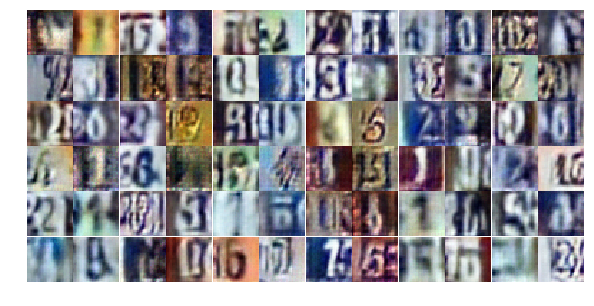

Epoch 9/25... Discriminator Loss: 0.4383... Generator Loss: 1.4666
Epoch 9/25... Discriminator Loss: 0.5656... Generator Loss: 1.0966
Epoch 9/25... Discriminator Loss: 1.6803... Generator Loss: 0.2938
Epoch 9/25... Discriminator Loss: 1.2245... Generator Loss: 0.5572
Epoch 9/25... Discriminator Loss: 0.7588... Generator Loss: 1.2393
Epoch 9/25... Discriminator Loss: 0.6151... Generator Loss: 1.4644
Epoch 9/25... Discriminator Loss: 0.7486... Generator Loss: 2.1090
Epoch 9/25... Discriminator Loss: 0.3702... Generator Loss: 1.6526
Epoch 9/25... Discriminator Loss: 0.7474... Generator Loss: 0.9309
Epoch 9/25... Discriminator Loss: 0.6970... Generator Loss: 0.9770


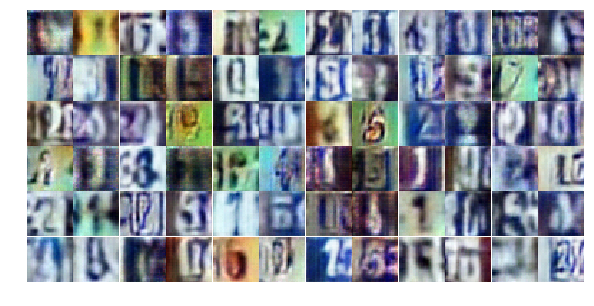

Epoch 9/25... Discriminator Loss: 0.4050... Generator Loss: 1.8785
Epoch 9/25... Discriminator Loss: 0.5655... Generator Loss: 1.1509
Epoch 9/25... Discriminator Loss: 1.7759... Generator Loss: 0.2960
Epoch 9/25... Discriminator Loss: 0.7285... Generator Loss: 1.8733
Epoch 9/25... Discriminator Loss: 0.5799... Generator Loss: 1.9214
Epoch 9/25... Discriminator Loss: 0.5618... Generator Loss: 1.2663
Epoch 9/25... Discriminator Loss: 0.7083... Generator Loss: 1.1088
Epoch 9/25... Discriminator Loss: 0.6441... Generator Loss: 1.0130
Epoch 9/25... Discriminator Loss: 0.5455... Generator Loss: 1.3094
Epoch 9/25... Discriminator Loss: 0.5405... Generator Loss: 2.5930


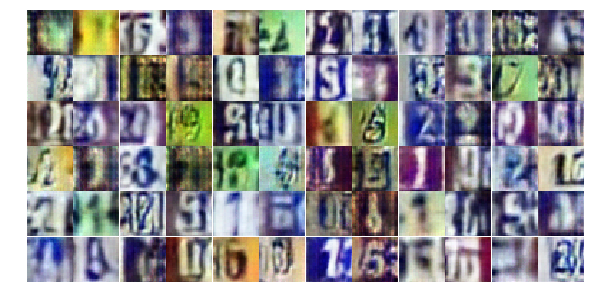

Epoch 9/25... Discriminator Loss: 1.0260... Generator Loss: 0.6013
Epoch 9/25... Discriminator Loss: 1.1260... Generator Loss: 2.7172
Epoch 9/25... Discriminator Loss: 0.7739... Generator Loss: 0.8385
Epoch 9/25... Discriminator Loss: 1.4952... Generator Loss: 0.3881
Epoch 9/25... Discriminator Loss: 0.7581... Generator Loss: 0.9321
Epoch 10/25... Discriminator Loss: 0.4078... Generator Loss: 1.5904
Epoch 10/25... Discriminator Loss: 0.5833... Generator Loss: 1.5654
Epoch 10/25... Discriminator Loss: 0.5968... Generator Loss: 1.0759
Epoch 10/25... Discriminator Loss: 0.8363... Generator Loss: 0.7404
Epoch 10/25... Discriminator Loss: 1.5172... Generator Loss: 0.3068


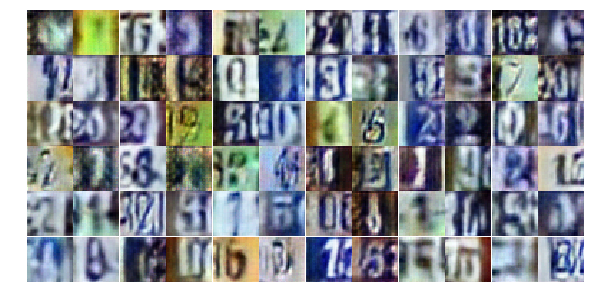

Epoch 10/25... Discriminator Loss: 0.9193... Generator Loss: 0.6926
Epoch 10/25... Discriminator Loss: 0.6823... Generator Loss: 1.0564
Epoch 10/25... Discriminator Loss: 0.6357... Generator Loss: 1.0516
Epoch 10/25... Discriminator Loss: 0.5100... Generator Loss: 1.4071
Epoch 10/25... Discriminator Loss: 0.5684... Generator Loss: 1.1969
Epoch 10/25... Discriminator Loss: 0.5091... Generator Loss: 1.6192
Epoch 10/25... Discriminator Loss: 0.5814... Generator Loss: 1.1863
Epoch 10/25... Discriminator Loss: 0.6254... Generator Loss: 1.2036
Epoch 10/25... Discriminator Loss: 0.9398... Generator Loss: 0.7780
Epoch 10/25... Discriminator Loss: 1.1479... Generator Loss: 0.5482


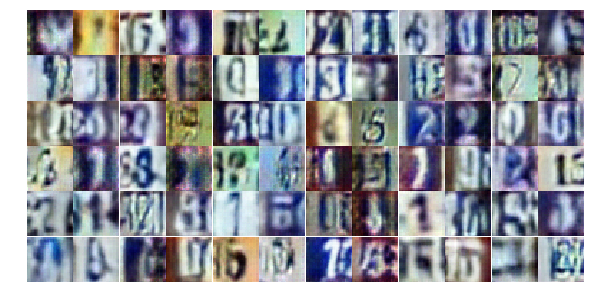

Epoch 10/25... Discriminator Loss: 0.4148... Generator Loss: 1.6031
Epoch 10/25... Discriminator Loss: 1.2032... Generator Loss: 0.4977
Epoch 10/25... Discriminator Loss: 0.6718... Generator Loss: 1.2363
Epoch 10/25... Discriminator Loss: 1.2994... Generator Loss: 0.4603
Epoch 10/25... Discriminator Loss: 0.6819... Generator Loss: 1.4064
Epoch 10/25... Discriminator Loss: 0.7739... Generator Loss: 0.8918
Epoch 10/25... Discriminator Loss: 0.5922... Generator Loss: 1.1161
Epoch 10/25... Discriminator Loss: 0.5129... Generator Loss: 1.1881
Epoch 10/25... Discriminator Loss: 0.7728... Generator Loss: 1.0318
Epoch 10/25... Discriminator Loss: 0.4440... Generator Loss: 2.2050


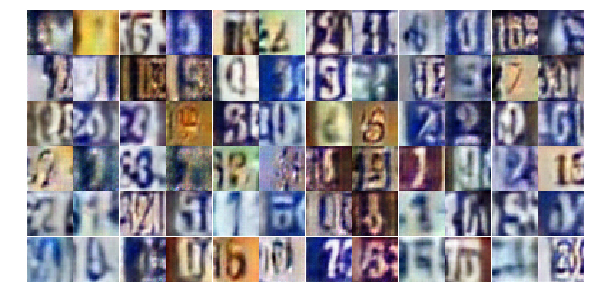

Epoch 10/25... Discriminator Loss: 1.2929... Generator Loss: 0.4437
Epoch 10/25... Discriminator Loss: 0.8080... Generator Loss: 0.8478
Epoch 10/25... Discriminator Loss: 0.3852... Generator Loss: 1.5187
Epoch 10/25... Discriminator Loss: 0.4664... Generator Loss: 2.0021
Epoch 10/25... Discriminator Loss: 1.4036... Generator Loss: 0.3736
Epoch 10/25... Discriminator Loss: 0.5195... Generator Loss: 1.3133
Epoch 10/25... Discriminator Loss: 0.3823... Generator Loss: 1.5442
Epoch 10/25... Discriminator Loss: 0.8687... Generator Loss: 0.9144
Epoch 10/25... Discriminator Loss: 0.9878... Generator Loss: 0.6305
Epoch 10/25... Discriminator Loss: 0.7550... Generator Loss: 3.2279


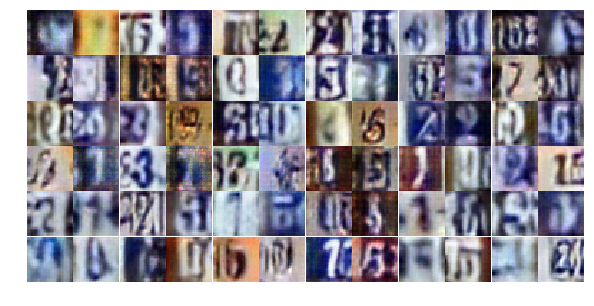

Epoch 10/25... Discriminator Loss: 0.7147... Generator Loss: 2.7859
Epoch 10/25... Discriminator Loss: 0.7758... Generator Loss: 0.9036
Epoch 10/25... Discriminator Loss: 0.7654... Generator Loss: 1.4776
Epoch 10/25... Discriminator Loss: 0.5471... Generator Loss: 2.0896
Epoch 10/25... Discriminator Loss: 0.7955... Generator Loss: 0.9268
Epoch 10/25... Discriminator Loss: 0.5473... Generator Loss: 1.2319
Epoch 10/25... Discriminator Loss: 0.6808... Generator Loss: 0.9791
Epoch 10/25... Discriminator Loss: 0.8227... Generator Loss: 0.7945
Epoch 10/25... Discriminator Loss: 0.4565... Generator Loss: 1.4961
Epoch 10/25... Discriminator Loss: 0.7108... Generator Loss: 0.9983


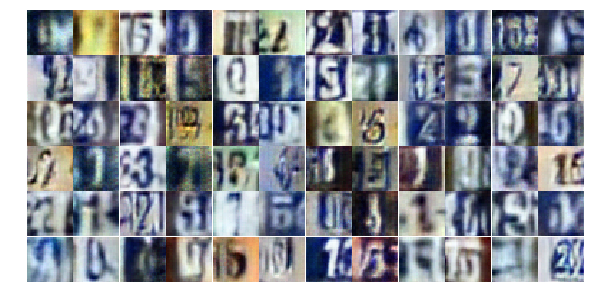

Epoch 10/25... Discriminator Loss: 0.3833... Generator Loss: 1.5656
Epoch 10/25... Discriminator Loss: 0.9768... Generator Loss: 0.7064
Epoch 10/25... Discriminator Loss: 0.9066... Generator Loss: 0.7054
Epoch 10/25... Discriminator Loss: 0.6113... Generator Loss: 1.1282
Epoch 10/25... Discriminator Loss: 0.3479... Generator Loss: 2.0215
Epoch 10/25... Discriminator Loss: 0.6284... Generator Loss: 1.0190
Epoch 10/25... Discriminator Loss: 0.5433... Generator Loss: 1.2143
Epoch 10/25... Discriminator Loss: 1.2053... Generator Loss: 1.9504
Epoch 10/25... Discriminator Loss: 1.1267... Generator Loss: 0.5743
Epoch 10/25... Discriminator Loss: 0.6223... Generator Loss: 1.4429


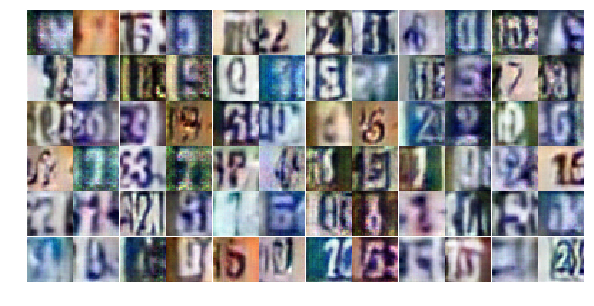

Epoch 10/25... Discriminator Loss: 0.6706... Generator Loss: 1.4415
Epoch 10/25... Discriminator Loss: 0.6323... Generator Loss: 1.1774
Epoch 10/25... Discriminator Loss: 0.5225... Generator Loss: 1.3259
Epoch 11/25... Discriminator Loss: 0.9248... Generator Loss: 0.8272
Epoch 11/25... Discriminator Loss: 0.7748... Generator Loss: 0.8891
Epoch 11/25... Discriminator Loss: 1.1962... Generator Loss: 0.5183
Epoch 11/25... Discriminator Loss: 0.7798... Generator Loss: 0.8838
Epoch 11/25... Discriminator Loss: 0.7957... Generator Loss: 0.9979
Epoch 11/25... Discriminator Loss: 1.7894... Generator Loss: 0.2411
Epoch 11/25... Discriminator Loss: 0.4280... Generator Loss: 1.7490


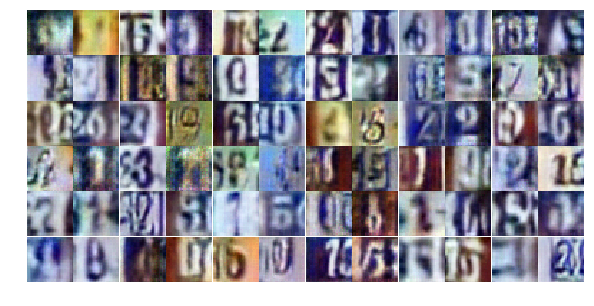

Epoch 11/25... Discriminator Loss: 0.4098... Generator Loss: 2.5540
Epoch 11/25... Discriminator Loss: 0.6318... Generator Loss: 1.1646
Epoch 11/25... Discriminator Loss: 0.5970... Generator Loss: 1.0893
Epoch 11/25... Discriminator Loss: 0.6917... Generator Loss: 1.1112
Epoch 11/25... Discriminator Loss: 0.7559... Generator Loss: 0.9322
Epoch 11/25... Discriminator Loss: 0.4185... Generator Loss: 1.5080
Epoch 11/25... Discriminator Loss: 0.5730... Generator Loss: 1.3442
Epoch 11/25... Discriminator Loss: 0.3171... Generator Loss: 2.6608
Epoch 11/25... Discriminator Loss: 1.1387... Generator Loss: 0.5664
Epoch 11/25... Discriminator Loss: 1.0917... Generator Loss: 0.6385


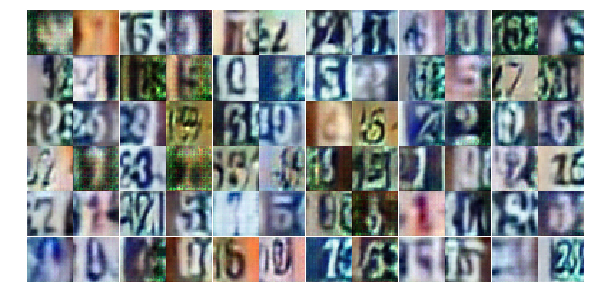

Epoch 11/25... Discriminator Loss: 0.6616... Generator Loss: 1.2057
Epoch 11/25... Discriminator Loss: 0.7198... Generator Loss: 1.4782
Epoch 11/25... Discriminator Loss: 0.8570... Generator Loss: 0.7654
Epoch 11/25... Discriminator Loss: 0.6000... Generator Loss: 1.1144
Epoch 11/25... Discriminator Loss: 0.3764... Generator Loss: 1.7472
Epoch 11/25... Discriminator Loss: 0.4148... Generator Loss: 1.7989
Epoch 11/25... Discriminator Loss: 0.5520... Generator Loss: 1.1716
Epoch 11/25... Discriminator Loss: 0.9543... Generator Loss: 0.7170
Epoch 11/25... Discriminator Loss: 0.3596... Generator Loss: 1.9696
Epoch 11/25... Discriminator Loss: 0.7582... Generator Loss: 0.8596


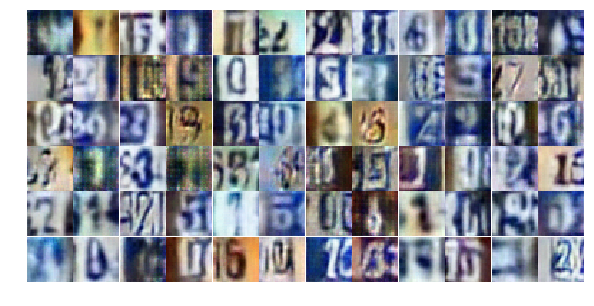

Epoch 11/25... Discriminator Loss: 0.6984... Generator Loss: 1.0114
Epoch 11/25... Discriminator Loss: 0.7085... Generator Loss: 0.9657
Epoch 11/25... Discriminator Loss: 0.7173... Generator Loss: 1.0341
Epoch 11/25... Discriminator Loss: 0.4476... Generator Loss: 1.5394
Epoch 11/25... Discriminator Loss: 0.8005... Generator Loss: 0.8219
Epoch 11/25... Discriminator Loss: 1.1463... Generator Loss: 0.4998
Epoch 11/25... Discriminator Loss: 1.1819... Generator Loss: 0.4891
Epoch 11/25... Discriminator Loss: 0.8874... Generator Loss: 0.7375
Epoch 11/25... Discriminator Loss: 0.4836... Generator Loss: 1.2917
Epoch 11/25... Discriminator Loss: 1.2937... Generator Loss: 0.4206


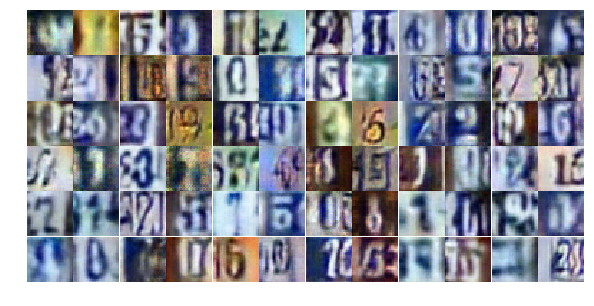

Epoch 11/25... Discriminator Loss: 0.5259... Generator Loss: 1.3626
Epoch 11/25... Discriminator Loss: 0.5341... Generator Loss: 1.2349
Epoch 11/25... Discriminator Loss: 0.7719... Generator Loss: 0.9460
Epoch 11/25... Discriminator Loss: 0.5636... Generator Loss: 1.3615
Epoch 11/25... Discriminator Loss: 0.6175... Generator Loss: 1.3642
Epoch 11/25... Discriminator Loss: 0.5043... Generator Loss: 1.3334
Epoch 11/25... Discriminator Loss: 0.3820... Generator Loss: 1.6273
Epoch 11/25... Discriminator Loss: 0.6199... Generator Loss: 1.1788
Epoch 11/25... Discriminator Loss: 1.2989... Generator Loss: 0.4783
Epoch 11/25... Discriminator Loss: 0.4323... Generator Loss: 1.5396


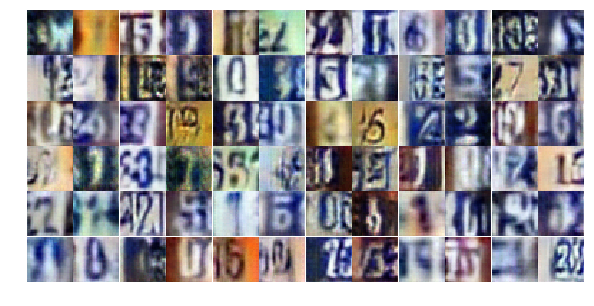

Epoch 11/25... Discriminator Loss: 0.9191... Generator Loss: 0.7104
Epoch 11/25... Discriminator Loss: 0.5763... Generator Loss: 1.2411
Epoch 11/25... Discriminator Loss: 0.5581... Generator Loss: 1.1978
Epoch 11/25... Discriminator Loss: 0.5102... Generator Loss: 1.2477
Epoch 11/25... Discriminator Loss: 1.6631... Generator Loss: 0.3778
Epoch 11/25... Discriminator Loss: 0.7258... Generator Loss: 1.0230
Epoch 11/25... Discriminator Loss: 0.9634... Generator Loss: 0.7228
Epoch 11/25... Discriminator Loss: 0.5501... Generator Loss: 1.5596
Epoch 11/25... Discriminator Loss: 1.2014... Generator Loss: 0.4747
Epoch 11/25... Discriminator Loss: 0.7168... Generator Loss: 0.9797


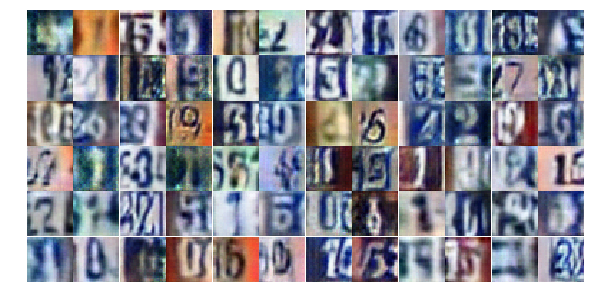

Epoch 12/25... Discriminator Loss: 0.6325... Generator Loss: 1.3816
Epoch 12/25... Discriminator Loss: 0.6188... Generator Loss: 1.6042
Epoch 12/25... Discriminator Loss: 0.9771... Generator Loss: 0.7009
Epoch 12/25... Discriminator Loss: 0.7210... Generator Loss: 1.0351
Epoch 12/25... Discriminator Loss: 0.4375... Generator Loss: 2.2267
Epoch 12/25... Discriminator Loss: 0.7369... Generator Loss: 0.9624
Epoch 12/25... Discriminator Loss: 0.4883... Generator Loss: 2.3146
Epoch 12/25... Discriminator Loss: 0.6292... Generator Loss: 1.1468
Epoch 12/25... Discriminator Loss: 0.5748... Generator Loss: 1.5568
Epoch 12/25... Discriminator Loss: 1.0892... Generator Loss: 0.5647


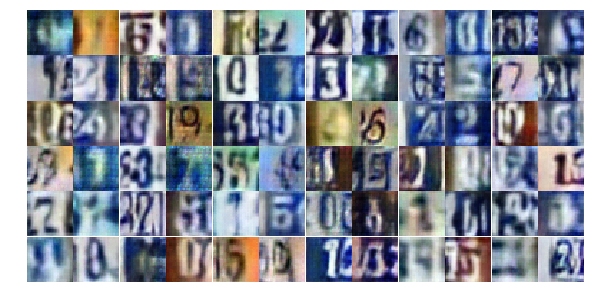

Epoch 12/25... Discriminator Loss: 0.4999... Generator Loss: 1.2661
Epoch 12/25... Discriminator Loss: 1.0108... Generator Loss: 0.6236
Epoch 12/25... Discriminator Loss: 0.4383... Generator Loss: 1.4552
Epoch 12/25... Discriminator Loss: 0.5798... Generator Loss: 1.3215
Epoch 12/25... Discriminator Loss: 0.4909... Generator Loss: 1.4485
Epoch 12/25... Discriminator Loss: 0.6507... Generator Loss: 1.3047
Epoch 12/25... Discriminator Loss: 1.3921... Generator Loss: 0.4224
Epoch 12/25... Discriminator Loss: 0.4562... Generator Loss: 2.0175
Epoch 12/25... Discriminator Loss: 0.4829... Generator Loss: 1.3991
Epoch 12/25... Discriminator Loss: 0.7756... Generator Loss: 0.9098


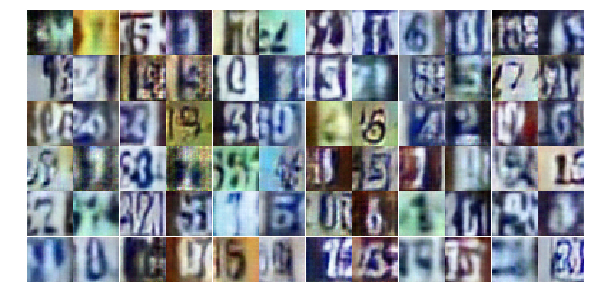

Epoch 12/25... Discriminator Loss: 0.4736... Generator Loss: 1.3205
Epoch 12/25... Discriminator Loss: 0.5125... Generator Loss: 1.6765
Epoch 12/25... Discriminator Loss: 0.5808... Generator Loss: 1.2279
Epoch 12/25... Discriminator Loss: 0.4192... Generator Loss: 1.5193
Epoch 12/25... Discriminator Loss: 0.4306... Generator Loss: 1.7259
Epoch 12/25... Discriminator Loss: 0.4148... Generator Loss: 1.4467
Epoch 12/25... Discriminator Loss: 1.0186... Generator Loss: 0.5906
Epoch 12/25... Discriminator Loss: 0.3703... Generator Loss: 1.6002
Epoch 12/25... Discriminator Loss: 0.5459... Generator Loss: 1.1627
Epoch 12/25... Discriminator Loss: 0.6371... Generator Loss: 1.3179


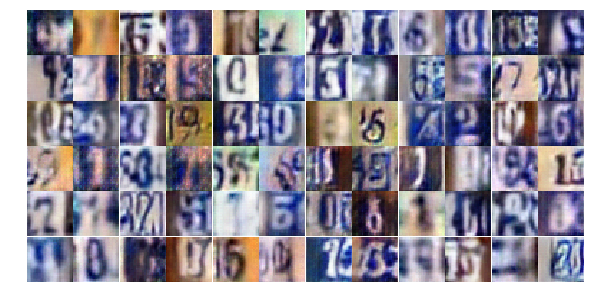

Epoch 12/25... Discriminator Loss: 0.5557... Generator Loss: 1.2274
Epoch 12/25... Discriminator Loss: 0.9527... Generator Loss: 0.7200
Epoch 12/25... Discriminator Loss: 0.7808... Generator Loss: 0.8517
Epoch 12/25... Discriminator Loss: 1.0748... Generator Loss: 0.7686
Epoch 12/25... Discriminator Loss: 0.5796... Generator Loss: 1.5777
Epoch 12/25... Discriminator Loss: 1.0417... Generator Loss: 0.6383
Epoch 12/25... Discriminator Loss: 1.2443... Generator Loss: 0.4987
Epoch 12/25... Discriminator Loss: 1.0904... Generator Loss: 0.6013
Epoch 12/25... Discriminator Loss: 0.8375... Generator Loss: 0.7415
Epoch 12/25... Discriminator Loss: 0.2705... Generator Loss: 2.5568


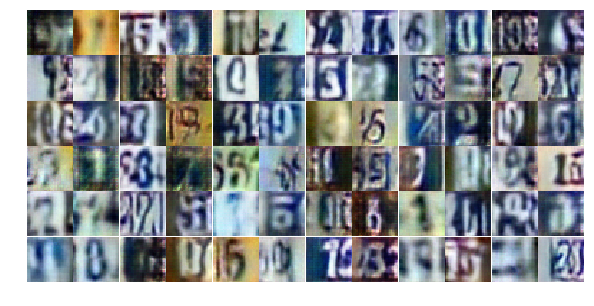

Epoch 12/25... Discriminator Loss: 0.5521... Generator Loss: 2.9091
Epoch 12/25... Discriminator Loss: 0.6272... Generator Loss: 2.5804
Epoch 12/25... Discriminator Loss: 0.4822... Generator Loss: 2.2873
Epoch 12/25... Discriminator Loss: 0.7451... Generator Loss: 1.5972
Epoch 12/25... Discriminator Loss: 0.8630... Generator Loss: 0.8701
Epoch 12/25... Discriminator Loss: 1.0539... Generator Loss: 0.6378
Epoch 12/25... Discriminator Loss: 1.0881... Generator Loss: 0.6133
Epoch 12/25... Discriminator Loss: 0.7865... Generator Loss: 0.8885
Epoch 12/25... Discriminator Loss: 0.4452... Generator Loss: 1.7878
Epoch 12/25... Discriminator Loss: 0.5644... Generator Loss: 1.2640


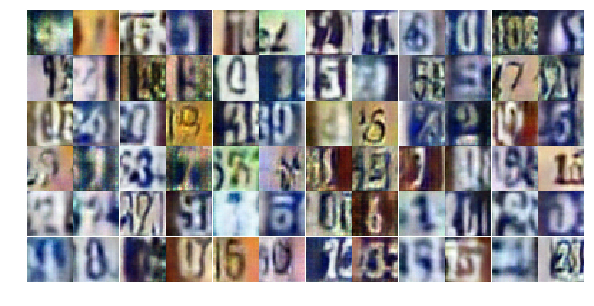

Epoch 12/25... Discriminator Loss: 1.1079... Generator Loss: 0.6231
Epoch 12/25... Discriminator Loss: 0.7766... Generator Loss: 0.9451
Epoch 12/25... Discriminator Loss: 0.6059... Generator Loss: 1.4965
Epoch 12/25... Discriminator Loss: 1.9036... Generator Loss: 0.2657
Epoch 12/25... Discriminator Loss: 0.7578... Generator Loss: 0.8425
Epoch 12/25... Discriminator Loss: 0.6240... Generator Loss: 1.8845
Epoch 12/25... Discriminator Loss: 0.7881... Generator Loss: 1.1841
Epoch 13/25... Discriminator Loss: 0.4293... Generator Loss: 2.1714
Epoch 13/25... Discriminator Loss: 0.5362... Generator Loss: 1.2571
Epoch 13/25... Discriminator Loss: 0.7299... Generator Loss: 1.1636


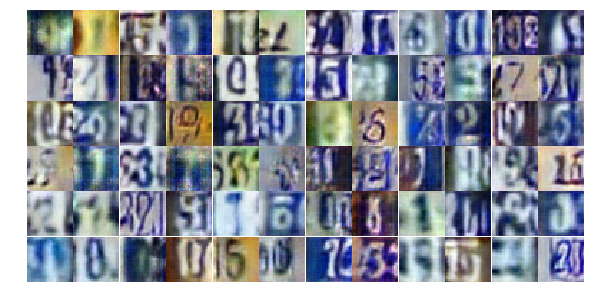

Epoch 13/25... Discriminator Loss: 0.5186... Generator Loss: 1.2057
Epoch 13/25... Discriminator Loss: 0.5281... Generator Loss: 2.0624
Epoch 13/25... Discriminator Loss: 0.9946... Generator Loss: 0.8787
Epoch 13/25... Discriminator Loss: 0.9245... Generator Loss: 0.7373
Epoch 13/25... Discriminator Loss: 0.6198... Generator Loss: 1.1156
Epoch 13/25... Discriminator Loss: 0.6056... Generator Loss: 1.1769
Epoch 13/25... Discriminator Loss: 0.5003... Generator Loss: 1.3826
Epoch 13/25... Discriminator Loss: 1.1591... Generator Loss: 0.5591
Epoch 13/25... Discriminator Loss: 0.4722... Generator Loss: 1.7042
Epoch 13/25... Discriminator Loss: 0.4524... Generator Loss: 2.1108


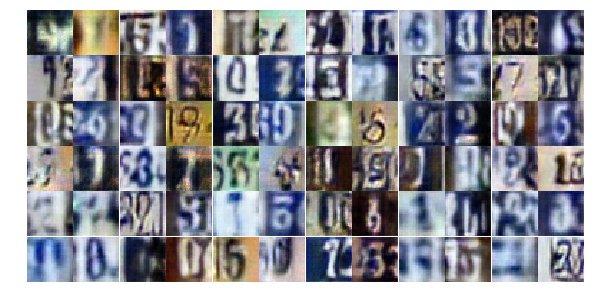

Epoch 13/25... Discriminator Loss: 2.4798... Generator Loss: 4.5290
Epoch 13/25... Discriminator Loss: 0.7761... Generator Loss: 0.9189
Epoch 13/25... Discriminator Loss: 0.8149... Generator Loss: 0.8609
Epoch 13/25... Discriminator Loss: 0.6606... Generator Loss: 1.0732
Epoch 13/25... Discriminator Loss: 0.5535... Generator Loss: 2.1865
Epoch 13/25... Discriminator Loss: 0.9433... Generator Loss: 0.7152
Epoch 13/25... Discriminator Loss: 0.5252... Generator Loss: 1.3361
Epoch 13/25... Discriminator Loss: 1.1551... Generator Loss: 0.6126
Epoch 13/25... Discriminator Loss: 0.6186... Generator Loss: 1.0530
Epoch 13/25... Discriminator Loss: 0.7925... Generator Loss: 0.8587


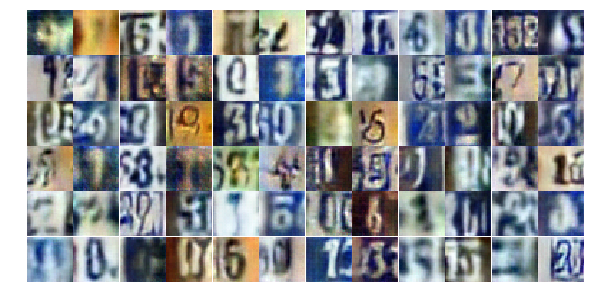

Epoch 13/25... Discriminator Loss: 0.8660... Generator Loss: 0.7713
Epoch 13/25... Discriminator Loss: 0.9345... Generator Loss: 0.7113
Epoch 13/25... Discriminator Loss: 0.4823... Generator Loss: 1.5681
Epoch 13/25... Discriminator Loss: 0.5499... Generator Loss: 1.2448
Epoch 13/25... Discriminator Loss: 0.7196... Generator Loss: 0.8994
Epoch 13/25... Discriminator Loss: 0.7286... Generator Loss: 0.9787
Epoch 13/25... Discriminator Loss: 0.7671... Generator Loss: 1.4748
Epoch 13/25... Discriminator Loss: 0.4439... Generator Loss: 1.3668
Epoch 13/25... Discriminator Loss: 0.4879... Generator Loss: 1.5475
Epoch 13/25... Discriminator Loss: 0.5430... Generator Loss: 1.7457


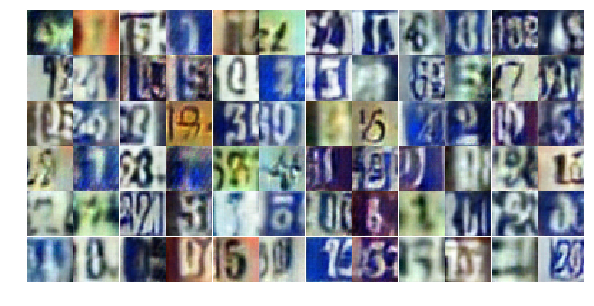

Epoch 13/25... Discriminator Loss: 0.7991... Generator Loss: 0.8318
Epoch 13/25... Discriminator Loss: 0.6411... Generator Loss: 1.1380
Epoch 13/25... Discriminator Loss: 1.2076... Generator Loss: 0.4886
Epoch 13/25... Discriminator Loss: 1.7048... Generator Loss: 0.2760
Epoch 13/25... Discriminator Loss: 0.8287... Generator Loss: 0.9280
Epoch 13/25... Discriminator Loss: 0.3968... Generator Loss: 1.7641
Epoch 13/25... Discriminator Loss: 0.4511... Generator Loss: 1.3851
Epoch 13/25... Discriminator Loss: 0.5864... Generator Loss: 1.4121
Epoch 13/25... Discriminator Loss: 0.5532... Generator Loss: 1.7966
Epoch 13/25... Discriminator Loss: 0.7724... Generator Loss: 0.8074


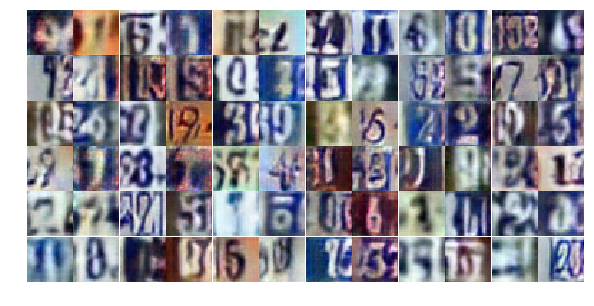

Epoch 13/25... Discriminator Loss: 0.3705... Generator Loss: 1.6933
Epoch 13/25... Discriminator Loss: 0.6586... Generator Loss: 1.2943
Epoch 13/25... Discriminator Loss: 0.5585... Generator Loss: 1.2627
Epoch 13/25... Discriminator Loss: 1.5198... Generator Loss: 0.3853
Epoch 13/25... Discriminator Loss: 1.0511... Generator Loss: 0.7891
Epoch 13/25... Discriminator Loss: 0.6067... Generator Loss: 1.2067
Epoch 13/25... Discriminator Loss: 0.6586... Generator Loss: 1.0683
Epoch 13/25... Discriminator Loss: 0.6241... Generator Loss: 1.0342
Epoch 13/25... Discriminator Loss: 0.7926... Generator Loss: 0.8507
Epoch 13/25... Discriminator Loss: 1.1758... Generator Loss: 0.5755


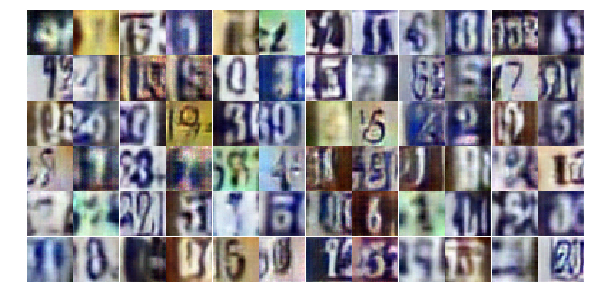

Epoch 13/25... Discriminator Loss: 0.3472... Generator Loss: 1.9067
Epoch 13/25... Discriminator Loss: 1.3120... Generator Loss: 0.4329
Epoch 13/25... Discriminator Loss: 0.7921... Generator Loss: 0.8477
Epoch 13/25... Discriminator Loss: 0.8089... Generator Loss: 0.8354
Epoch 14/25... Discriminator Loss: 0.8342... Generator Loss: 0.7169
Epoch 14/25... Discriminator Loss: 0.7027... Generator Loss: 1.1789
Epoch 14/25... Discriminator Loss: 0.9077... Generator Loss: 0.7967
Epoch 14/25... Discriminator Loss: 0.4953... Generator Loss: 1.4892
Epoch 14/25... Discriminator Loss: 0.6759... Generator Loss: 1.0119
Epoch 14/25... Discriminator Loss: 0.6861... Generator Loss: 0.9697


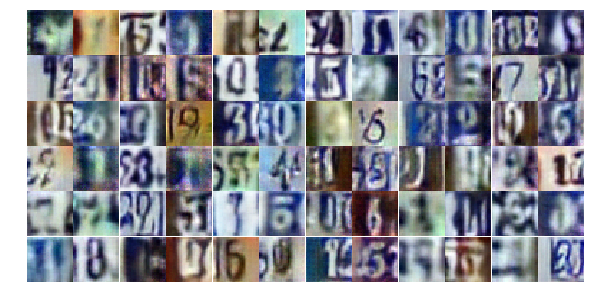

Epoch 14/25... Discriminator Loss: 1.1377... Generator Loss: 2.8505
Epoch 14/25... Discriminator Loss: 1.3679... Generator Loss: 0.4109
Epoch 14/25... Discriminator Loss: 0.5805... Generator Loss: 1.2535
Epoch 14/25... Discriminator Loss: 0.7581... Generator Loss: 0.9607
Epoch 14/25... Discriminator Loss: 1.2440... Generator Loss: 0.4785
Epoch 14/25... Discriminator Loss: 0.5056... Generator Loss: 1.1555
Epoch 14/25... Discriminator Loss: 0.4519... Generator Loss: 1.5647
Epoch 14/25... Discriminator Loss: 1.2991... Generator Loss: 0.4853
Epoch 14/25... Discriminator Loss: 1.6934... Generator Loss: 0.2982
Epoch 14/25... Discriminator Loss: 1.2584... Generator Loss: 0.4482


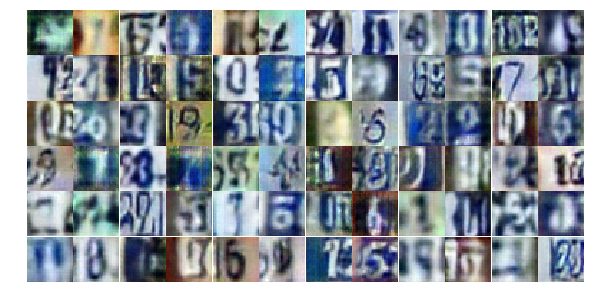

Epoch 14/25... Discriminator Loss: 0.5619... Generator Loss: 1.1682
Epoch 14/25... Discriminator Loss: 1.0124... Generator Loss: 3.0282
Epoch 14/25... Discriminator Loss: 0.8134... Generator Loss: 2.0744
Epoch 14/25... Discriminator Loss: 0.4240... Generator Loss: 1.7405
Epoch 14/25... Discriminator Loss: 1.0291... Generator Loss: 0.6066
Epoch 14/25... Discriminator Loss: 0.6492... Generator Loss: 1.0615
Epoch 14/25... Discriminator Loss: 0.8438... Generator Loss: 0.8311
Epoch 14/25... Discriminator Loss: 0.5642... Generator Loss: 1.1451
Epoch 14/25... Discriminator Loss: 0.6832... Generator Loss: 0.9852
Epoch 14/25... Discriminator Loss: 0.3802... Generator Loss: 2.0009


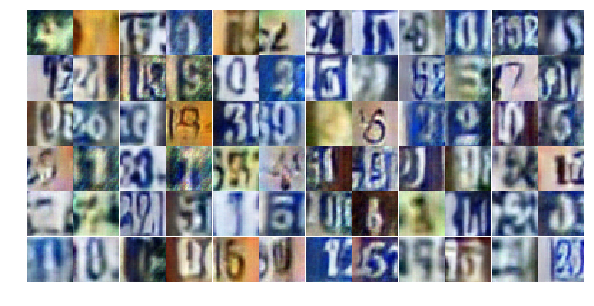

Epoch 14/25... Discriminator Loss: 1.2834... Generator Loss: 0.4740
Epoch 14/25... Discriminator Loss: 0.3561... Generator Loss: 1.5874
Epoch 14/25... Discriminator Loss: 0.3651... Generator Loss: 1.7454
Epoch 14/25... Discriminator Loss: 0.3829... Generator Loss: 1.7267
Epoch 14/25... Discriminator Loss: 0.5873... Generator Loss: 1.2278
Epoch 14/25... Discriminator Loss: 0.6135... Generator Loss: 1.0617
Epoch 14/25... Discriminator Loss: 0.8409... Generator Loss: 0.7869
Epoch 14/25... Discriminator Loss: 0.3436... Generator Loss: 1.9297
Epoch 14/25... Discriminator Loss: 0.3462... Generator Loss: 2.6771
Epoch 14/25... Discriminator Loss: 0.8022... Generator Loss: 1.0546


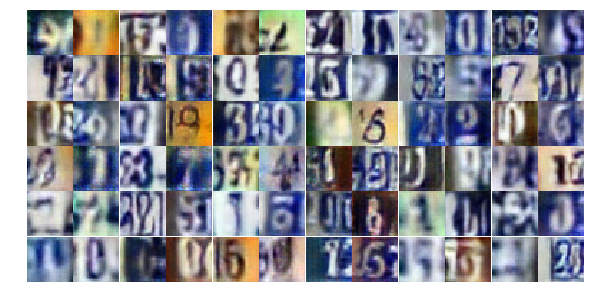

Epoch 14/25... Discriminator Loss: 1.4547... Generator Loss: 0.3827
Epoch 14/25... Discriminator Loss: 0.7418... Generator Loss: 1.2894
Epoch 14/25... Discriminator Loss: 0.9290... Generator Loss: 0.7086
Epoch 14/25... Discriminator Loss: 1.3181... Generator Loss: 0.4069
Epoch 14/25... Discriminator Loss: 1.0230... Generator Loss: 0.6307
Epoch 14/25... Discriminator Loss: 0.5189... Generator Loss: 1.3268
Epoch 14/25... Discriminator Loss: 0.7952... Generator Loss: 0.8399
Epoch 14/25... Discriminator Loss: 0.8065... Generator Loss: 2.0780
Epoch 14/25... Discriminator Loss: 1.3541... Generator Loss: 0.4775
Epoch 14/25... Discriminator Loss: 0.7484... Generator Loss: 1.3993


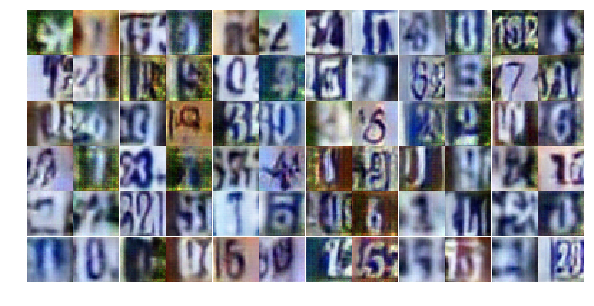

Epoch 14/25... Discriminator Loss: 1.1555... Generator Loss: 0.5601
Epoch 14/25... Discriminator Loss: 1.2231... Generator Loss: 0.5404
Epoch 14/25... Discriminator Loss: 0.4997... Generator Loss: 1.5315
Epoch 14/25... Discriminator Loss: 1.2419... Generator Loss: 0.5000
Epoch 14/25... Discriminator Loss: 0.4982... Generator Loss: 1.2862
Epoch 14/25... Discriminator Loss: 0.6082... Generator Loss: 1.3138
Epoch 14/25... Discriminator Loss: 0.5764... Generator Loss: 1.6495
Epoch 14/25... Discriminator Loss: 0.7622... Generator Loss: 0.9466
Epoch 14/25... Discriminator Loss: 0.7998... Generator Loss: 0.8269
Epoch 14/25... Discriminator Loss: 1.0007... Generator Loss: 0.6728


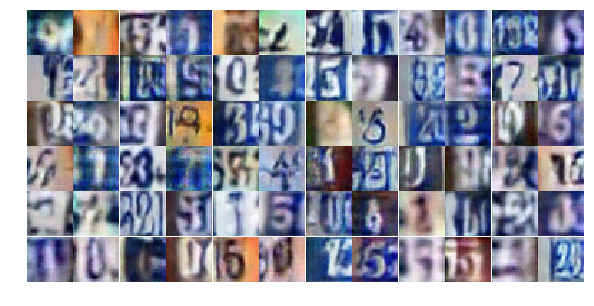

Epoch 14/25... Discriminator Loss: 0.6846... Generator Loss: 1.3544
Epoch 14/25... Discriminator Loss: 0.8684... Generator Loss: 0.8680
Epoch 15/25... Discriminator Loss: 0.7578... Generator Loss: 0.9972
Epoch 15/25... Discriminator Loss: 0.5538... Generator Loss: 1.4434
Epoch 15/25... Discriminator Loss: 0.5601... Generator Loss: 1.2916
Epoch 15/25... Discriminator Loss: 0.5994... Generator Loss: 1.1523
Epoch 15/25... Discriminator Loss: 1.4452... Generator Loss: 0.3996
Epoch 15/25... Discriminator Loss: 0.7257... Generator Loss: 0.9310
Epoch 15/25... Discriminator Loss: 1.0505... Generator Loss: 0.6115
Epoch 15/25... Discriminator Loss: 0.6683... Generator Loss: 1.0117


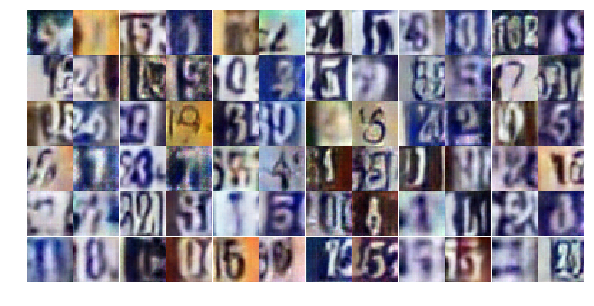

Epoch 15/25... Discriminator Loss: 0.8596... Generator Loss: 0.7399
Epoch 15/25... Discriminator Loss: 0.8831... Generator Loss: 2.0018
Epoch 15/25... Discriminator Loss: 1.0388... Generator Loss: 0.6077
Epoch 15/25... Discriminator Loss: 0.7513... Generator Loss: 0.9509
Epoch 15/25... Discriminator Loss: 0.6657... Generator Loss: 1.1011
Epoch 15/25... Discriminator Loss: 0.4256... Generator Loss: 1.8346
Epoch 15/25... Discriminator Loss: 1.2013... Generator Loss: 0.5004
Epoch 15/25... Discriminator Loss: 0.7622... Generator Loss: 2.6466
Epoch 15/25... Discriminator Loss: 1.3668... Generator Loss: 3.0793
Epoch 15/25... Discriminator Loss: 1.0405... Generator Loss: 0.6662


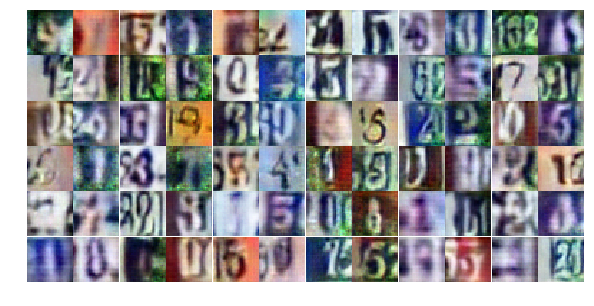

Epoch 15/25... Discriminator Loss: 0.7977... Generator Loss: 0.9525
Epoch 15/25... Discriminator Loss: 0.5780... Generator Loss: 1.1709
Epoch 15/25... Discriminator Loss: 0.5203... Generator Loss: 1.3996
Epoch 15/25... Discriminator Loss: 0.9000... Generator Loss: 0.7682
Epoch 15/25... Discriminator Loss: 0.9223... Generator Loss: 0.8505
Epoch 15/25... Discriminator Loss: 0.6371... Generator Loss: 1.1253
Epoch 15/25... Discriminator Loss: 1.0356... Generator Loss: 0.7152
Epoch 15/25... Discriminator Loss: 1.2432... Generator Loss: 0.4621
Epoch 15/25... Discriminator Loss: 0.5087... Generator Loss: 1.7739
Epoch 15/25... Discriminator Loss: 1.2638... Generator Loss: 0.5606


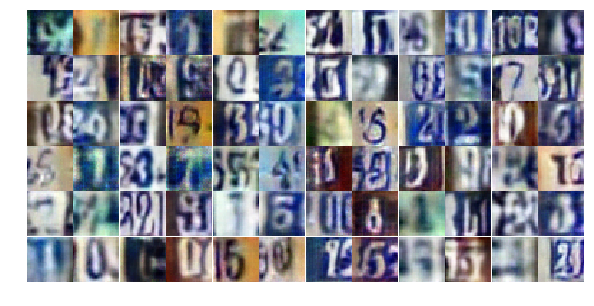

Epoch 15/25... Discriminator Loss: 0.7634... Generator Loss: 0.9271
Epoch 15/25... Discriminator Loss: 1.3100... Generator Loss: 0.5960
Epoch 15/25... Discriminator Loss: 0.3543... Generator Loss: 1.7052
Epoch 15/25... Discriminator Loss: 0.6256... Generator Loss: 1.2973
Epoch 15/25... Discriminator Loss: 0.5488... Generator Loss: 1.2046
Epoch 15/25... Discriminator Loss: 1.0189... Generator Loss: 3.3606
Epoch 15/25... Discriminator Loss: 0.3944... Generator Loss: 1.9826
Epoch 15/25... Discriminator Loss: 0.5929... Generator Loss: 1.5355
Epoch 15/25... Discriminator Loss: 0.5708... Generator Loss: 1.0940
Epoch 15/25... Discriminator Loss: 0.7267... Generator Loss: 1.0063


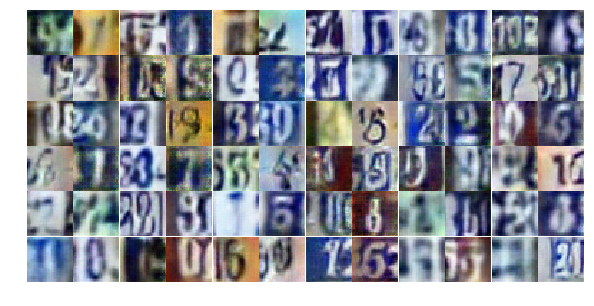

Epoch 15/25... Discriminator Loss: 0.7877... Generator Loss: 0.8488
Epoch 15/25... Discriminator Loss: 1.6217... Generator Loss: 0.3034
Epoch 15/25... Discriminator Loss: 0.5942... Generator Loss: 1.1857
Epoch 15/25... Discriminator Loss: 0.4806... Generator Loss: 1.3241
Epoch 15/25... Discriminator Loss: 0.4678... Generator Loss: 1.3472
Epoch 15/25... Discriminator Loss: 2.1981... Generator Loss: 0.2019
Epoch 15/25... Discriminator Loss: 0.5521... Generator Loss: 1.2599
Epoch 15/25... Discriminator Loss: 0.6851... Generator Loss: 1.6569
Epoch 15/25... Discriminator Loss: 0.7286... Generator Loss: 0.9229
Epoch 15/25... Discriminator Loss: 0.7202... Generator Loss: 1.3336


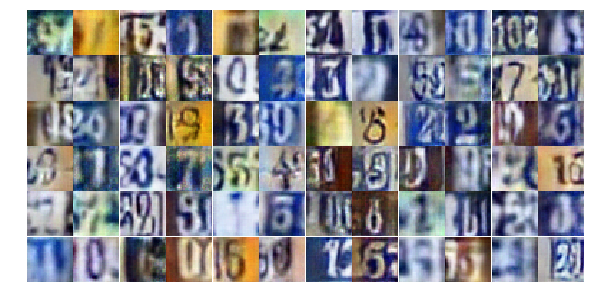

Epoch 15/25... Discriminator Loss: 0.7917... Generator Loss: 0.8418
Epoch 15/25... Discriminator Loss: 0.7295... Generator Loss: 1.1790
Epoch 15/25... Discriminator Loss: 0.5207... Generator Loss: 1.2494
Epoch 15/25... Discriminator Loss: 0.9807... Generator Loss: 0.6343
Epoch 15/25... Discriminator Loss: 0.3642... Generator Loss: 1.7188
Epoch 15/25... Discriminator Loss: 0.8442... Generator Loss: 0.8539
Epoch 15/25... Discriminator Loss: 0.9640... Generator Loss: 0.7220
Epoch 15/25... Discriminator Loss: 0.5088... Generator Loss: 1.3592
Epoch 15/25... Discriminator Loss: 1.2668... Generator Loss: 0.4393
Epoch 16/25... Discriminator Loss: 2.7023... Generator Loss: 0.1106


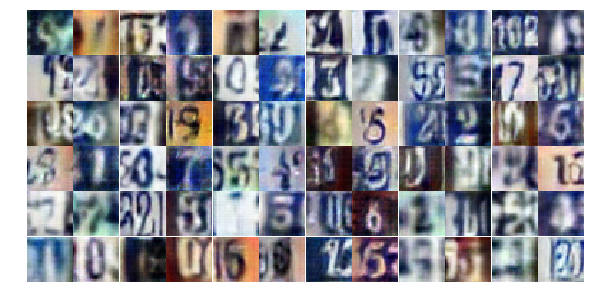

Epoch 16/25... Discriminator Loss: 0.8724... Generator Loss: 1.0921
Epoch 16/25... Discriminator Loss: 0.8421... Generator Loss: 0.7988
Epoch 16/25... Discriminator Loss: 0.9562... Generator Loss: 0.8172
Epoch 16/25... Discriminator Loss: 0.7096... Generator Loss: 1.2047
Epoch 16/25... Discriminator Loss: 0.6339... Generator Loss: 2.3375
Epoch 16/25... Discriminator Loss: 0.6788... Generator Loss: 1.1447
Epoch 16/25... Discriminator Loss: 1.6420... Generator Loss: 0.3174
Epoch 16/25... Discriminator Loss: 0.8173... Generator Loss: 0.8537
Epoch 16/25... Discriminator Loss: 0.4631... Generator Loss: 1.4514
Epoch 16/25... Discriminator Loss: 0.5146... Generator Loss: 1.2939


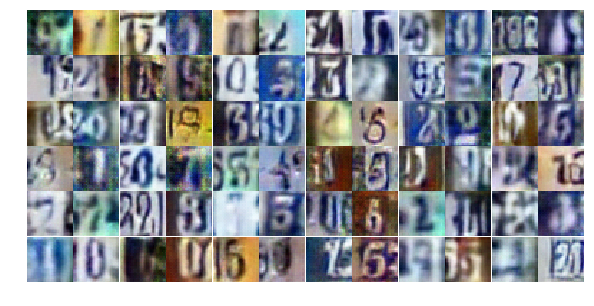

Epoch 16/25... Discriminator Loss: 1.2708... Generator Loss: 0.5105
Epoch 16/25... Discriminator Loss: 0.6473... Generator Loss: 1.1332
Epoch 16/25... Discriminator Loss: 0.7892... Generator Loss: 0.9357
Epoch 16/25... Discriminator Loss: 1.0827... Generator Loss: 0.5486
Epoch 16/25... Discriminator Loss: 0.5852... Generator Loss: 1.1651
Epoch 16/25... Discriminator Loss: 0.7857... Generator Loss: 0.8221
Epoch 16/25... Discriminator Loss: 1.2846... Generator Loss: 0.4811
Epoch 16/25... Discriminator Loss: 0.5053... Generator Loss: 1.5301
Epoch 16/25... Discriminator Loss: 0.4924... Generator Loss: 1.3470
Epoch 16/25... Discriminator Loss: 0.6546... Generator Loss: 1.2141


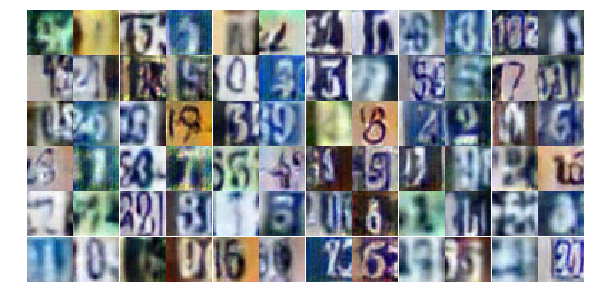

Epoch 16/25... Discriminator Loss: 0.6101... Generator Loss: 1.1761
Epoch 16/25... Discriminator Loss: 0.7747... Generator Loss: 0.8735
Epoch 16/25... Discriminator Loss: 0.5361... Generator Loss: 1.2583
Epoch 16/25... Discriminator Loss: 0.9493... Generator Loss: 0.6724
Epoch 16/25... Discriminator Loss: 0.8498... Generator Loss: 0.8598
Epoch 16/25... Discriminator Loss: 0.7405... Generator Loss: 1.0686
Epoch 16/25... Discriminator Loss: 1.1859... Generator Loss: 0.4999
Epoch 16/25... Discriminator Loss: 0.6571... Generator Loss: 1.1032
Epoch 16/25... Discriminator Loss: 0.8638... Generator Loss: 0.8361
Epoch 16/25... Discriminator Loss: 0.6741... Generator Loss: 1.0389


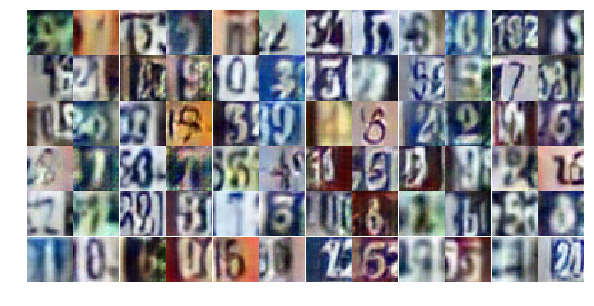

Epoch 16/25... Discriminator Loss: 0.6547... Generator Loss: 1.0132
Epoch 16/25... Discriminator Loss: 0.5616... Generator Loss: 1.1539
Epoch 16/25... Discriminator Loss: 1.0751... Generator Loss: 0.5977
Epoch 16/25... Discriminator Loss: 1.3254... Generator Loss: 0.5742
Epoch 16/25... Discriminator Loss: 0.9747... Generator Loss: 0.7498
Epoch 16/25... Discriminator Loss: 0.7561... Generator Loss: 2.0895
Epoch 16/25... Discriminator Loss: 1.2411... Generator Loss: 0.5139
Epoch 16/25... Discriminator Loss: 1.3965... Generator Loss: 0.4240
Epoch 16/25... Discriminator Loss: 0.7777... Generator Loss: 0.8300
Epoch 16/25... Discriminator Loss: 0.5782... Generator Loss: 1.2039


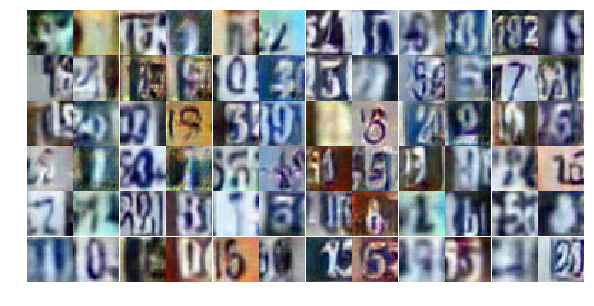

Epoch 16/25... Discriminator Loss: 0.5687... Generator Loss: 1.2695
Epoch 16/25... Discriminator Loss: 0.5955... Generator Loss: 1.1881
Epoch 16/25... Discriminator Loss: 1.0127... Generator Loss: 0.7302
Epoch 16/25... Discriminator Loss: 1.0832... Generator Loss: 0.7490
Epoch 16/25... Discriminator Loss: 0.8634... Generator Loss: 0.8412
Epoch 16/25... Discriminator Loss: 0.8566... Generator Loss: 0.8970
Epoch 16/25... Discriminator Loss: 0.6068... Generator Loss: 1.0927
Epoch 16/25... Discriminator Loss: 0.8132... Generator Loss: 1.1773
Epoch 16/25... Discriminator Loss: 0.5115... Generator Loss: 1.3677
Epoch 16/25... Discriminator Loss: 0.7066... Generator Loss: 0.9832


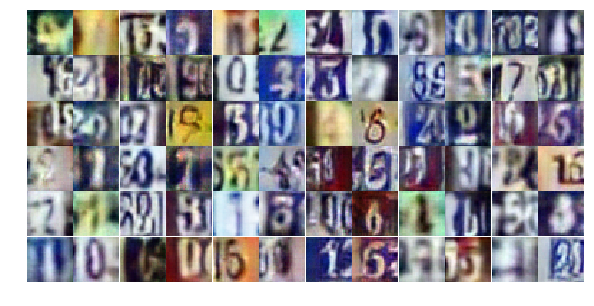

Epoch 16/25... Discriminator Loss: 1.2692... Generator Loss: 0.4635
Epoch 16/25... Discriminator Loss: 0.6382... Generator Loss: 1.0702
Epoch 16/25... Discriminator Loss: 1.3632... Generator Loss: 0.4325
Epoch 16/25... Discriminator Loss: 0.4795... Generator Loss: 1.5187
Epoch 16/25... Discriminator Loss: 0.8022... Generator Loss: 0.8603
Epoch 16/25... Discriminator Loss: 1.2361... Generator Loss: 1.5091
Epoch 17/25... Discriminator Loss: 0.7683... Generator Loss: 0.8646
Epoch 17/25... Discriminator Loss: 0.7089... Generator Loss: 1.0781
Epoch 17/25... Discriminator Loss: 0.6491... Generator Loss: 1.1129
Epoch 17/25... Discriminator Loss: 0.7693... Generator Loss: 0.9030


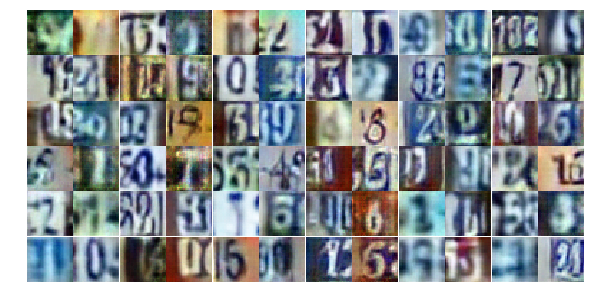

Epoch 17/25... Discriminator Loss: 0.5067... Generator Loss: 1.4562
Epoch 17/25... Discriminator Loss: 0.6629... Generator Loss: 1.0512
Epoch 17/25... Discriminator Loss: 0.8049... Generator Loss: 0.8438
Epoch 17/25... Discriminator Loss: 0.6349... Generator Loss: 1.1584
Epoch 17/25... Discriminator Loss: 1.3359... Generator Loss: 0.4607
Epoch 17/25... Discriminator Loss: 0.5910... Generator Loss: 1.3482
Epoch 17/25... Discriminator Loss: 0.6540... Generator Loss: 1.5187
Epoch 17/25... Discriminator Loss: 0.5435... Generator Loss: 1.1961
Epoch 17/25... Discriminator Loss: 0.3786... Generator Loss: 1.6867
Epoch 17/25... Discriminator Loss: 0.5877... Generator Loss: 1.5377


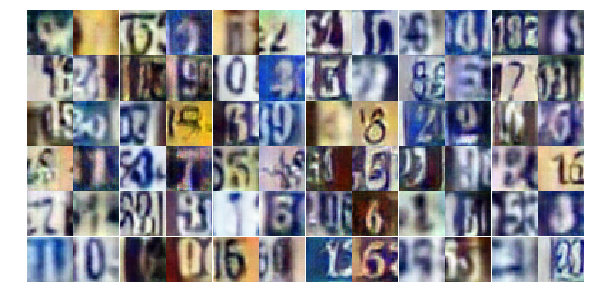

Epoch 17/25... Discriminator Loss: 0.8984... Generator Loss: 0.7908
Epoch 17/25... Discriminator Loss: 1.1627... Generator Loss: 3.5051
Epoch 17/25... Discriminator Loss: 1.1028... Generator Loss: 0.6854
Epoch 17/25... Discriminator Loss: 0.7840... Generator Loss: 1.0063
Epoch 17/25... Discriminator Loss: 0.6083... Generator Loss: 1.2162
Epoch 17/25... Discriminator Loss: 0.8652... Generator Loss: 0.8957
Epoch 17/25... Discriminator Loss: 0.5737... Generator Loss: 1.2351
Epoch 17/25... Discriminator Loss: 0.5203... Generator Loss: 1.3333
Epoch 17/25... Discriminator Loss: 0.6497... Generator Loss: 1.0454
Epoch 17/25... Discriminator Loss: 0.4543... Generator Loss: 1.4208


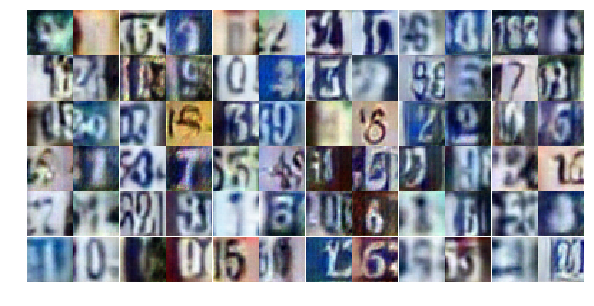

Epoch 17/25... Discriminator Loss: 1.5262... Generator Loss: 0.3955
Epoch 17/25... Discriminator Loss: 0.4921... Generator Loss: 1.6010
Epoch 17/25... Discriminator Loss: 0.5350... Generator Loss: 1.4541
Epoch 17/25... Discriminator Loss: 0.9912... Generator Loss: 0.6477
Epoch 17/25... Discriminator Loss: 1.6190... Generator Loss: 0.3443
Epoch 17/25... Discriminator Loss: 0.4265... Generator Loss: 1.4796
Epoch 17/25... Discriminator Loss: 0.8500... Generator Loss: 0.7764
Epoch 17/25... Discriminator Loss: 0.9579... Generator Loss: 0.6757
Epoch 17/25... Discriminator Loss: 0.8566... Generator Loss: 0.7792
Epoch 17/25... Discriminator Loss: 0.3190... Generator Loss: 1.9499


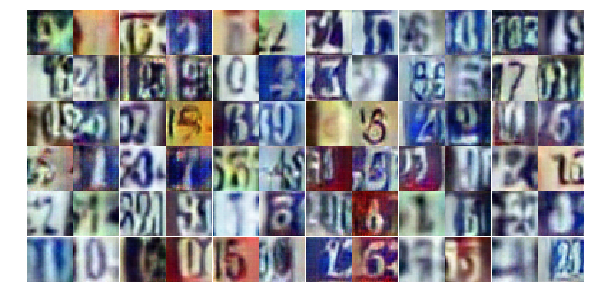

Epoch 17/25... Discriminator Loss: 0.7165... Generator Loss: 1.1192
Epoch 17/25... Discriminator Loss: 2.0545... Generator Loss: 0.2082
Epoch 17/25... Discriminator Loss: 0.6936... Generator Loss: 1.1900
Epoch 17/25... Discriminator Loss: 0.8117... Generator Loss: 0.9645
Epoch 17/25... Discriminator Loss: 0.8702... Generator Loss: 0.7389
Epoch 17/25... Discriminator Loss: 0.7996... Generator Loss: 0.8807
Epoch 17/25... Discriminator Loss: 0.8739... Generator Loss: 0.8959
Epoch 17/25... Discriminator Loss: 0.7035... Generator Loss: 0.9534
Epoch 17/25... Discriminator Loss: 0.3638... Generator Loss: 1.7210
Epoch 17/25... Discriminator Loss: 0.8146... Generator Loss: 0.7757


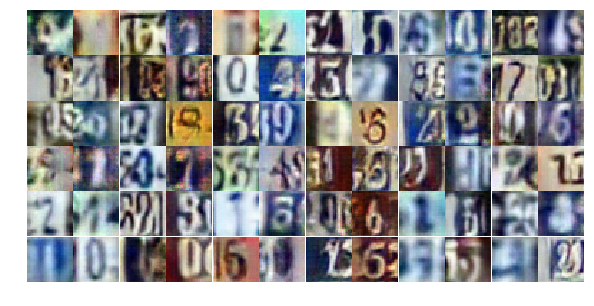

Epoch 17/25... Discriminator Loss: 2.0845... Generator Loss: 3.1023
Epoch 17/25... Discriminator Loss: 0.4013... Generator Loss: 3.4193
Epoch 17/25... Discriminator Loss: 1.0003... Generator Loss: 0.7339
Epoch 17/25... Discriminator Loss: 0.4852... Generator Loss: 1.2147
Epoch 17/25... Discriminator Loss: 0.6111... Generator Loss: 1.1215
Epoch 17/25... Discriminator Loss: 0.9032... Generator Loss: 0.8352
Epoch 17/25... Discriminator Loss: 0.6803... Generator Loss: 1.2169
Epoch 17/25... Discriminator Loss: 0.8228... Generator Loss: 0.8142
Epoch 17/25... Discriminator Loss: 0.7691... Generator Loss: 1.0003
Epoch 17/25... Discriminator Loss: 1.2996... Generator Loss: 0.6033


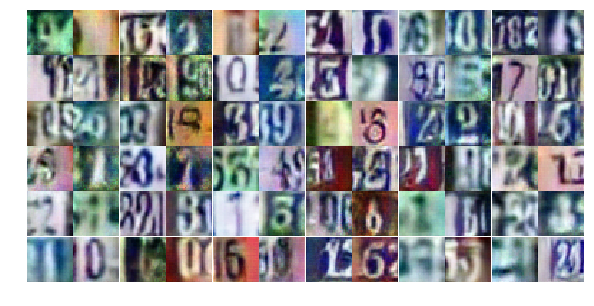

Epoch 17/25... Discriminator Loss: 0.7819... Generator Loss: 1.1356
Epoch 17/25... Discriminator Loss: 1.3692... Generator Loss: 0.3835
Epoch 17/25... Discriminator Loss: 0.4422... Generator Loss: 1.4446
Epoch 17/25... Discriminator Loss: 0.6449... Generator Loss: 1.1279
Epoch 18/25... Discriminator Loss: 1.2557... Generator Loss: 0.4836
Epoch 18/25... Discriminator Loss: 0.9952... Generator Loss: 0.6282
Epoch 18/25... Discriminator Loss: 0.8402... Generator Loss: 0.8112
Epoch 18/25... Discriminator Loss: 0.6878... Generator Loss: 0.9496
Epoch 18/25... Discriminator Loss: 1.1735... Generator Loss: 0.5051
Epoch 18/25... Discriminator Loss: 0.6153... Generator Loss: 1.3892


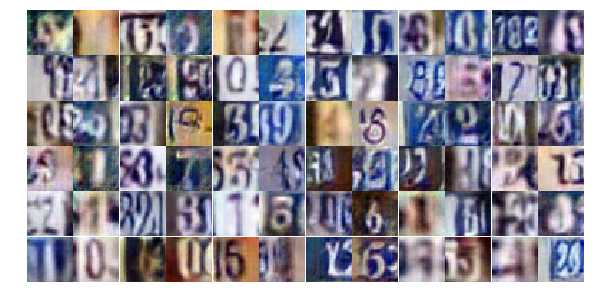

Epoch 18/25... Discriminator Loss: 0.6069... Generator Loss: 1.0845
Epoch 18/25... Discriminator Loss: 0.8252... Generator Loss: 0.8520
Epoch 18/25... Discriminator Loss: 0.8879... Generator Loss: 0.7532
Epoch 18/25... Discriminator Loss: 0.4448... Generator Loss: 1.6576
Epoch 18/25... Discriminator Loss: 0.8742... Generator Loss: 0.7472
Epoch 18/25... Discriminator Loss: 1.2559... Generator Loss: 0.5360
Epoch 18/25... Discriminator Loss: 0.6276... Generator Loss: 1.0205
Epoch 18/25... Discriminator Loss: 1.1353... Generator Loss: 0.5273
Epoch 18/25... Discriminator Loss: 0.9993... Generator Loss: 2.6791
Epoch 18/25... Discriminator Loss: 0.4546... Generator Loss: 1.9256


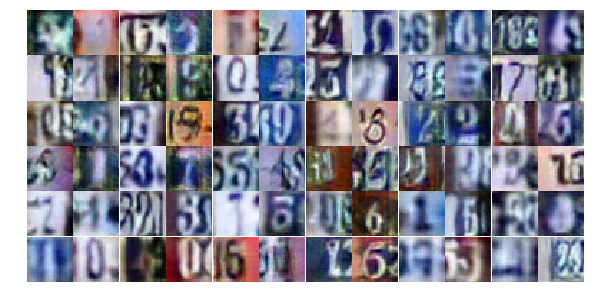

Epoch 18/25... Discriminator Loss: 1.0528... Generator Loss: 1.2568
Epoch 18/25... Discriminator Loss: 0.7804... Generator Loss: 1.0425
Epoch 18/25... Discriminator Loss: 0.8047... Generator Loss: 1.0254
Epoch 18/25... Discriminator Loss: 0.6111... Generator Loss: 1.2586
Epoch 18/25... Discriminator Loss: 0.8194... Generator Loss: 0.7975
Epoch 18/25... Discriminator Loss: 0.9749... Generator Loss: 0.6652
Epoch 18/25... Discriminator Loss: 0.7333... Generator Loss: 1.0265
Epoch 18/25... Discriminator Loss: 0.7713... Generator Loss: 0.8986
Epoch 18/25... Discriminator Loss: 0.8647... Generator Loss: 0.7872
Epoch 18/25... Discriminator Loss: 0.7756... Generator Loss: 0.9355


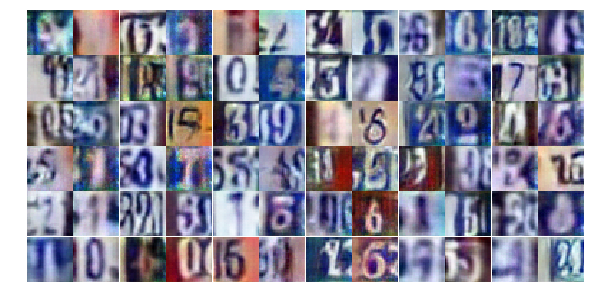

Epoch 18/25... Discriminator Loss: 0.5091... Generator Loss: 1.5114
Epoch 18/25... Discriminator Loss: 0.8888... Generator Loss: 0.8023
Epoch 18/25... Discriminator Loss: 0.6058... Generator Loss: 1.1223
Epoch 18/25... Discriminator Loss: 0.7396... Generator Loss: 0.9559
Epoch 18/25... Discriminator Loss: 1.1281... Generator Loss: 0.6249
Epoch 18/25... Discriminator Loss: 0.5212... Generator Loss: 1.3121
Epoch 18/25... Discriminator Loss: 0.5624... Generator Loss: 1.2647
Epoch 18/25... Discriminator Loss: 0.5703... Generator Loss: 1.2535
Epoch 18/25... Discriminator Loss: 0.5515... Generator Loss: 1.1983
Epoch 18/25... Discriminator Loss: 0.7538... Generator Loss: 0.9051


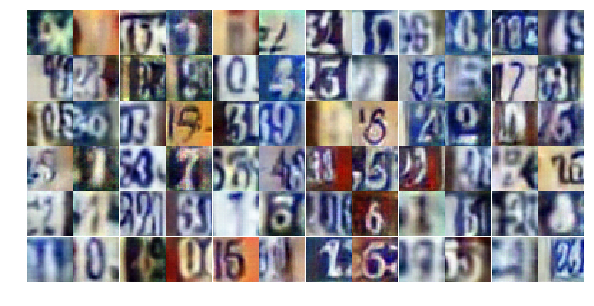

Epoch 18/25... Discriminator Loss: 0.5703... Generator Loss: 1.4048
Epoch 18/25... Discriminator Loss: 0.5149... Generator Loss: 1.3497
Epoch 18/25... Discriminator Loss: 0.7937... Generator Loss: 0.8587
Epoch 18/25... Discriminator Loss: 0.5043... Generator Loss: 1.2914
Epoch 18/25... Discriminator Loss: 0.9751... Generator Loss: 0.7103
Epoch 18/25... Discriminator Loss: 0.4616... Generator Loss: 1.3375
Epoch 18/25... Discriminator Loss: 0.8022... Generator Loss: 0.8456
Epoch 18/25... Discriminator Loss: 1.1883... Generator Loss: 2.6637
Epoch 18/25... Discriminator Loss: 1.6147... Generator Loss: 0.3522
Epoch 18/25... Discriminator Loss: 0.3897... Generator Loss: 2.0047


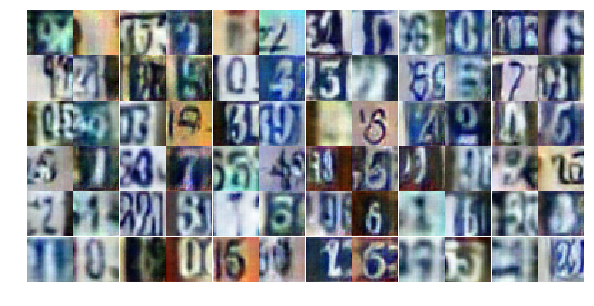

Epoch 18/25... Discriminator Loss: 0.8284... Generator Loss: 0.8322
Epoch 18/25... Discriminator Loss: 0.6447... Generator Loss: 1.3109
Epoch 18/25... Discriminator Loss: 0.8741... Generator Loss: 0.8322
Epoch 18/25... Discriminator Loss: 0.7454... Generator Loss: 0.8946
Epoch 18/25... Discriminator Loss: 0.6650... Generator Loss: 1.0678
Epoch 18/25... Discriminator Loss: 0.8422... Generator Loss: 3.0734
Epoch 18/25... Discriminator Loss: 0.4895... Generator Loss: 1.3254
Epoch 18/25... Discriminator Loss: 0.6219... Generator Loss: 1.1420
Epoch 18/25... Discriminator Loss: 1.0553... Generator Loss: 0.6116
Epoch 18/25... Discriminator Loss: 1.0408... Generator Loss: 0.6502


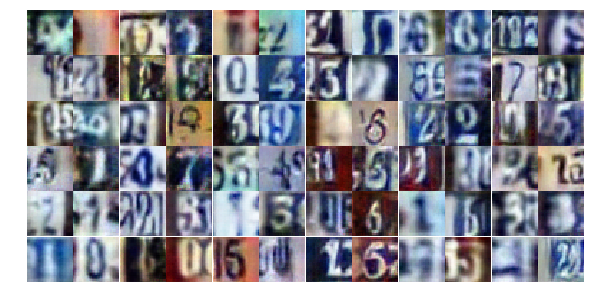

Epoch 18/25... Discriminator Loss: 0.6380... Generator Loss: 2.6045
Epoch 19/25... Discriminator Loss: 1.6453... Generator Loss: 3.2259
Epoch 19/25... Discriminator Loss: 1.2505... Generator Loss: 0.5190
Epoch 19/25... Discriminator Loss: 0.8156... Generator Loss: 0.8385
Epoch 19/25... Discriminator Loss: 0.8113... Generator Loss: 0.8520
Epoch 19/25... Discriminator Loss: 1.0702... Generator Loss: 0.6718
Epoch 19/25... Discriminator Loss: 0.4328... Generator Loss: 1.7646
Epoch 19/25... Discriminator Loss: 1.0488... Generator Loss: 0.6440
Epoch 19/25... Discriminator Loss: 0.7010... Generator Loss: 3.2323
Epoch 19/25... Discriminator Loss: 1.3461... Generator Loss: 0.4221


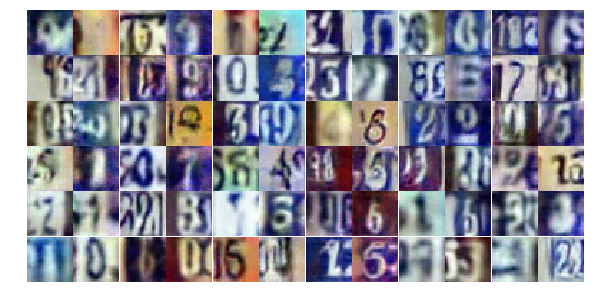

Epoch 19/25... Discriminator Loss: 0.5645... Generator Loss: 1.2067
Epoch 19/25... Discriminator Loss: 1.2372... Generator Loss: 0.5358
Epoch 19/25... Discriminator Loss: 0.7529... Generator Loss: 1.0865
Epoch 19/25... Discriminator Loss: 1.2576... Generator Loss: 0.4480
Epoch 19/25... Discriminator Loss: 0.9212... Generator Loss: 0.7228
Epoch 19/25... Discriminator Loss: 0.7195... Generator Loss: 0.9967
Epoch 19/25... Discriminator Loss: 0.8238... Generator Loss: 0.8019
Epoch 19/25... Discriminator Loss: 0.5320... Generator Loss: 1.2651
Epoch 19/25... Discriminator Loss: 0.6631... Generator Loss: 1.8963
Epoch 19/25... Discriminator Loss: 1.0209... Generator Loss: 0.6504


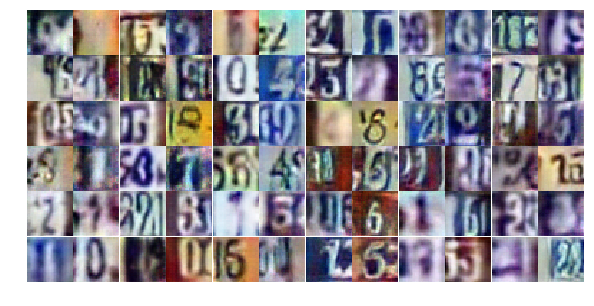

Epoch 19/25... Discriminator Loss: 0.9501... Generator Loss: 0.7051
Epoch 19/25... Discriminator Loss: 1.0501... Generator Loss: 0.6996
Epoch 19/25... Discriminator Loss: 1.4985... Generator Loss: 0.3519
Epoch 19/25... Discriminator Loss: 0.9538... Generator Loss: 0.7727
Epoch 19/25... Discriminator Loss: 0.9682... Generator Loss: 0.6750
Epoch 19/25... Discriminator Loss: 0.7146... Generator Loss: 1.1106
Epoch 19/25... Discriminator Loss: 0.6226... Generator Loss: 1.1508
Epoch 19/25... Discriminator Loss: 0.7802... Generator Loss: 0.9868
Epoch 19/25... Discriminator Loss: 0.7221... Generator Loss: 1.0352
Epoch 19/25... Discriminator Loss: 1.1436... Generator Loss: 0.6187


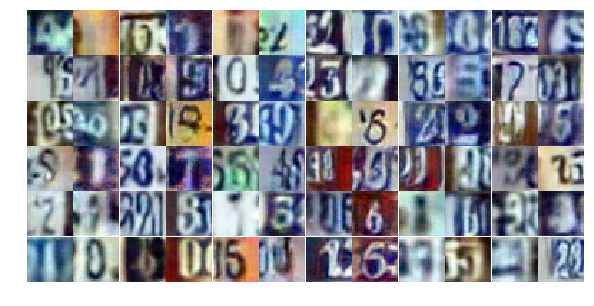

Epoch 19/25... Discriminator Loss: 0.7543... Generator Loss: 0.8873
Epoch 19/25... Discriminator Loss: 0.6721... Generator Loss: 0.9665
Epoch 19/25... Discriminator Loss: 1.1327... Generator Loss: 0.5672
Epoch 19/25... Discriminator Loss: 0.5849... Generator Loss: 1.1488
Epoch 19/25... Discriminator Loss: 0.6861... Generator Loss: 1.0855
Epoch 19/25... Discriminator Loss: 1.1797... Generator Loss: 0.6376
Epoch 19/25... Discriminator Loss: 0.4905... Generator Loss: 1.6058
Epoch 19/25... Discriminator Loss: 0.4370... Generator Loss: 1.6747
Epoch 19/25... Discriminator Loss: 0.7098... Generator Loss: 1.0118
Epoch 19/25... Discriminator Loss: 0.5588... Generator Loss: 1.2848


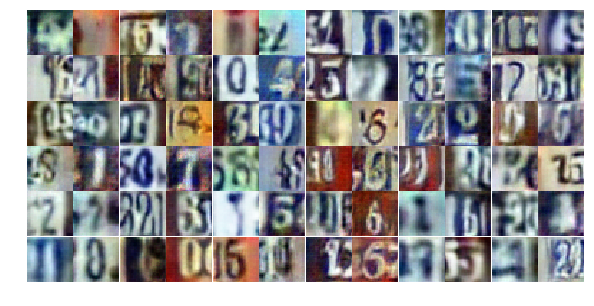

Epoch 19/25... Discriminator Loss: 0.5713... Generator Loss: 1.0754
Epoch 19/25... Discriminator Loss: 1.2619... Generator Loss: 0.5033
Epoch 19/25... Discriminator Loss: 1.4225... Generator Loss: 0.3775
Epoch 19/25... Discriminator Loss: 0.5265... Generator Loss: 1.3062
Epoch 19/25... Discriminator Loss: 0.4663... Generator Loss: 2.0243
Epoch 19/25... Discriminator Loss: 3.5798... Generator Loss: 5.1140
Epoch 19/25... Discriminator Loss: 1.2986... Generator Loss: 2.9087
Epoch 19/25... Discriminator Loss: 0.5622... Generator Loss: 1.3742
Epoch 19/25... Discriminator Loss: 0.5721... Generator Loss: 1.3380
Epoch 19/25... Discriminator Loss: 1.1738... Generator Loss: 0.5501


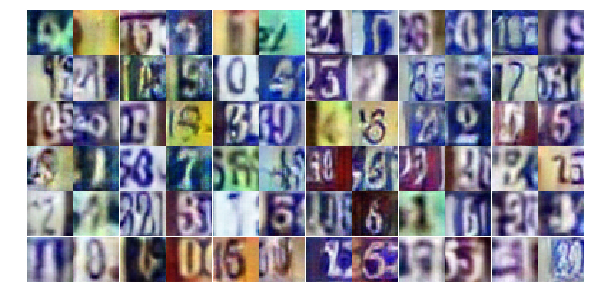

Epoch 19/25... Discriminator Loss: 0.6373... Generator Loss: 1.0728
Epoch 19/25... Discriminator Loss: 0.7367... Generator Loss: 0.9464
Epoch 19/25... Discriminator Loss: 0.7022... Generator Loss: 1.4436
Epoch 19/25... Discriminator Loss: 0.6923... Generator Loss: 1.3822
Epoch 19/25... Discriminator Loss: 0.9734... Generator Loss: 0.6880
Epoch 19/25... Discriminator Loss: 0.7571... Generator Loss: 0.9525
Epoch 19/25... Discriminator Loss: 1.8754... Generator Loss: 0.2536
Epoch 19/25... Discriminator Loss: 0.5272... Generator Loss: 1.4263
Epoch 20/25... Discriminator Loss: 0.6621... Generator Loss: 1.0550
Epoch 20/25... Discriminator Loss: 0.6371... Generator Loss: 1.0412


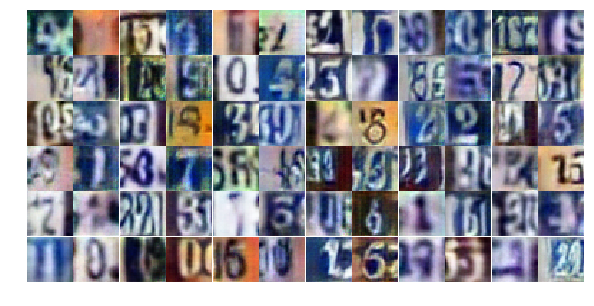

Epoch 20/25... Discriminator Loss: 0.5341... Generator Loss: 1.2307
Epoch 20/25... Discriminator Loss: 0.9636... Generator Loss: 0.7895
Epoch 20/25... Discriminator Loss: 1.7152... Generator Loss: 0.3267
Epoch 20/25... Discriminator Loss: 1.2855... Generator Loss: 0.5240
Epoch 20/25... Discriminator Loss: 0.7268... Generator Loss: 0.9180
Epoch 20/25... Discriminator Loss: 0.4238... Generator Loss: 1.7682
Epoch 20/25... Discriminator Loss: 0.6773... Generator Loss: 1.1347
Epoch 20/25... Discriminator Loss: 0.8662... Generator Loss: 0.9403
Epoch 20/25... Discriminator Loss: 0.8120... Generator Loss: 0.8618
Epoch 20/25... Discriminator Loss: 0.9253... Generator Loss: 0.6955


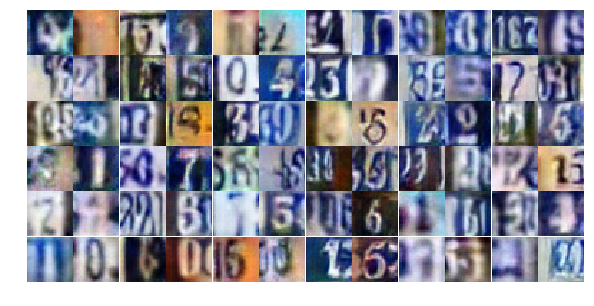

Epoch 20/25... Discriminator Loss: 1.7667... Generator Loss: 0.3180
Epoch 20/25... Discriminator Loss: 0.8847... Generator Loss: 0.7953
Epoch 20/25... Discriminator Loss: 0.6290... Generator Loss: 1.3425
Epoch 20/25... Discriminator Loss: 0.7093... Generator Loss: 1.5802
Epoch 20/25... Discriminator Loss: 1.0314... Generator Loss: 0.6408
Epoch 20/25... Discriminator Loss: 0.8253... Generator Loss: 0.8417
Epoch 20/25... Discriminator Loss: 1.0512... Generator Loss: 0.6164
Epoch 20/25... Discriminator Loss: 0.9248... Generator Loss: 0.7041
Epoch 20/25... Discriminator Loss: 0.5765... Generator Loss: 1.2420
Epoch 20/25... Discriminator Loss: 0.9865... Generator Loss: 0.7228


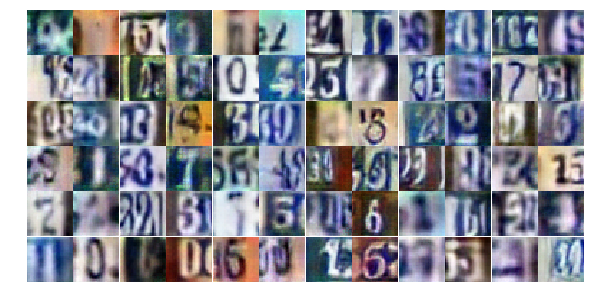

Epoch 20/25... Discriminator Loss: 0.5641... Generator Loss: 1.3141
Epoch 20/25... Discriminator Loss: 1.0529... Generator Loss: 0.6820
Epoch 20/25... Discriminator Loss: 0.3958... Generator Loss: 2.8882
Epoch 20/25... Discriminator Loss: 1.1265... Generator Loss: 0.5755
Epoch 20/25... Discriminator Loss: 0.5794... Generator Loss: 1.2863
Epoch 20/25... Discriminator Loss: 0.6368... Generator Loss: 0.9694
Epoch 20/25... Discriminator Loss: 0.5790... Generator Loss: 1.2910
Epoch 20/25... Discriminator Loss: 1.2232... Generator Loss: 0.5771
Epoch 20/25... Discriminator Loss: 1.2237... Generator Loss: 0.5371
Epoch 20/25... Discriminator Loss: 0.3759... Generator Loss: 1.6446


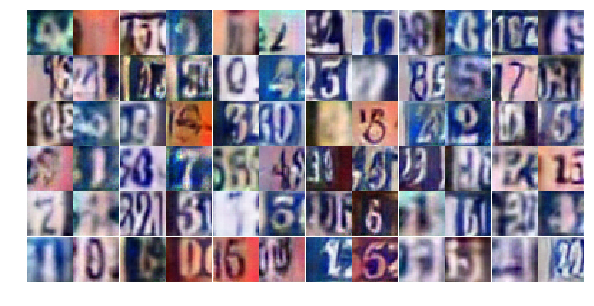

Epoch 20/25... Discriminator Loss: 0.8298... Generator Loss: 0.8643
Epoch 20/25... Discriminator Loss: 0.6376... Generator Loss: 1.1097
Epoch 20/25... Discriminator Loss: 1.4673... Generator Loss: 0.4012
Epoch 20/25... Discriminator Loss: 0.7568... Generator Loss: 1.6023
Epoch 20/25... Discriminator Loss: 1.7675... Generator Loss: 0.2882
Epoch 20/25... Discriminator Loss: 0.7370... Generator Loss: 2.1839
Epoch 20/25... Discriminator Loss: 0.9323... Generator Loss: 1.8621
Epoch 20/25... Discriminator Loss: 0.8647... Generator Loss: 1.0872
Epoch 20/25... Discriminator Loss: 0.8393... Generator Loss: 1.0289
Epoch 20/25... Discriminator Loss: 0.9558... Generator Loss: 0.7427


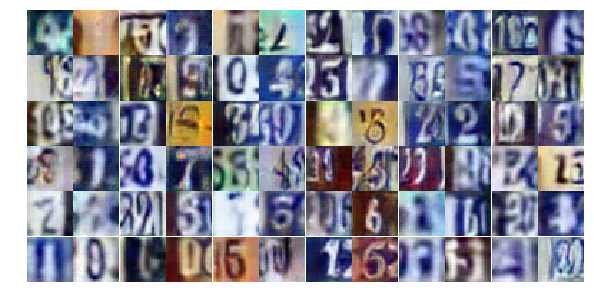

Epoch 20/25... Discriminator Loss: 0.8471... Generator Loss: 0.8927
Epoch 20/25... Discriminator Loss: 0.8563... Generator Loss: 0.7721
Epoch 20/25... Discriminator Loss: 0.5168... Generator Loss: 1.5889
Epoch 20/25... Discriminator Loss: 1.0693... Generator Loss: 0.6527
Epoch 20/25... Discriminator Loss: 0.9303... Generator Loss: 0.7682
Epoch 20/25... Discriminator Loss: 1.4481... Generator Loss: 0.4159
Epoch 20/25... Discriminator Loss: 1.3854... Generator Loss: 0.4291
Epoch 20/25... Discriminator Loss: 0.5346... Generator Loss: 1.4553
Epoch 20/25... Discriminator Loss: 0.6550... Generator Loss: 0.9956
Epoch 20/25... Discriminator Loss: 0.9407... Generator Loss: 0.7222


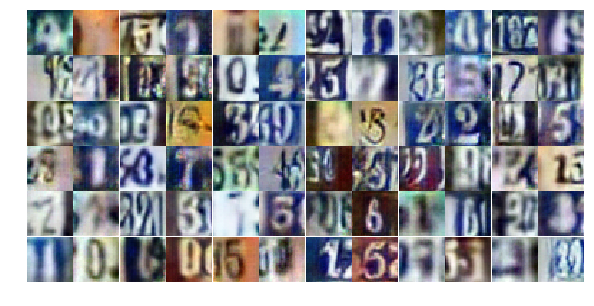

Epoch 20/25... Discriminator Loss: 0.7406... Generator Loss: 3.2137
Epoch 20/25... Discriminator Loss: 0.5177... Generator Loss: 1.7222
Epoch 20/25... Discriminator Loss: 0.6773... Generator Loss: 1.1570
Epoch 20/25... Discriminator Loss: 0.6481... Generator Loss: 1.3362
Epoch 20/25... Discriminator Loss: 0.6810... Generator Loss: 1.0922
Epoch 20/25... Discriminator Loss: 0.4498... Generator Loss: 1.5015
Epoch 21/25... Discriminator Loss: 0.7052... Generator Loss: 1.1064
Epoch 21/25... Discriminator Loss: 0.9833... Generator Loss: 0.6331
Epoch 21/25... Discriminator Loss: 1.5851... Generator Loss: 0.3176
Epoch 21/25... Discriminator Loss: 1.4182... Generator Loss: 0.4197


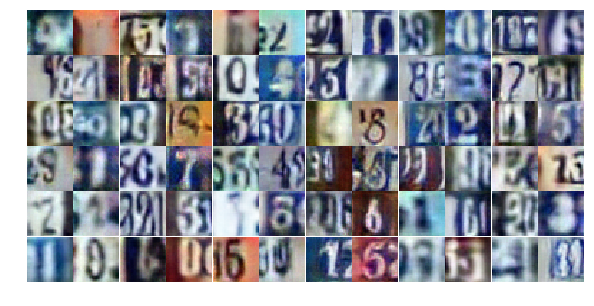

Epoch 21/25... Discriminator Loss: 0.6901... Generator Loss: 1.1939
Epoch 21/25... Discriminator Loss: 1.3093... Generator Loss: 0.4747
Epoch 21/25... Discriminator Loss: 0.6410... Generator Loss: 1.1470
Epoch 21/25... Discriminator Loss: 0.4131... Generator Loss: 1.5248
Epoch 21/25... Discriminator Loss: 0.8808... Generator Loss: 0.7205
Epoch 21/25... Discriminator Loss: 0.4456... Generator Loss: 1.3603
Epoch 21/25... Discriminator Loss: 0.5841... Generator Loss: 1.2110
Epoch 21/25... Discriminator Loss: 0.9713... Generator Loss: 0.7083
Epoch 21/25... Discriminator Loss: 0.5989... Generator Loss: 1.1009
Epoch 21/25... Discriminator Loss: 1.0289... Generator Loss: 0.6757


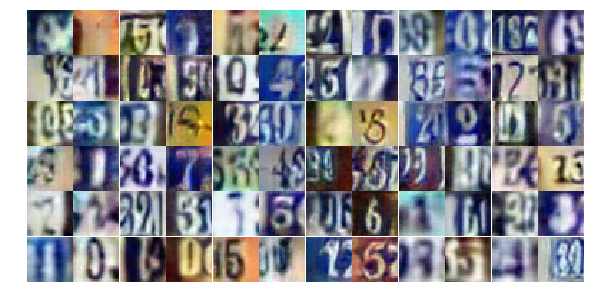

Epoch 21/25... Discriminator Loss: 0.4838... Generator Loss: 1.2577
Epoch 21/25... Discriminator Loss: 0.6925... Generator Loss: 0.9379
Epoch 21/25... Discriminator Loss: 1.5230... Generator Loss: 0.4722
Epoch 21/25... Discriminator Loss: 0.7376... Generator Loss: 1.3706
Epoch 21/25... Discriminator Loss: 0.4517... Generator Loss: 1.6311
Epoch 21/25... Discriminator Loss: 0.9193... Generator Loss: 0.8124
Epoch 21/25... Discriminator Loss: 0.5939... Generator Loss: 1.2957
Epoch 21/25... Discriminator Loss: 0.3857... Generator Loss: 2.1938
Epoch 21/25... Discriminator Loss: 0.5289... Generator Loss: 1.1673
Epoch 21/25... Discriminator Loss: 0.6583... Generator Loss: 1.0257


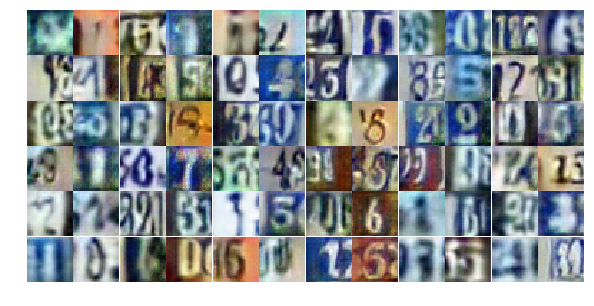

Epoch 21/25... Discriminator Loss: 1.4885... Generator Loss: 0.3686
Epoch 21/25... Discriminator Loss: 0.5027... Generator Loss: 1.3202
Epoch 21/25... Discriminator Loss: 0.7369... Generator Loss: 0.8562
Epoch 21/25... Discriminator Loss: 0.6402... Generator Loss: 1.5152
Epoch 21/25... Discriminator Loss: 0.9742... Generator Loss: 0.7459
Epoch 21/25... Discriminator Loss: 0.8718... Generator Loss: 0.8115
Epoch 21/25... Discriminator Loss: 0.4746... Generator Loss: 1.4681
Epoch 21/25... Discriminator Loss: 1.7481... Generator Loss: 0.2829
Epoch 21/25... Discriminator Loss: 1.3299... Generator Loss: 0.4491
Epoch 21/25... Discriminator Loss: 1.8047... Generator Loss: 0.2779


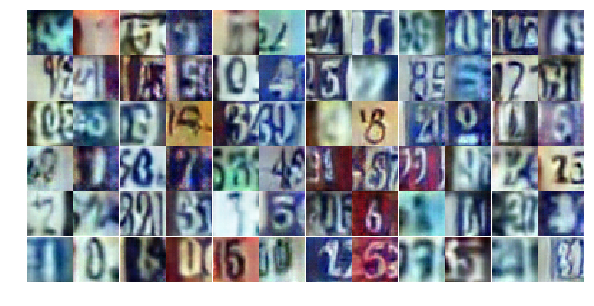

Epoch 21/25... Discriminator Loss: 0.9385... Generator Loss: 0.7343
Epoch 21/25... Discriminator Loss: 0.9692... Generator Loss: 0.6913
Epoch 21/25... Discriminator Loss: 1.2256... Generator Loss: 0.5292
Epoch 21/25... Discriminator Loss: 0.4335... Generator Loss: 1.5449
Epoch 21/25... Discriminator Loss: 0.7579... Generator Loss: 0.9139
Epoch 21/25... Discriminator Loss: 0.8619... Generator Loss: 0.7476
Epoch 21/25... Discriminator Loss: 0.7198... Generator Loss: 1.0156
Epoch 21/25... Discriminator Loss: 2.1108... Generator Loss: 0.2388
Epoch 21/25... Discriminator Loss: 0.9480... Generator Loss: 0.6772
Epoch 21/25... Discriminator Loss: 0.2560... Generator Loss: 2.3008


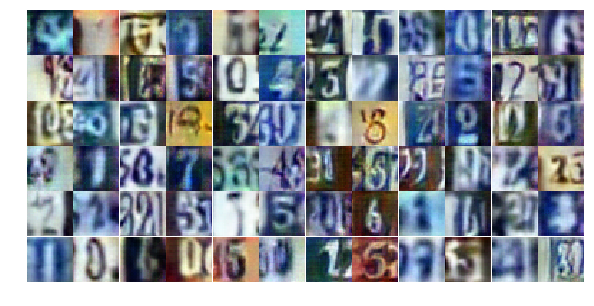

Epoch 21/25... Discriminator Loss: 0.9711... Generator Loss: 0.7802
Epoch 21/25... Discriminator Loss: 1.0856... Generator Loss: 0.6086
Epoch 21/25... Discriminator Loss: 0.4344... Generator Loss: 1.5716
Epoch 21/25... Discriminator Loss: 1.0072... Generator Loss: 0.7146
Epoch 21/25... Discriminator Loss: 0.3465... Generator Loss: 1.6943
Epoch 21/25... Discriminator Loss: 0.8621... Generator Loss: 0.8910
Epoch 21/25... Discriminator Loss: 1.1106... Generator Loss: 0.5411
Epoch 21/25... Discriminator Loss: 0.8653... Generator Loss: 1.3564
Epoch 21/25... Discriminator Loss: 0.8360... Generator Loss: 0.8118
Epoch 21/25... Discriminator Loss: 1.2642... Generator Loss: 0.4488


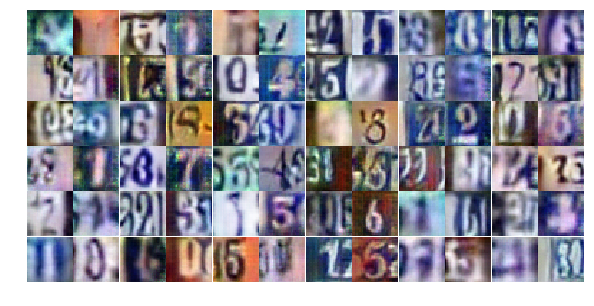

Epoch 21/25... Discriminator Loss: 0.5246... Generator Loss: 1.3353
Epoch 21/25... Discriminator Loss: 0.7050... Generator Loss: 1.8449
Epoch 21/25... Discriminator Loss: 0.7112... Generator Loss: 1.1896
Epoch 22/25... Discriminator Loss: 0.5453... Generator Loss: 1.6201
Epoch 22/25... Discriminator Loss: 1.5237... Generator Loss: 0.3305
Epoch 22/25... Discriminator Loss: 1.2691... Generator Loss: 0.5170
Epoch 22/25... Discriminator Loss: 0.3987... Generator Loss: 1.6935
Epoch 22/25... Discriminator Loss: 0.3197... Generator Loss: 2.0540
Epoch 22/25... Discriminator Loss: 1.6419... Generator Loss: 0.3321
Epoch 22/25... Discriminator Loss: 1.0746... Generator Loss: 0.6359


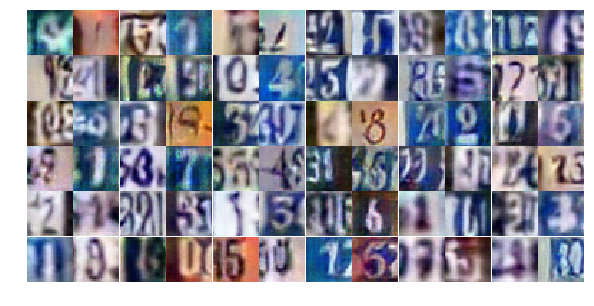

Epoch 22/25... Discriminator Loss: 0.5576... Generator Loss: 1.3908
Epoch 22/25... Discriminator Loss: 0.5640... Generator Loss: 1.7081
Epoch 22/25... Discriminator Loss: 1.0938... Generator Loss: 0.6114
Epoch 22/25... Discriminator Loss: 0.6506... Generator Loss: 1.0715
Epoch 22/25... Discriminator Loss: 0.9025... Generator Loss: 0.8370
Epoch 22/25... Discriminator Loss: 0.8017... Generator Loss: 2.8140
Epoch 22/25... Discriminator Loss: 0.9295... Generator Loss: 0.6915
Epoch 22/25... Discriminator Loss: 0.4187... Generator Loss: 1.8731
Epoch 22/25... Discriminator Loss: 1.2495... Generator Loss: 0.6081
Epoch 22/25... Discriminator Loss: 1.4058... Generator Loss: 0.3942


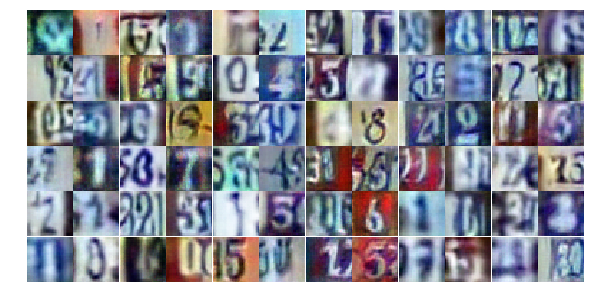

Epoch 22/25... Discriminator Loss: 0.3726... Generator Loss: 1.9619
Epoch 22/25... Discriminator Loss: 0.6663... Generator Loss: 1.0016
Epoch 22/25... Discriminator Loss: 0.7092... Generator Loss: 1.0403
Epoch 22/25... Discriminator Loss: 0.4681... Generator Loss: 1.4171
Epoch 22/25... Discriminator Loss: 0.5624... Generator Loss: 2.8479
Epoch 22/25... Discriminator Loss: 0.7458... Generator Loss: 2.2631
Epoch 22/25... Discriminator Loss: 0.5955... Generator Loss: 1.5150
Epoch 22/25... Discriminator Loss: 0.5114... Generator Loss: 1.7956
Epoch 22/25... Discriminator Loss: 0.5559... Generator Loss: 1.6788
Epoch 22/25... Discriminator Loss: 1.1026... Generator Loss: 0.6729


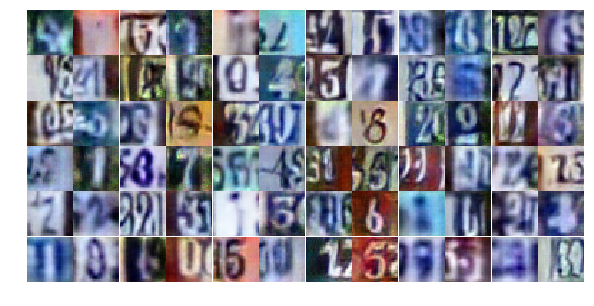

Epoch 22/25... Discriminator Loss: 0.4043... Generator Loss: 1.6250
Epoch 22/25... Discriminator Loss: 0.5541... Generator Loss: 1.7820
Epoch 22/25... Discriminator Loss: 0.7822... Generator Loss: 0.8570
Epoch 22/25... Discriminator Loss: 1.4689... Generator Loss: 0.3816
Epoch 22/25... Discriminator Loss: 1.2001... Generator Loss: 0.5262
Epoch 22/25... Discriminator Loss: 0.7438... Generator Loss: 1.0191
Epoch 22/25... Discriminator Loss: 1.7245... Generator Loss: 0.3185
Epoch 22/25... Discriminator Loss: 0.5404... Generator Loss: 1.4194
Epoch 22/25... Discriminator Loss: 1.3326... Generator Loss: 0.5389
Epoch 22/25... Discriminator Loss: 0.9237... Generator Loss: 0.8374


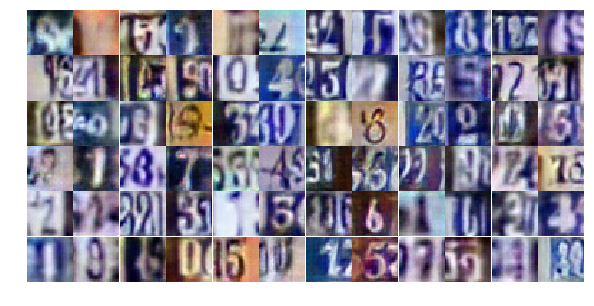

Epoch 22/25... Discriminator Loss: 0.7306... Generator Loss: 1.1254
Epoch 22/25... Discriminator Loss: 0.5473... Generator Loss: 1.2516
Epoch 22/25... Discriminator Loss: 0.3579... Generator Loss: 1.7123
Epoch 22/25... Discriminator Loss: 0.5874... Generator Loss: 1.2864
Epoch 22/25... Discriminator Loss: 0.6743... Generator Loss: 0.9562
Epoch 22/25... Discriminator Loss: 0.7326... Generator Loss: 0.8844
Epoch 22/25... Discriminator Loss: 0.5232... Generator Loss: 1.4056
Epoch 22/25... Discriminator Loss: 0.6708... Generator Loss: 1.5402
Epoch 22/25... Discriminator Loss: 1.6545... Generator Loss: 0.3952
Epoch 22/25... Discriminator Loss: 8.2749... Generator Loss: 9.3574


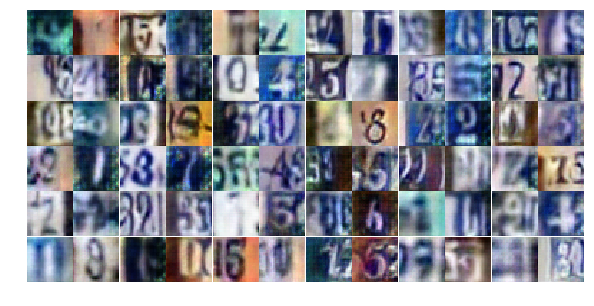

Epoch 22/25... Discriminator Loss: 1.8093... Generator Loss: 2.4072
Epoch 22/25... Discriminator Loss: 1.1747... Generator Loss: 1.6681
Epoch 22/25... Discriminator Loss: 1.0724... Generator Loss: 2.6527
Epoch 22/25... Discriminator Loss: 0.9825... Generator Loss: 0.8205
Epoch 22/25... Discriminator Loss: 0.9986... Generator Loss: 0.7198
Epoch 22/25... Discriminator Loss: 0.9667... Generator Loss: 0.8818
Epoch 22/25... Discriminator Loss: 0.9603... Generator Loss: 0.7450
Epoch 22/25... Discriminator Loss: 0.6563... Generator Loss: 1.1485
Epoch 22/25... Discriminator Loss: 0.7967... Generator Loss: 1.7783
Epoch 22/25... Discriminator Loss: 1.0556... Generator Loss: 0.7433


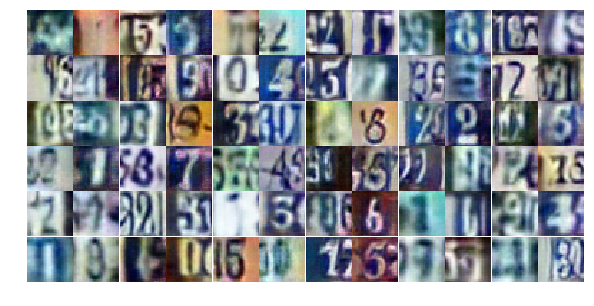

Epoch 23/25... Discriminator Loss: 0.6780... Generator Loss: 1.1221
Epoch 23/25... Discriminator Loss: 0.4373... Generator Loss: 1.4174
Epoch 23/25... Discriminator Loss: 0.8064... Generator Loss: 0.9308
Epoch 23/25... Discriminator Loss: 0.7554... Generator Loss: 0.9445
Epoch 23/25... Discriminator Loss: 0.8449... Generator Loss: 0.8512
Epoch 23/25... Discriminator Loss: 1.4007... Generator Loss: 0.4126
Epoch 23/25... Discriminator Loss: 0.9763... Generator Loss: 0.7193
Epoch 23/25... Discriminator Loss: 0.5434... Generator Loss: 1.2764
Epoch 23/25... Discriminator Loss: 0.5877... Generator Loss: 1.3069
Epoch 23/25... Discriminator Loss: 0.5434... Generator Loss: 1.2381


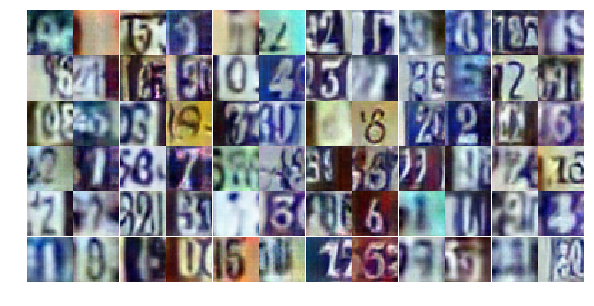

Epoch 23/25... Discriminator Loss: 0.8237... Generator Loss: 0.8660
Epoch 23/25... Discriminator Loss: 0.7499... Generator Loss: 0.8726
Epoch 23/25... Discriminator Loss: 0.9366... Generator Loss: 0.7595
Epoch 23/25... Discriminator Loss: 0.6553... Generator Loss: 1.0914
Epoch 23/25... Discriminator Loss: 0.4389... Generator Loss: 1.4487
Epoch 23/25... Discriminator Loss: 0.7675... Generator Loss: 0.9566
Epoch 23/25... Discriminator Loss: 0.7595... Generator Loss: 1.1669
Epoch 23/25... Discriminator Loss: 0.8282... Generator Loss: 0.8273
Epoch 23/25... Discriminator Loss: 1.1524... Generator Loss: 0.5353
Epoch 23/25... Discriminator Loss: 1.2355... Generator Loss: 0.4940


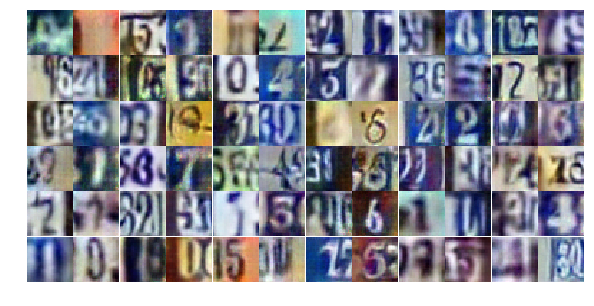

Epoch 23/25... Discriminator Loss: 1.1144... Generator Loss: 0.5798
Epoch 23/25... Discriminator Loss: 0.4662... Generator Loss: 1.5241
Epoch 23/25... Discriminator Loss: 0.9320... Generator Loss: 0.7799
Epoch 23/25... Discriminator Loss: 0.7400... Generator Loss: 0.8997
Epoch 23/25... Discriminator Loss: 0.7551... Generator Loss: 0.9698
Epoch 23/25... Discriminator Loss: 0.8487... Generator Loss: 0.8399
Epoch 23/25... Discriminator Loss: 0.4831... Generator Loss: 1.3344
Epoch 23/25... Discriminator Loss: 0.7726... Generator Loss: 0.8861
Epoch 23/25... Discriminator Loss: 0.8194... Generator Loss: 1.0129
Epoch 23/25... Discriminator Loss: 1.1460... Generator Loss: 1.7130


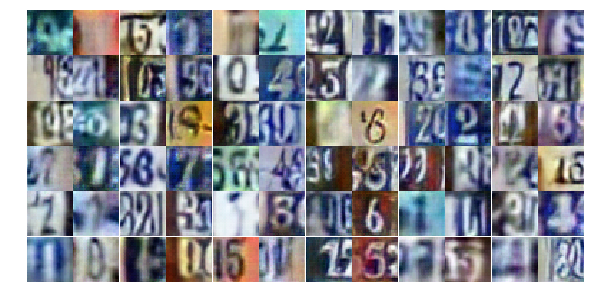

Epoch 23/25... Discriminator Loss: 0.6399... Generator Loss: 1.1764
Epoch 23/25... Discriminator Loss: 0.4772... Generator Loss: 1.4872
Epoch 23/25... Discriminator Loss: 0.5435... Generator Loss: 1.4848
Epoch 23/25... Discriminator Loss: 1.3854... Generator Loss: 0.5096
Epoch 23/25... Discriminator Loss: 1.0318... Generator Loss: 0.6509
Epoch 23/25... Discriminator Loss: 0.8791... Generator Loss: 0.7538
Epoch 23/25... Discriminator Loss: 1.5991... Generator Loss: 0.5191
Epoch 23/25... Discriminator Loss: 0.9194... Generator Loss: 0.8172
Epoch 23/25... Discriminator Loss: 0.4167... Generator Loss: 1.4946
Epoch 23/25... Discriminator Loss: 0.5379... Generator Loss: 1.1218


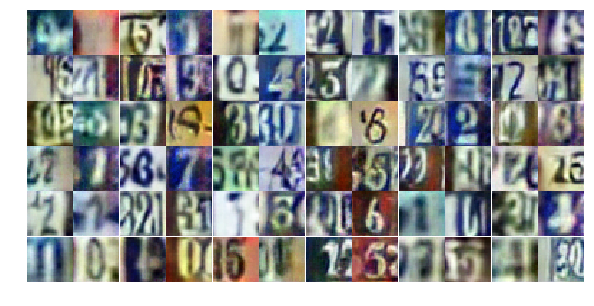

Epoch 23/25... Discriminator Loss: 0.6557... Generator Loss: 1.2284
Epoch 23/25... Discriminator Loss: 0.4645... Generator Loss: 1.6631
Epoch 23/25... Discriminator Loss: 1.3112... Generator Loss: 0.4422
Epoch 23/25... Discriminator Loss: 0.9741... Generator Loss: 0.7520
Epoch 23/25... Discriminator Loss: 1.1362... Generator Loss: 0.7285
Epoch 23/25... Discriminator Loss: 1.0848... Generator Loss: 0.5773
Epoch 23/25... Discriminator Loss: 0.5620... Generator Loss: 1.2075
Epoch 23/25... Discriminator Loss: 1.2502... Generator Loss: 0.5178
Epoch 23/25... Discriminator Loss: 0.6763... Generator Loss: 1.0931
Epoch 23/25... Discriminator Loss: 0.6448... Generator Loss: 1.1253


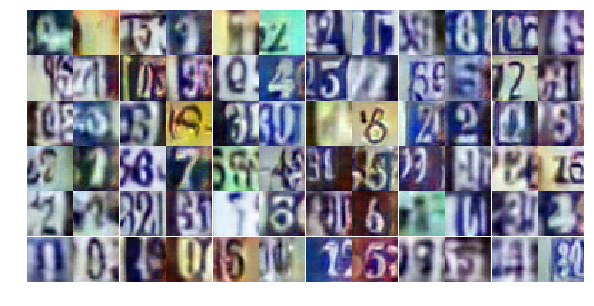

Epoch 23/25... Discriminator Loss: 0.7515... Generator Loss: 0.9283
Epoch 23/25... Discriminator Loss: 1.3695... Generator Loss: 0.4944
Epoch 23/25... Discriminator Loss: 1.5413... Generator Loss: 0.4186
Epoch 23/25... Discriminator Loss: 0.4914... Generator Loss: 1.3117
Epoch 23/25... Discriminator Loss: 1.2387... Generator Loss: 0.4881
Epoch 23/25... Discriminator Loss: 0.5107... Generator Loss: 1.4307
Epoch 23/25... Discriminator Loss: 1.1956... Generator Loss: 0.5240
Epoch 24/25... Discriminator Loss: 1.2718... Generator Loss: 0.4830
Epoch 24/25... Discriminator Loss: 0.9660... Generator Loss: 2.8717
Epoch 24/25... Discriminator Loss: 1.0386... Generator Loss: 0.7032


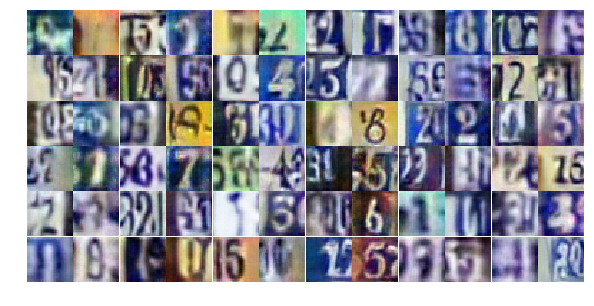

Epoch 24/25... Discriminator Loss: 0.7821... Generator Loss: 0.9306
Epoch 24/25... Discriminator Loss: 0.5700... Generator Loss: 2.2516
Epoch 24/25... Discriminator Loss: 0.5824... Generator Loss: 1.2023
Epoch 24/25... Discriminator Loss: 0.6138... Generator Loss: 1.5380
Epoch 24/25... Discriminator Loss: 0.8672... Generator Loss: 0.7573
Epoch 24/25... Discriminator Loss: 0.5450... Generator Loss: 1.3639
Epoch 24/25... Discriminator Loss: 0.5620... Generator Loss: 1.6318
Epoch 24/25... Discriminator Loss: 1.3489... Generator Loss: 0.4305
Epoch 24/25... Discriminator Loss: 0.4369... Generator Loss: 1.3341
Epoch 24/25... Discriminator Loss: 0.4429... Generator Loss: 1.8140


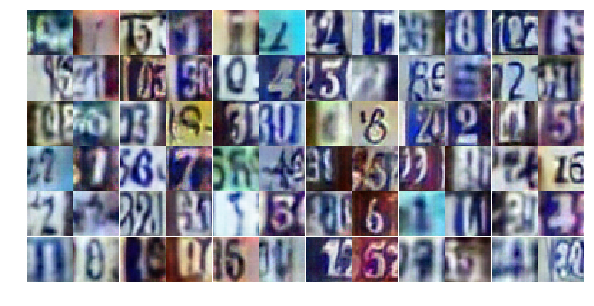

Epoch 24/25... Discriminator Loss: 1.4353... Generator Loss: 0.3559
Epoch 24/25... Discriminator Loss: 1.0982... Generator Loss: 0.5356
Epoch 24/25... Discriminator Loss: 1.0231... Generator Loss: 0.6383
Epoch 24/25... Discriminator Loss: 0.5476... Generator Loss: 1.2118
Epoch 24/25... Discriminator Loss: 1.0117... Generator Loss: 4.0899
Epoch 24/25... Discriminator Loss: 0.6733... Generator Loss: 1.3058
Epoch 24/25... Discriminator Loss: 0.7091... Generator Loss: 1.0841
Epoch 24/25... Discriminator Loss: 1.2454... Generator Loss: 0.4942
Epoch 24/25... Discriminator Loss: 0.7347... Generator Loss: 1.0311
Epoch 24/25... Discriminator Loss: 0.8136... Generator Loss: 0.8333


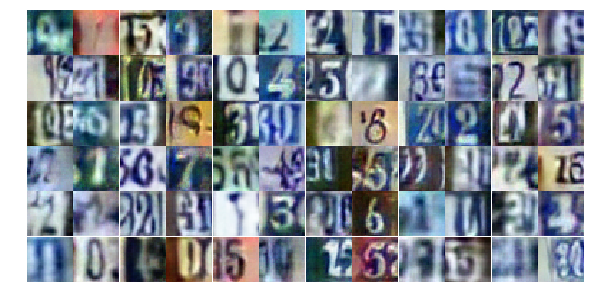

Epoch 24/25... Discriminator Loss: 0.7600... Generator Loss: 0.9084
Epoch 24/25... Discriminator Loss: 0.5837... Generator Loss: 1.3469
Epoch 24/25... Discriminator Loss: 1.0946... Generator Loss: 3.9372
Epoch 24/25... Discriminator Loss: 1.3420... Generator Loss: 0.5103
Epoch 24/25... Discriminator Loss: 0.8011... Generator Loss: 0.8250
Epoch 24/25... Discriminator Loss: 0.7392... Generator Loss: 0.8390
Epoch 24/25... Discriminator Loss: 0.4976... Generator Loss: 1.2884
Epoch 24/25... Discriminator Loss: 0.4964... Generator Loss: 1.6991
Epoch 24/25... Discriminator Loss: 0.6904... Generator Loss: 1.0387
Epoch 24/25... Discriminator Loss: 0.6873... Generator Loss: 1.2891


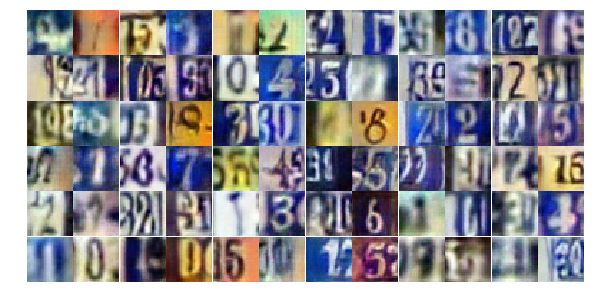

Epoch 24/25... Discriminator Loss: 0.6444... Generator Loss: 1.0158
Epoch 24/25... Discriminator Loss: 0.7243... Generator Loss: 1.0157
Epoch 24/25... Discriminator Loss: 1.3318... Generator Loss: 0.5227
Epoch 24/25... Discriminator Loss: 1.6200... Generator Loss: 0.3813
Epoch 24/25... Discriminator Loss: 0.9753... Generator Loss: 0.7419
Epoch 24/25... Discriminator Loss: 0.8990... Generator Loss: 0.7368
Epoch 24/25... Discriminator Loss: 1.1033... Generator Loss: 0.6011
Epoch 24/25... Discriminator Loss: 0.7232... Generator Loss: 0.8988
Epoch 24/25... Discriminator Loss: 0.5354... Generator Loss: 1.4170
Epoch 24/25... Discriminator Loss: 0.8866... Generator Loss: 0.7417


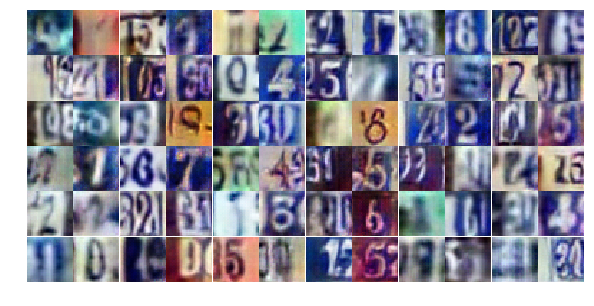

Epoch 24/25... Discriminator Loss: 1.1928... Generator Loss: 0.5220
Epoch 24/25... Discriminator Loss: 1.1680... Generator Loss: 0.6125
Epoch 24/25... Discriminator Loss: 1.0205... Generator Loss: 0.6693
Epoch 24/25... Discriminator Loss: 2.5046... Generator Loss: 4.0699
Epoch 24/25... Discriminator Loss: 1.6137... Generator Loss: 1.0848
Epoch 24/25... Discriminator Loss: 0.6947... Generator Loss: 1.0967
Epoch 24/25... Discriminator Loss: 1.5591... Generator Loss: 0.4266
Epoch 24/25... Discriminator Loss: 0.9452... Generator Loss: 0.7408
Epoch 24/25... Discriminator Loss: 1.0916... Generator Loss: 0.6170
Epoch 24/25... Discriminator Loss: 1.1197... Generator Loss: 0.6430


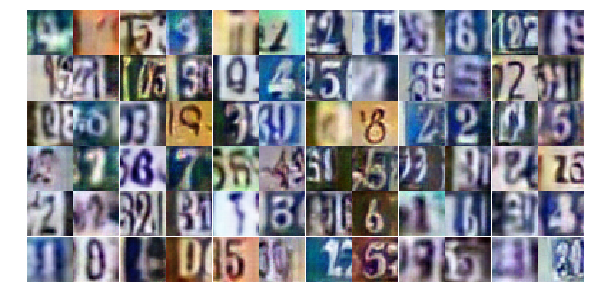

Epoch 24/25... Discriminator Loss: 0.8793... Generator Loss: 0.7838
Epoch 24/25... Discriminator Loss: 0.8777... Generator Loss: 0.8449
Epoch 24/25... Discriminator Loss: 1.0911... Generator Loss: 0.5849
Epoch 24/25... Discriminator Loss: 0.6460... Generator Loss: 1.7765
Epoch 24/25... Discriminator Loss: 1.2708... Generator Loss: 0.4450
Epoch 25/25... Discriminator Loss: 0.4938... Generator Loss: 1.4334
Epoch 25/25... Discriminator Loss: 0.5068... Generator Loss: 1.5433
Epoch 25/25... Discriminator Loss: 0.8371... Generator Loss: 0.8112
Epoch 25/25... Discriminator Loss: 0.7577... Generator Loss: 0.9559
Epoch 25/25... Discriminator Loss: 0.7553... Generator Loss: 0.8993


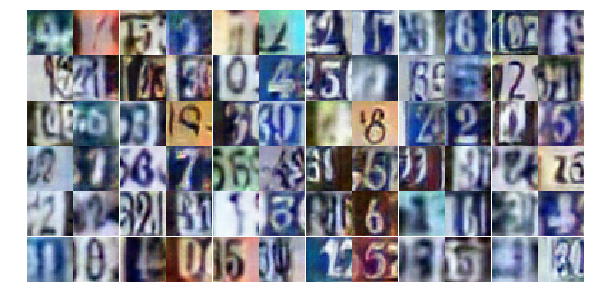

Epoch 25/25... Discriminator Loss: 1.2712... Generator Loss: 0.5305
Epoch 25/25... Discriminator Loss: 0.6878... Generator Loss: 1.2656
Epoch 25/25... Discriminator Loss: 0.9453... Generator Loss: 0.6721
Epoch 25/25... Discriminator Loss: 0.8572... Generator Loss: 0.7602
Epoch 25/25... Discriminator Loss: 0.6717... Generator Loss: 1.6394
Epoch 25/25... Discriminator Loss: 0.8501... Generator Loss: 0.8586
Epoch 25/25... Discriminator Loss: 0.6266... Generator Loss: 1.5245
Epoch 25/25... Discriminator Loss: 0.6872... Generator Loss: 1.2470
Epoch 25/25... Discriminator Loss: 0.4660... Generator Loss: 1.4804
Epoch 25/25... Discriminator Loss: 0.5224... Generator Loss: 1.3056


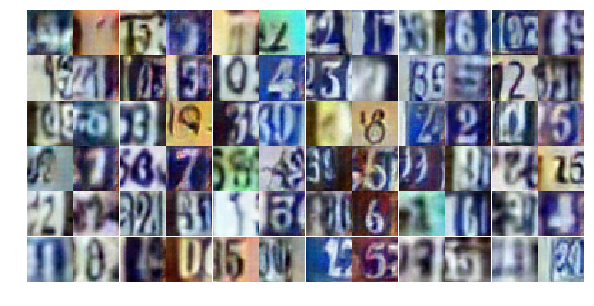

Epoch 25/25... Discriminator Loss: 0.5843... Generator Loss: 1.2966
Epoch 25/25... Discriminator Loss: 0.6526... Generator Loss: 2.6896
Epoch 25/25... Discriminator Loss: 1.7133... Generator Loss: 0.4732
Epoch 25/25... Discriminator Loss: 1.1474... Generator Loss: 0.5874
Epoch 25/25... Discriminator Loss: 0.8842... Generator Loss: 0.9196
Epoch 25/25... Discriminator Loss: 0.6313... Generator Loss: 1.1916
Epoch 25/25... Discriminator Loss: 0.8794... Generator Loss: 0.8138
Epoch 25/25... Discriminator Loss: 1.0738... Generator Loss: 0.6492
Epoch 25/25... Discriminator Loss: 0.5691... Generator Loss: 1.2485
Epoch 25/25... Discriminator Loss: 0.6334... Generator Loss: 1.2007


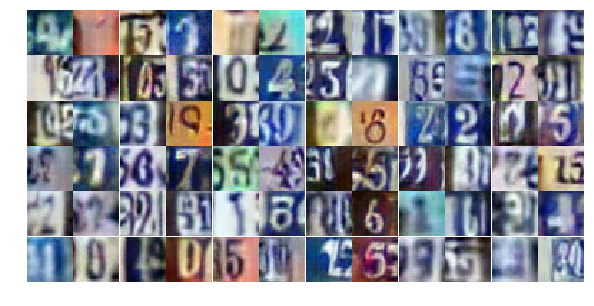

Epoch 25/25... Discriminator Loss: 1.7129... Generator Loss: 0.3246
Epoch 25/25... Discriminator Loss: 0.5445... Generator Loss: 1.4032
Epoch 25/25... Discriminator Loss: 0.9389... Generator Loss: 0.7326
Epoch 25/25... Discriminator Loss: 0.6056... Generator Loss: 1.1980
Epoch 25/25... Discriminator Loss: 0.6679... Generator Loss: 1.1170
Epoch 25/25... Discriminator Loss: 0.6787... Generator Loss: 1.0262
Epoch 25/25... Discriminator Loss: 0.9904... Generator Loss: 0.7485
Epoch 25/25... Discriminator Loss: 0.6785... Generator Loss: 1.0465
Epoch 25/25... Discriminator Loss: 1.0428... Generator Loss: 0.6687
Epoch 25/25... Discriminator Loss: 0.3384... Generator Loss: 2.0765


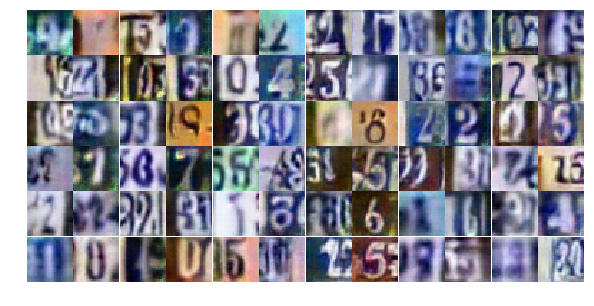

Epoch 25/25... Discriminator Loss: 1.0706... Generator Loss: 0.7043
Epoch 25/25... Discriminator Loss: 0.7547... Generator Loss: 0.9057
Epoch 25/25... Discriminator Loss: 1.0705... Generator Loss: 0.6104
Epoch 25/25... Discriminator Loss: 0.7967... Generator Loss: 0.8369
Epoch 25/25... Discriminator Loss: 1.1287... Generator Loss: 0.6371
Epoch 25/25... Discriminator Loss: 0.9494... Generator Loss: 0.7160
Epoch 25/25... Discriminator Loss: 0.6527... Generator Loss: 1.0635
Epoch 25/25... Discriminator Loss: 0.6551... Generator Loss: 1.1201
Epoch 25/25... Discriminator Loss: 2.8376... Generator Loss: 0.1641
Epoch 25/25... Discriminator Loss: 0.8473... Generator Loss: 0.8411


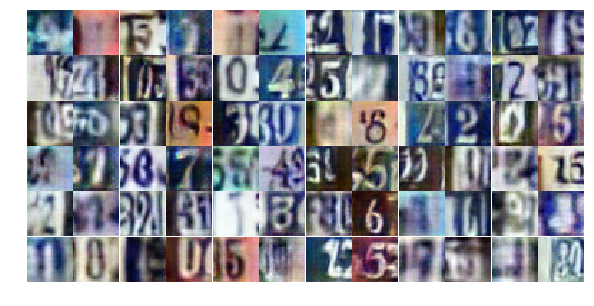

Epoch 25/25... Discriminator Loss: 0.9338... Generator Loss: 0.9462
Epoch 25/25... Discriminator Loss: 0.8087... Generator Loss: 2.5422
Epoch 25/25... Discriminator Loss: 0.7885... Generator Loss: 1.2059
Epoch 25/25... Discriminator Loss: 1.1727... Generator Loss: 0.5086
Epoch 25/25... Discriminator Loss: 0.8254... Generator Loss: 0.8688
Epoch 25/25... Discriminator Loss: 0.5048... Generator Loss: 1.3019
Epoch 25/25... Discriminator Loss: 0.9038... Generator Loss: 0.8428
Epoch 25/25... Discriminator Loss: 0.5028... Generator Loss: 1.4260
Epoch 25/25... Discriminator Loss: 0.7070... Generator Loss: 1.0143
Epoch 25/25... Discriminator Loss: 0.5822... Generator Loss: 1.2390


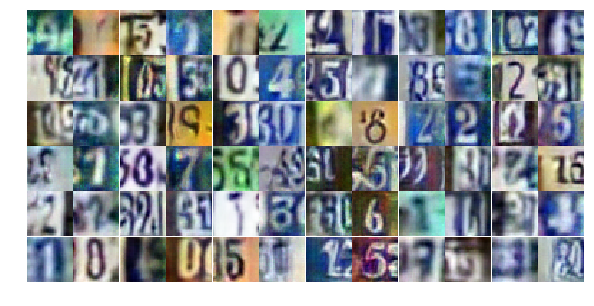

Epoch 25/25... Discriminator Loss: 0.5050... Generator Loss: 1.5757
Epoch 25/25... Discriminator Loss: 1.4564... Generator Loss: 0.4439


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

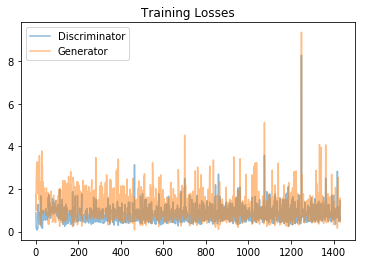

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

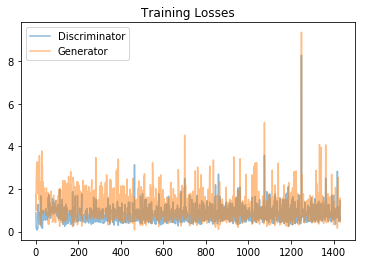

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

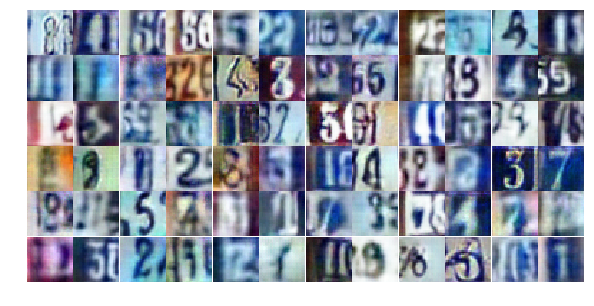

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))